In [1]:
import os, h5py
import numpy as np
import pandas as pd
import logomaker
import matplotlib.pyplot as plt
%matplotlib inline
import shap
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
from tensorflow import keras
from tensorflow.keras import backend as K
import tensorflow.compat.v1.keras.backend as K1

In [2]:
def plot_filers(model, x_test, layer=3, threshold=0.5, window=20, num_cols=8, figsize=(30,5)):

    intermediate = keras.Model(inputs=model.inputs, outputs=model.layers[layer].output)
    fmap = intermediate.predict(x_test)
    W, support = activation_pwm(fmap, x_test, threshold=threshold, window=window)

    num_filters = len(W)
    num_widths = int(np.ceil(num_filters/num_cols))

    fig = plt.figure(figsize=figsize)
    fig.subplots_adjust(hspace=0.1, wspace=0.1)

    logos = []
    for n, w in enumerate(W):
        ax = fig.add_subplot(num_widths, num_cols, n+1)
        #if (np.sum(w) != 0) | (np.sum(np.isnan(w) == True) > 0):
        
        # calculate sequence logo heights
        I = np.log2(4) + np.sum(w * np.log2(w+1e-7), axis=1, keepdims=True)
        logo = I*w

        L, A = w.shape
        counts_df = pd.DataFrame(data=0.0, columns=list('ACGT'), index=list(range(L)))
        for a in range(A):
            for l in range(L):
                counts_df.iloc[l,a] = logo[l,a]

        logomaker.Logo(counts_df, ax=ax)
        ax = plt.gca()
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.yaxis.set_ticks_position('none')
        ax.xaxis.set_ticks_position('none')
        plt.xticks([])
        plt.yticks([])
        
        logos.append(logo)
        
    return fig, W, logo


def activation_pwm(fmap, X, threshold=0.5, window=20):

    # extract sequences with aligned activation
    window_left = int(window/2)
    window_right = window - window_left

    N,seq_length,num_dims = X.shape
    num_filters = fmap.shape[-1]

    support = []
    W = []
    for filter_index in range(num_filters):

        # find regions above threshold
        try:
            coords = np.where(fmap[:,:,filter_index] > np.max(fmap[:,:,filter_index])*threshold)
            x, y = coords

            # sort score
            index = np.argsort(fmap[x,y,filter_index])[::-1]
            data_index = x[index].astype(int)
            pos_index = y[index].astype(int)

            support.append(len(pos_index))

            seq_align = []
            count_matrix = []
            for i in range(len(pos_index)):

                # handle boundary conditions at start
                start_window = pos_index[i] - window_left
                if start_window < 0:
                    start_buffer = np.zeros((-start_window, num_dims))
                    start = 0
                else:
                    start = start_window

                # handle boundary conditions at end 
                end_window = pos_index[i] + window_right
                end_remainder = end_window - seq_length
                if end_remainder > 0:
                    end = seq_length
                    end_buffer = np.zeros((end_remainder, num_dims))
                else:
                    end = end_window

                seq = X[data_index[i],start:end,:]

                if start_window < 0:
                    seq = np.vstack([start_buffer, seq])
                if end_remainder > 0:
                    seq = np.vstack([seq, end_buffer])

                seq_align.append(seq)
                #weight = fmap[data_index[i],pos_index[i],filter_index]
                #seq_align.append(seq*weight)
                #count_matrix.append(np.sum(seq, axis=1, keepdims=True)*weight)

            #seq_align = np.array(seq_align)
            #count_matrix = np.array(count_matrix)

            # normalize counts
            #seq_align = np.sum(seq_align, axis=0)/np.sum(count_matrix, axis=0)*np.ones((window,4))
            #seq_align[np.isnan(seq_align)] = 0
            #seq_align[seq_align < 0] = 0
                
            seq_align = np.array(seq_align)
            W.append(np.mean(seq_align, axis=0))
        except:
            W.append(np.ones((window,4))/4)
    W = np.array(W)

    return W, support


def saliency(model, X, class_index=0, layer=-2, batch_size=256):
    saliency = K1.gradients(model.layers[layer].output[:,class_index], model.input)[0]
    sess = K1.get_session()

    N = len(X)
    num_batches = int(np.floor(N/batch_size))

    attr_score = []
    for i in range(num_batches):
        attr_score.append(sess.run(saliency, {model.inputs[0]: X[i*batch_size:(i+1)*batch_size]}))
    if num_batches*batch_size < N:
        attr_score.append(sess.run(saliency, {model.inputs[0]: X[num_batches*batch_size:N]}))

    return np.concatenate(attr_score, axis=0)


def mutagenesis(model, X, class_index=0, layer=-2):

    def generate_mutagenesis(X):
        L,A = X.shape 

        X_mut = []
        for l in range(L):
            for a in range(A):
                X_new = np.copy(X)
                X_new[l,:] = 0
                X_new[l,a] = 1
                X_mut.append(X_new)
        return np.array(X_mut)

    N, L, A = X.shape 
    intermediate = keras.Model(inputs=model.inputs, outputs=model.layers[layer].output)

    attr_score = []
    for x in X:

        # get baseline wildtype score
        wt_score = intermediate.predict(np.expand_dims(x, axis=0))[:, class_index]

        # generate mutagenized sequences
        x_mut = generate_mutagenesis(x)
        
        # get predictions of mutagenized sequences
        predictions = intermediate.predict(x_mut)[:,class_index]

        # reshape mutagenesis predictiosn
        mut_score = np.zeros((L,A))
        k = 0
        for l in range(L):
            for a in range(A):
                mut_score[l,a] = predictions[k]
                k += 1
                
        attr_score.append(mut_score - wt_score)
    return np.array(attr_score)


def deepshap(model, X, class_index=0, num_background=25, reference='shuffle'):

    N, L, A = X.shape 
    if reference is not 'shuffle':
        num_background = 1
        
    # set of background sequences to take expectation over
    shap_values = []
    for j, x in enumerate(X):
        if np.mod(j, 50) == 0:
            print("%d out of %d"%(j,N))
        if reference == 'shuffle':
            background = []
            for i in range(num_background):
                shuffle = np.random.permutation(L)
                background.append(x[shuffle, :])
            background = np.array(background)
        else: 
            background = np.zeros([1,L,A])     

        x = np.expand_dims(x, axis=0)
        # calculate SHAPLEY values 
        background.shape
        e = shap.DeepExplainer(model, background)
        shap_values.append(e.shap_values(x)[0])

    attr_score = np.concatenate(shap_values, axis=0)
    return attr_score


def clip_filters(W, threshold=0.5, pad=3):

    W_clipped = []
    for w in W:
        L,A = w.shape
        entropy = np.log2(4) + np.sum(w*np.log2(w+1e-7), axis=1)
        index = np.where(entropy > threshold)[0]
        if index.any():
            start = np.maximum(np.min(index)-pad, 0)
            end = np.minimum(np.max(index)+pad+1, L)
            W_clipped.append(w[start:end,:])
        else:
            W_clipped.append(w)

    return W_clipped



def meme_generate(W, output_file='meme.txt', prefix='filter'):

    # background frequency
    nt_freqs = [1./4 for i in range(4)]

    # open file for writing
    f = open(output_file, 'w')

    # print intro material
    f.write('MEME version 4\n')
    f.write('\n')
    f.write('ALPHABET= ACGT\n')
    f.write('\n')
    f.write('Background letter frequencies:\n')
    f.write('A %.4f C %.4f G %.4f T %.4f \n' % tuple(nt_freqs))
    f.write('\n')

    for j, pwm in enumerate(W):
        L, A = pwm.shape
        f.write('MOTIF %s%d \n' % (prefix, j))
        f.write('letter-probability matrix: alength= 4 w= %d nsites= %d \n' % (L, L))
        for i in range(L):
            f.write('%.4f %.4f %.4f %.4f \n' % tuple(pwm[i,:]))
        f.write('\n')

    f.close()

    

def make_directory(path, foldername, verbose=1):
    """make a directory"""

    if not os.path.isdir(path):
        os.mkdir(path)
        print("making directory: " + path)

    outdir = os.path.join(path, foldername)
    if not os.path.isdir(outdir):
        os.mkdir(outdir)
        print("making directory: " + outdir)
    return outdir

    

def load_data(data_path, reverse_compliment=True):
    dataset = h5py.File(data_path, 'r') 
    X_train = np.array(dataset['X_train']).astype(np.float32)
    Y_train = np.array(dataset['Y_train']).astype(np.float32)
    X_valid = np.array(dataset['X_valid']).astype(np.float32)
    Y_valid = np.array(dataset['Y_valid']).astype(np.float32)
    X_test = np.array(dataset['X_test']).astype(np.float32)
    Y_test = np.array(dataset['Y_test']).astype(np.float32)


    if reverse_compliment:
        X_train_rc = X_train[:,::-1,:][:,:,::-1]
        X_valid_rc = X_valid[:,::-1,:][:,:,::-1]
        X_test_rc = X_test[:,::-1,:][:,:,::-1]
        
        X_train = np.vstack([X_train, X_train_rc])
        X_valid = np.vstack([X_valid, X_valid_rc])
        X_test = np.vstack([X_test, X_test_rc])
        
        Y_train = np.vstack([Y_train, Y_train])
        Y_valid = np.vstack([Y_valid, Y_valid])
        Y_test = np.vstack([Y_test, Y_test])
        
    return X_train, Y_train, X_valid, Y_valid, X_test, Y_test


def parse_data(data, exp_index):
    x_train, y_train, x_valid, y_valid, x_test, y_test = data
    index = np.where(np.sum(y_train[:,exp_index], axis=1) > 0)[0]
    x_train = x_train[index]
    y_train = y_train[index]
    index = np.where(np.sum(y_valid[:,exp_index], axis=1) > 0)[0]
    x_valid = x_valid[index]
    y_valid = y_valid[index]
    index = np.where(np.sum(y_test[:,exp_index], axis=1) > 0)[0]
    x_test = x_test[index]
    y_test = y_test[index]
    return x_train, y_train, x_valid, y_valid, x_test, y_test 


#### load data

In [3]:

experiments = [ 'cagmyc_parous_foxa1',# 0
                'cagmyc_parous_myc',  # 1
                'cagmyc_virgin_foxa1',# 2
                'cagmyc_virgin_myc',  # 3
                'mec_parous_myc',     # 4
                'mec_virgin_myc',     # 5
                'cagmyc_parous_atac', # 6
                'cagmyc_virgin_atac', # 7
                'mec_parous_atac',    # 8
                'mec_virgin_atac']    # 9

# select experiments to analyze
exp_index = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
results_path = make_directory('..', 'results_new')


data_path = '../data/data.h5'
data = load_data(data_path, reverse_compliment=True)
data = parse_data(data, exp_index)
x_train, y_train, x_valid, y_valid, x_test, y_test = data
num_labels = y_train.shape[1]

print("Total training data:\t%d"%(x_train.shape[0]))
for experiment, num in zip(experiments, np.sum(y_train, axis=0)):
    print("%s:\t%d labels"%(experiment, num))

Total training data:	139466
cagmyc_parous_foxa1:	8456 labels
cagmyc_parous_myc:	13590 labels
cagmyc_virgin_foxa1:	23870 labels
cagmyc_virgin_myc:	11180 labels
mec_parous_myc:	12294 labels
mec_virgin_myc:	2780 labels
cagmyc_parous_atac:	30466 labels
cagmyc_virgin_atac:	52910 labels
mec_parous_atac:	73250 labels
mec_virgin_atac:	81006 labels


# ResidualBind analysis

In [4]:
def dilated_residual_block(input_layer, filter_size, rates=[1, 2, 4, 8, 16, 32]):

    num_filters = input_layer.shape.as_list()[-1]  
    nn = keras.layers.Conv1D(filters=num_filters,
                                    kernel_size=filter_size,
                                    activation=None,
                                    use_bias=False,
                                    padding='same',
                                    dilation_rate=rates[0],
                                    )(input_layer) 
    nn = keras.layers.BatchNormalization()(nn)
    for f in rates[1:]:
        nn = keras.layers.Activation('relu')(nn)
        nn = keras.layers.Dropout(0.1)(nn)
        nn = keras.layers.Conv1D(filters=num_filters,
                                        kernel_size=filter_size,
                                        strides=1,
                                        activation=None,
                                        use_bias=False, 
                                        padding='same',
                                        dilation_rate=f,
                                        )(nn) 
        nn = keras.layers.BatchNormalization()(nn)
    nn = keras.layers.add([input_layer, nn])
    return keras.layers.Activation('relu')(nn)


# clear session
K.clear_session()

# input layer
inputs = keras.layers.Input(shape=(1000,4))

# layer 1
nn = keras.layers.Conv1D(filters=64,
                         kernel_size=19,
                         strides=1,
                         activation=None,
                         use_bias=False,
                         padding='same',
                         )(inputs)                               
nn = keras.layers.BatchNormalization()(nn)
nn = keras.layers.Activation('exponential')(nn)
nn = keras.layers.Dropout(0.1)(nn)

# dilated residual block
nn = dilated_residual_block(nn, filter_size=3, rates=[1, 2, 4, 8])

# average pooling
nn = keras.layers.MaxPooling1D(pool_size=10)(nn)
nn = keras.layers.Dropout(0.1)(nn)

# layer 2
nn = keras.layers.Conv1D(filters=128,
                            kernel_size=7,
                            strides=1,
                            activation=None,
                            use_bias=False,
                            padding='same',
                            )(nn)                               
nn = keras.layers.BatchNormalization()(nn)
nn = keras.layers.Activation('relu')(nn)
nn = keras.layers.Dropout(0.1)(nn)
nn = dilated_residual_block(nn, filter_size=3, rates=[1, 2, 4, 8])
nn = keras.layers.MaxPooling1D(pool_size=10)(nn)
nn = keras.layers.Dropout(0.2)(nn)

# Fully-connected NN
nn = keras.layers.Flatten()(nn)
nn = keras.layers.Dense(256, activation=None, use_bias=False)(nn)
nn = keras.layers.BatchNormalization()(nn)
nn = keras.layers.Activation('relu')(nn)
nn = keras.layers.Dropout(0.5)(nn)

# output layer
logits = keras.layers.Dense(num_labels, activation='linear', use_bias=True)(nn)
outputs = keras.layers.Activation('sigmoid')(logits)
        
# Instantiate model
model = keras.Model(inputs=inputs, outputs=outputs)

# set up optimizer and metrics
auroc = keras.metrics.AUC(curve='ROC', name='auroc')
aupr = keras.metrics.AUC(curve='PR', name='aupr')
optimizer = keras.optimizers.Adam(learning_rate=0.001)
loss = keras.losses.BinaryCrossentropy(from_logits=False, 
                                       label_smoothing=0.0)
model.compile(optimizer=optimizer,
              loss=loss,
              metrics=['accuracy', auroc, aupr])

name = 'residualbind'
save_path = make_directory(results_path, name)


Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


#### train model

In [12]:
# training parameters      
num_epochs = 100
batch_size = 100
lr_decay_rate = 0.3
decay_patience = 3
patience = 10
lr = 0.001
model_path = os.path.join(save_path, name+'_weights.hdf5')

# train model
best_aupr = 0
counter = 0
decay_counter = 0
for epoch in range(num_epochs):
    print('Epoch %d out of %d'%(epoch, num_epochs))

    # add gaussian noise to inputs
    #x = x_train + np.random.normal(scale=0.1, size=x_train.shape)
    #x = x_train

    # training epoch
    history = model.fit(x_train, y_train, 
                        epochs=1,
                        batch_size=batch_size, 
                        shuffle=True,
                        class_weight=None,
                        validation_data=(x_valid, y_valid),
                        verbose=True)

    # learning rate decay
    val_aupr = history.history['val_aupr'][0]
    if best_aupr < val_aupr:
        best_aupr = val_aupr
        counter = 0
        decay_counter = 0
        print(  '  Saving model to: '+model_path)
        model.save_weights(model_path)
    else:
        counter += 1
        decay_counter += 1
        if counter == decay_patience:
            lr *= lr_decay_rate
            lr = np.maximum(lr, 1e-6)
            print('  Decaying learning rate to: %f'%(lr))
            K.set_value(model.optimizer.lr, lr)
            counter = 0
        if counter == patience:
            print('  Stopping training, patience ran out!')
            break



Epoch 0 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 86s 615us/sample - loss: 0.3613 - acc: 0.8377 - auroc: 0.8685 - aupr: 0.6599 - val_loss: 0.3520 - val_acc: 0.8453 - val_auroc: 0.8720 - val_aupr: 0.6913
  Saving model to: ../results_new/residualbind/residualbind_weights.hdf5
Epoch 1 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 82s 590us/sample - loss: 0.3167 - acc: 0.8603 - auroc: 0.9016 - aupr: 0.7353 - val_loss: 0.4119 - val_acc: 0.8137 - val_auroc: 0.8377 - val_aupr: 0.5880
Epoch 2 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 83s 595us/sample - loss: 0.3066 - acc: 0.8645 - auroc: 0.9086 - aupr: 0.7506 - val_loss: 0.2971 - val_acc: 0.8685 - val_auroc: 0.9151 - val_aupr: 0.7648
  Saving model to: ../results_new/residualbind/residualbind_weights.hdf5
Epoch 3 out of 100
Train on 139466 sam

139466/139466 [==============================] - 80s 577us/sample - loss: 0.2550 - acc: 0.8892 - auroc: 0.9383 - aupr: 0.8284 - val_loss: 0.2941 - val_acc: 0.8720 - val_auroc: 0.9179 - val_aupr: 0.7836
Epoch 28 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 80s 576us/sample - loss: 0.2550 - acc: 0.8894 - auroc: 0.9382 - aupr: 0.8284 - val_loss: 0.2931 - val_acc: 0.8725 - val_auroc: 0.9186 - val_aupr: 0.7852
  Decaying learning rate to: 0.000002
Epoch 29 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 80s 576us/sample - loss: 0.2539 - acc: 0.8897 - auroc: 0.9388 - aupr: 0.8298 - val_loss: 0.2926 - val_acc: 0.8727 - val_auroc: 0.9186 - val_aupr: 0.7853
Epoch 30 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 80s 576us/sample - loss: 0.2543 - acc: 0.8898 - auroc: 0.9386 - aupr: 0.8293 - val_loss: 0.293

139466/139466 [==============================] - 84s 602us/sample - loss: 0.2540 - acc: 0.8899 - auroc: 0.9388 - aupr: 0.8295 - val_loss: 0.2934 - val_acc: 0.8723 - val_auroc: 0.9182 - val_aupr: 0.7845
Epoch 57 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 82s 589us/sample - loss: 0.2543 - acc: 0.8896 - auroc: 0.9386 - aupr: 0.8290 - val_loss: 0.2929 - val_acc: 0.8724 - val_auroc: 0.9184 - val_aupr: 0.7849
Epoch 58 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 84s 599us/sample - loss: 0.2544 - acc: 0.8896 - auroc: 0.9386 - aupr: 0.8291 - val_loss: 0.2911 - val_acc: 0.8732 - val_auroc: 0.9196 - val_aupr: 0.7868
  Decaying learning rate to: 0.000001
Epoch 59 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 84s 601us/sample - loss: 0.2545 - acc: 0.8896 - auroc: 0.9385 - aupr: 0.8292 - val_loss: 0.293

139466/139466 [==============================] - 81s 581us/sample - loss: 0.2543 - acc: 0.8897 - auroc: 0.9386 - aupr: 0.8292 - val_loss: 0.2921 - val_acc: 0.8728 - val_auroc: 0.9191 - val_aupr: 0.7859
  Decaying learning rate to: 0.000001
Epoch 86 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 82s 587us/sample - loss: 0.2544 - acc: 0.8893 - auroc: 0.9386 - aupr: 0.8293 - val_loss: 0.2918 - val_acc: 0.8729 - val_auroc: 0.9191 - val_aupr: 0.7862
Epoch 87 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 82s 591us/sample - loss: 0.2542 - acc: 0.8898 - auroc: 0.9387 - aupr: 0.8295 - val_loss: 0.2924 - val_acc: 0.8727 - val_auroc: 0.9189 - val_aupr: 0.7857
Epoch 88 out of 100
Train on 139466 samples, validate on 19924 samples
139466/139466 [==============================] - 82s 586us/sample - loss: 0.2545 - acc: 0.8895 - auroc: 0.9385 - aupr: 0.8291 - val_loss: 0.292

In [5]:
# Load model weights
model_path = os.path.join(save_path, name+'_weights.hdf5')
model.load_weights(model_path)

#### Evaluate trained model

In [6]:
results = model.evaluate(x_test, y_test, batch_size=128)
print('test loss, test results:', results)

39848/39848 [==============================] - 9s 218us/sample - loss: 0.2781 - acc: 0.8793 - auroc: 0.9273 - aupr: 0.8013
test loss, test results: [0.278069939551835, 0.87934405, 0.92731297, 0.8012501]


# interpretability

#### Visualize attribution methods - importance of nucleotides in sequences

In [6]:
data = load_data(data_path, reverse_compliment=False)
data = parse_data(data, exp_index)
x_train, y_train, x_valid, y_valid, x_test, y_test = data

#### saliency attribution scores

ran out
ran out
ran out
ran out


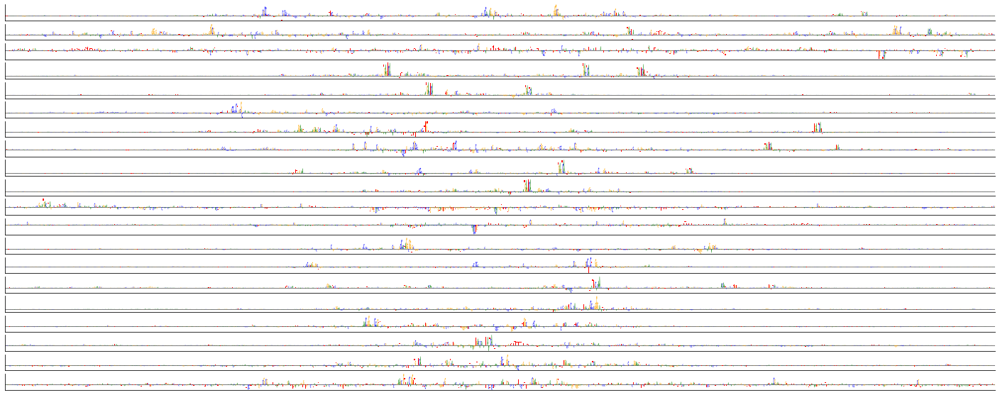

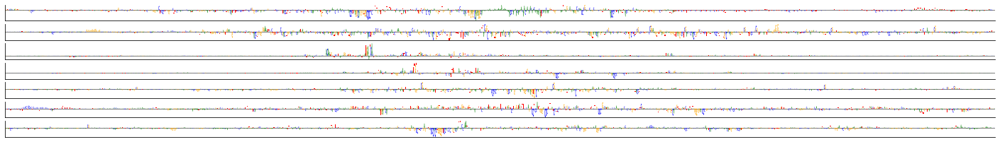

<Figure size 1800x720 with 0 Axes>

<Figure size 1800x720 with 0 Axes>

<Figure size 1800x720 with 0 Axes>

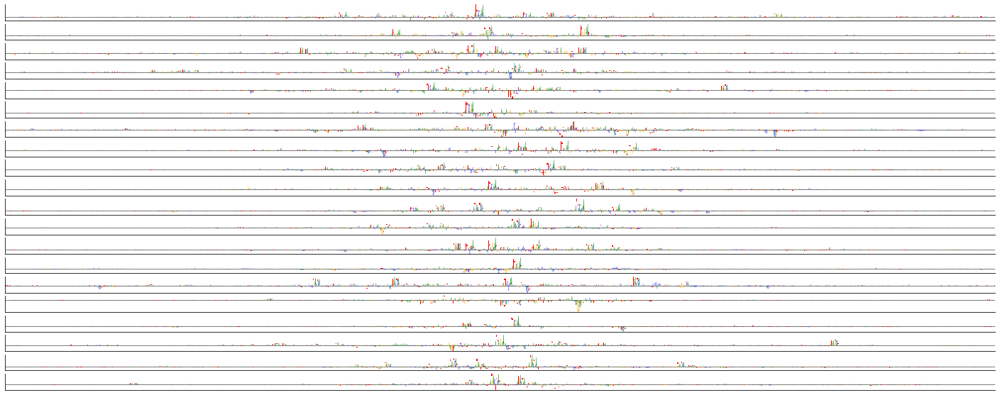

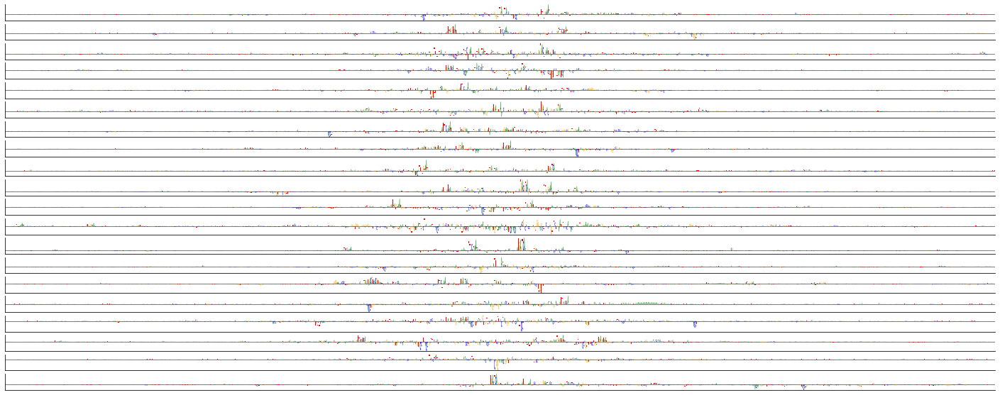

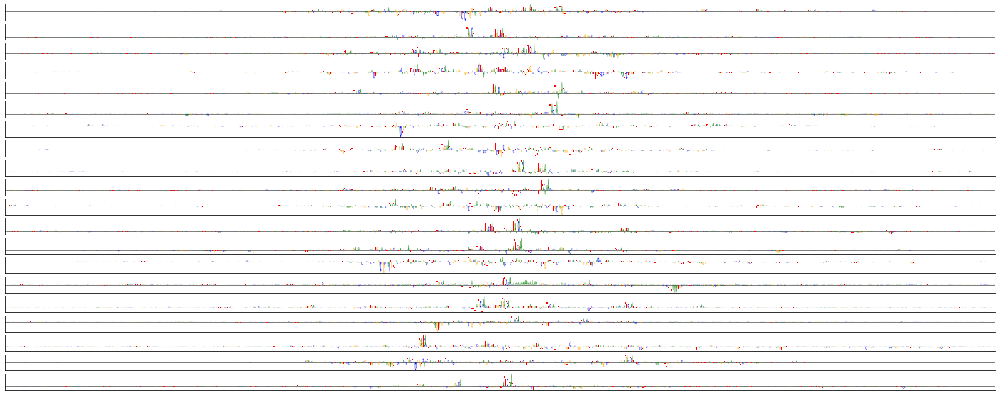

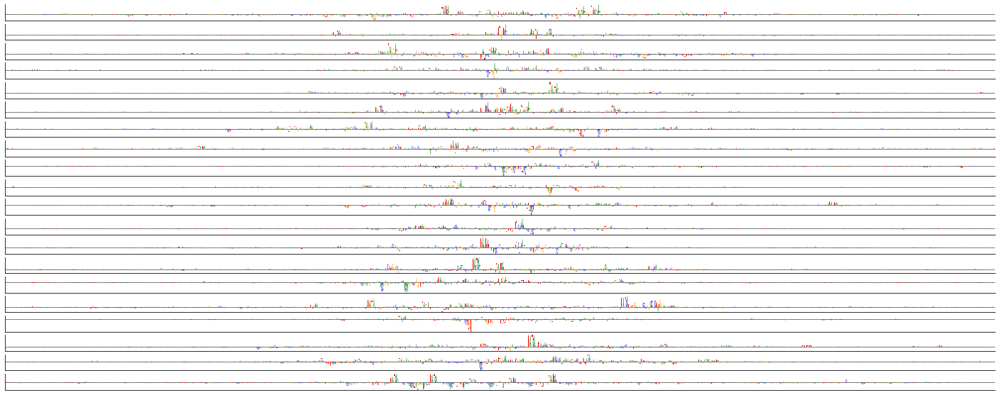

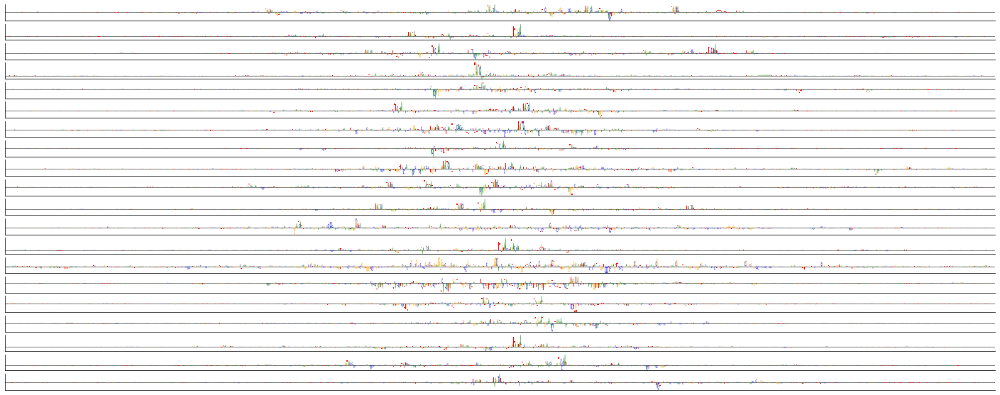

...

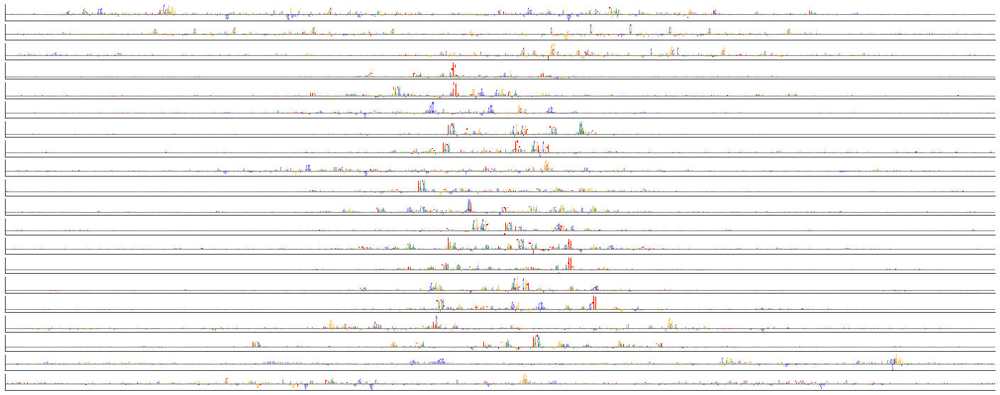

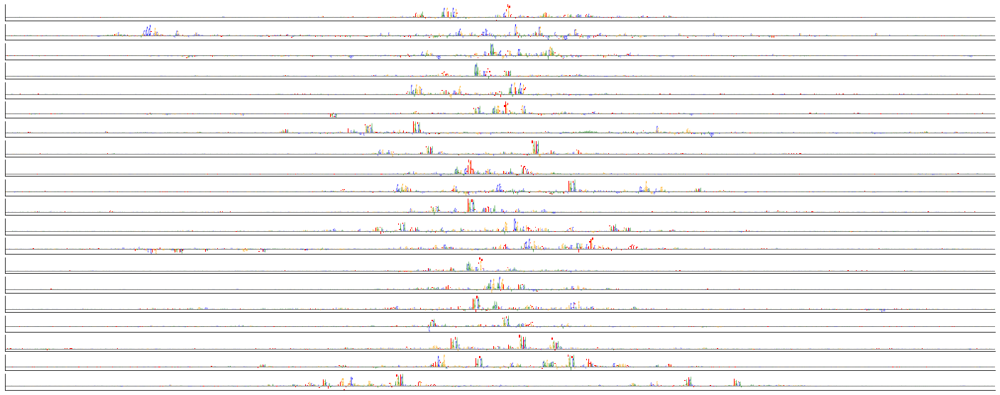

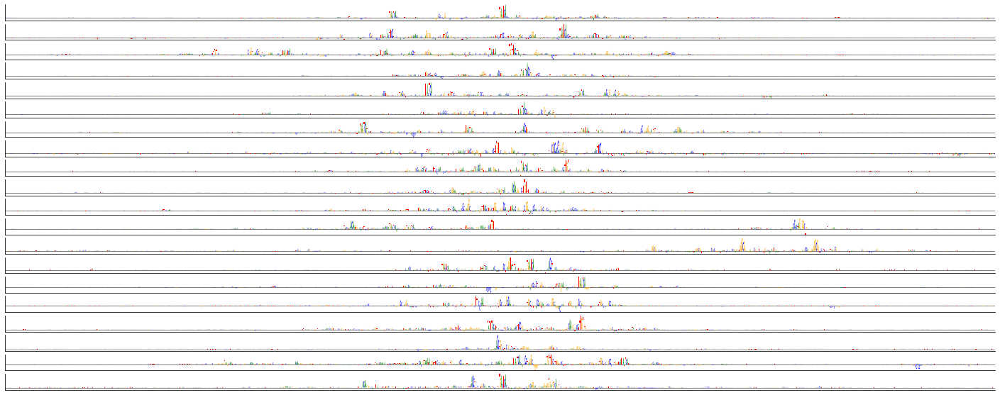

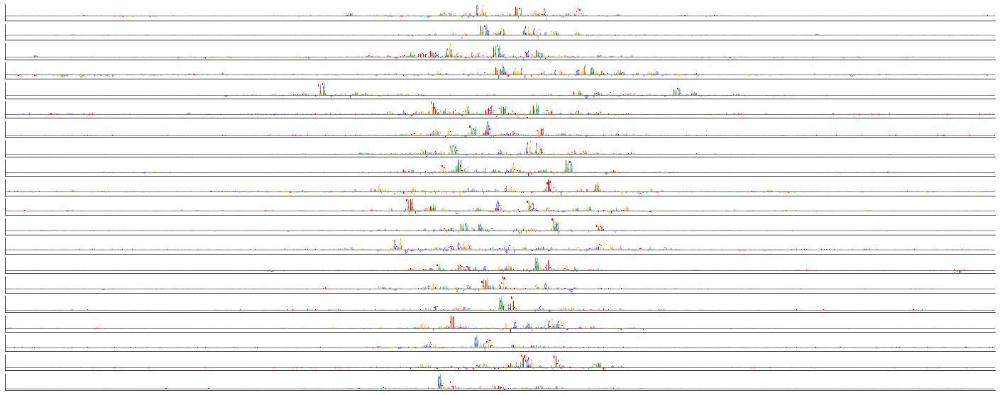

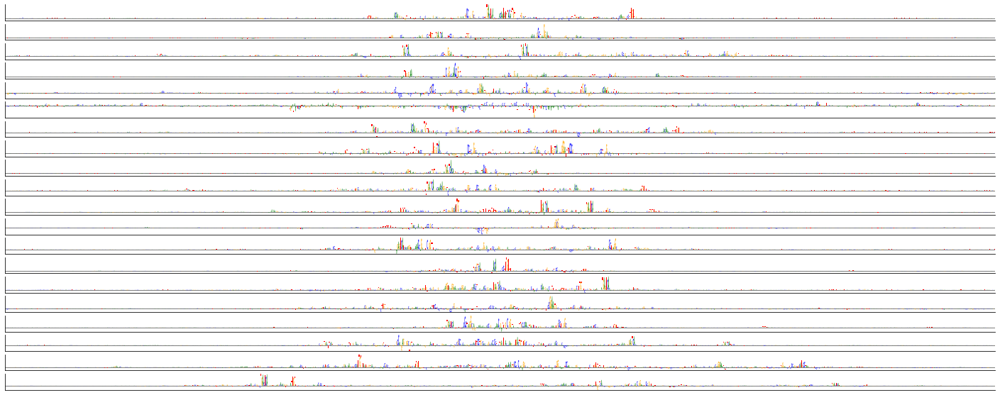

In [44]:
num_plots = 100

attr_score = {}
for class_index in range(num_labels):

    # get high predicted sequences 
    pos_index = np.where((y_test[:, class_index] == 1)& (np.sum(y_test[:,6:],axis=1)==1))[0]
    predictions = model.predict(x_test[pos_index])
    plot_index = pos_index[np.argsort(predictions[:,class_index])[::-1]]
    X = x_test[plot_index[0:num_plots]]

    # get attribution scores
    attr_score[class_index] = saliency(model, X, class_index=class_index, layer=-1, batch_size=256)
    attr_score[class_index] = attr_score[class_index] * X

    
# plot attribution scores for sequences with top predictions
for class_index in range(6,num_labels):
    N, L, A = attr_score[class_index].shape
    
    for k in range(5):

        try:
            fig = plt.figure(figsize=(25,10))
            for n,i in enumerate(range(k*20,(k+1)*20)):
                counts_df = pd.DataFrame(data=0.0, columns=list('ACGT'), index=list(range(L)))
                for a in range(A):
                    for l in range(L):
                        counts_df.iloc[l,a] = attr_score[class_index][i,l,a]

                ax = plt.subplot(20,1,n+1)
                logomaker.Logo(counts_df, ax=ax)
                ax.spines['right'].set_visible(False)
                ax.spines['top'].set_visible(False)
                ax.yaxis.set_ticks_position('none')
                ax.xaxis.set_ticks_position('none')
                plt.xticks([])
                plt.yticks([])
            outfile = os.path.join(save_path, str(class_index)+'_'+str(k)+'_nonoverlap.pdf')
            fig.savefig(outfile, format='pdf', dpi=200, bbox_inches='tight')
        except:
            print('ran out')

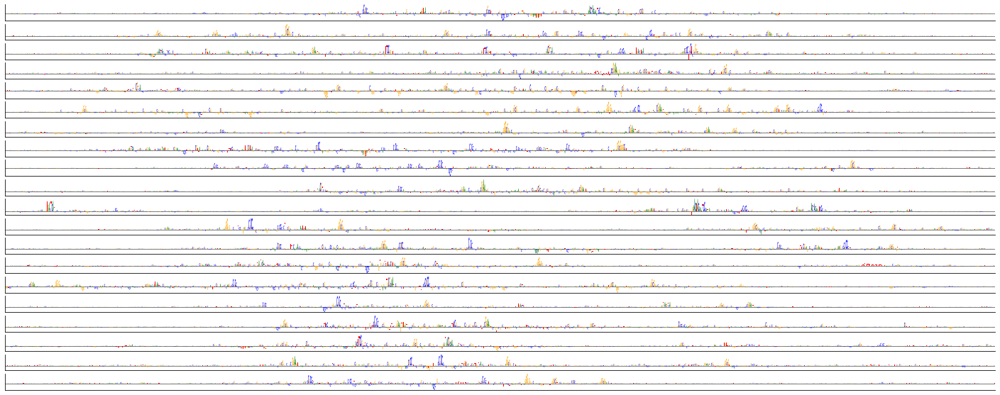

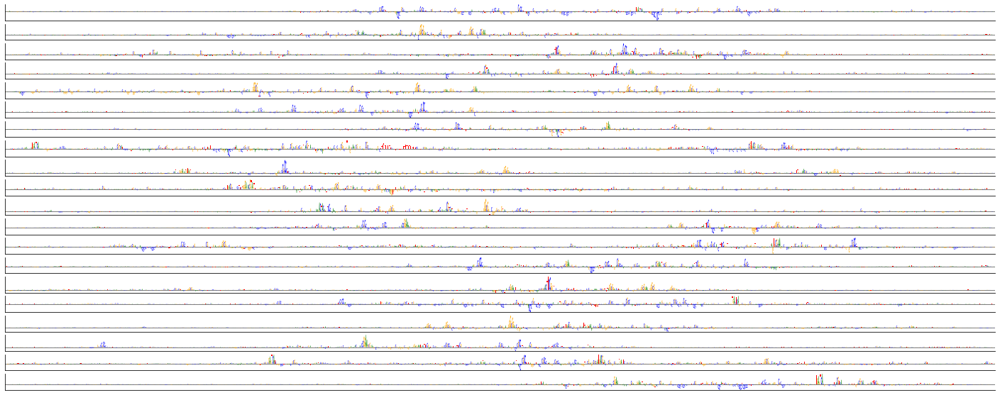

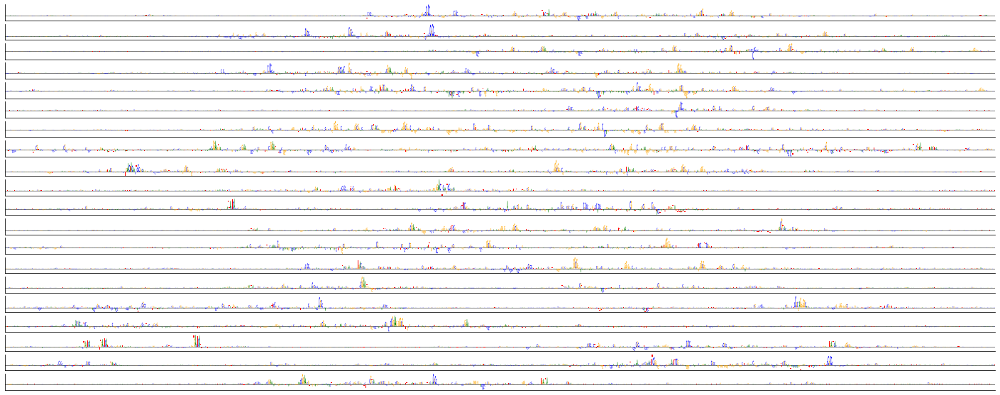

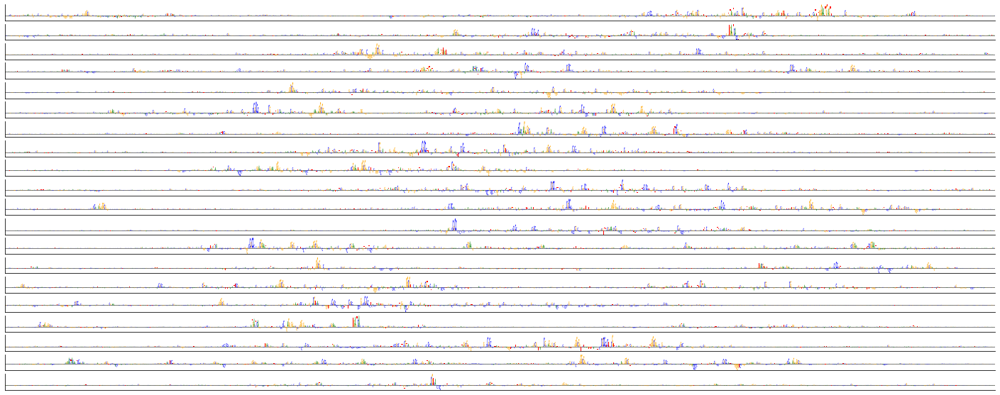

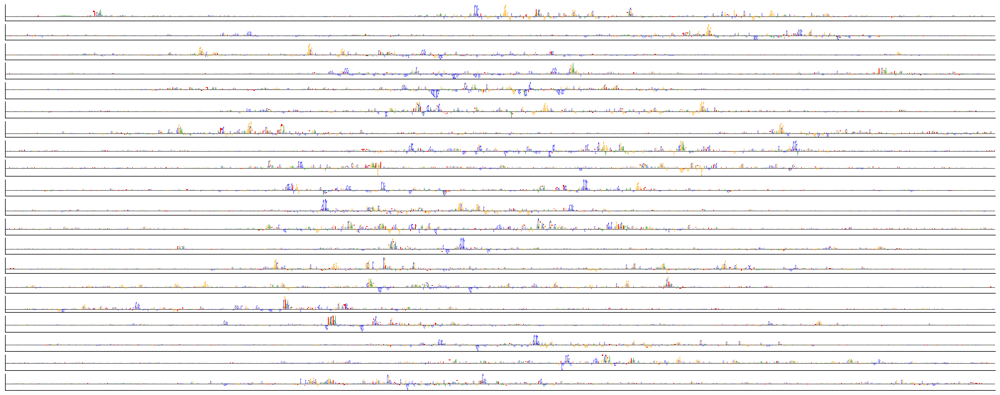

...

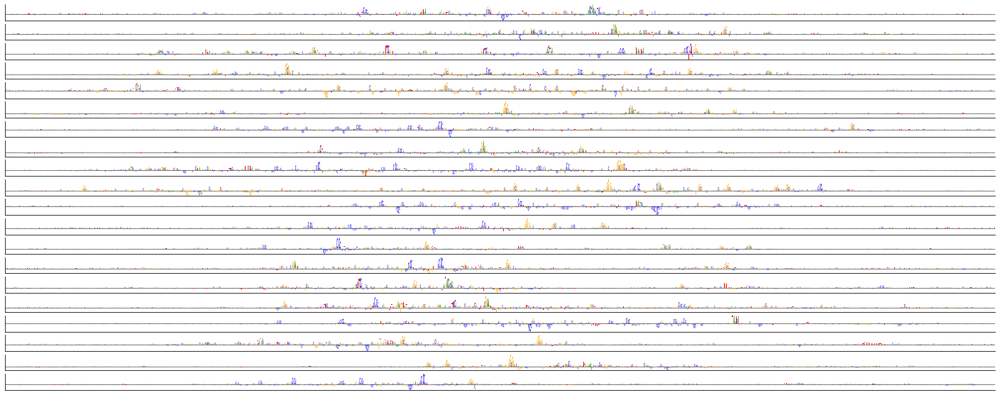

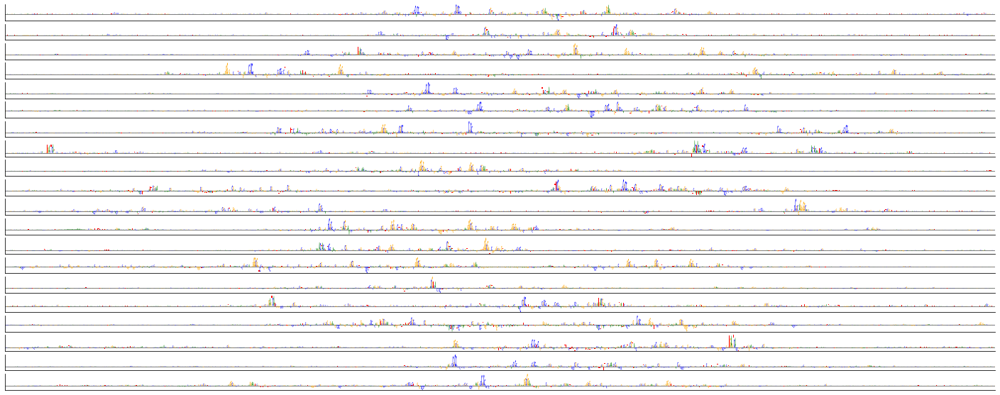

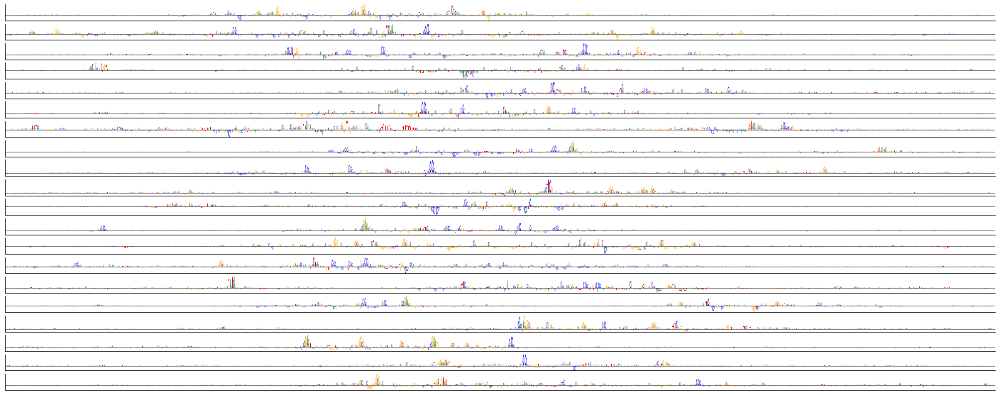

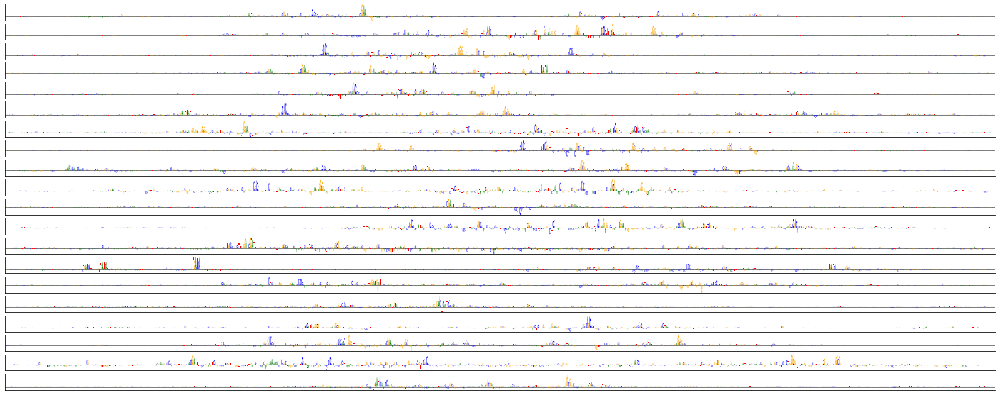

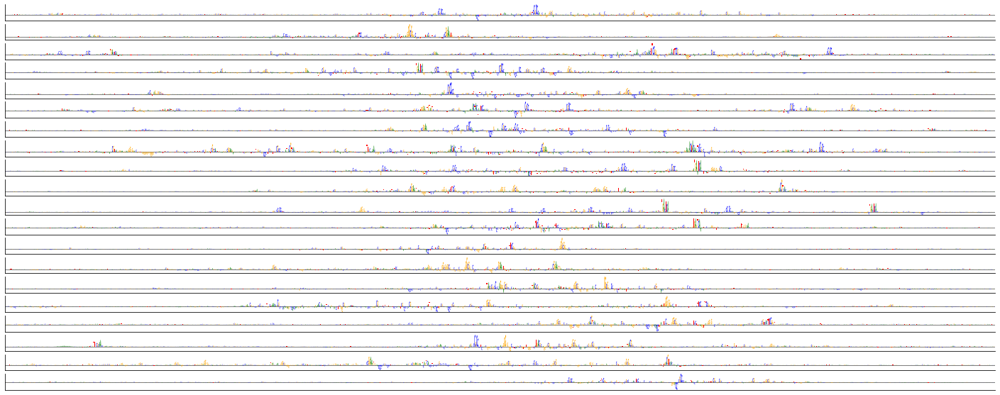

In [49]:
num_plots = 100

attr_score = {}
for class_index in range(6,num_labels):

    # get high predicted sequences 
    pos_index = np.where((y_test[:, class_index] == 1)& (np.sum(y_test[:,6:],axis=1)==4))[0]
    predictions = model.predict(x_test[pos_index])
    plot_index = pos_index[np.argsort(predictions[:,class_index])[::-1]]
    X = x_test[plot_index[0:num_plots]]

    # get attribution scores
    attr_score[class_index] = saliency(model, X, class_index=class_index, layer=-1, batch_size=256)
    attr_score[class_index] = attr_score[class_index] * X

    
# plot attribution scores for sequences with top predictions
for class_index in range(6,num_labels):
    N, L, A = attr_score[class_index].shape
   
    for k in range(5):
        try:
            fig = plt.figure(figsize=(25,10))
            for n,i in enumerate(range(k*20,(k+1)*20)):
                counts_df = pd.DataFrame(data=0.0, columns=list('ACGT'), index=list(range(L)))
                for a in range(A):
                    for l in range(L):
                        counts_df.iloc[l,a] = attr_score[class_index][i,l,a]

                ax = plt.subplot(20,1,n+1)
                logomaker.Logo(counts_df, ax=ax)
                ax.spines['right'].set_visible(False)
                ax.spines['top'].set_visible(False)
                ax.yaxis.set_ticks_position('none')
                ax.xaxis.set_ticks_position('none')
                plt.xticks([])
                plt.yticks([])
            outfile = os.path.join(save_path, str(class_index)+'_'+str(k)+'_overlap.pdf')
            fig.savefig(outfile, format='pdf', dpi=200, bbox_inches='tight')
        except:
            print('ran out')

#### mutagenesis attribution scores

In [18]:
num_plots = 20

attr_score = {}
for class_index in range(num_labels):

    # get high predicted sequences 
    pos_index = np.where(y_test[:, class_index] == 1)[0]
    predictions = model.predict(x_test[pos_index])
    plot_index = pos_index[np.argsort(predictions[:,class_index])[::-1]]
    X = x_test[plot_index[0:num_plots]]

    # get attribution scores
    attr_score[class_index] = mutagenesis(model, X, class_index=class_index, layer=-1)
    attr_score[class_index] = np.sqrt(np.sum(attr_score[class_index]**2, axis=2, keepdims=True)) * X


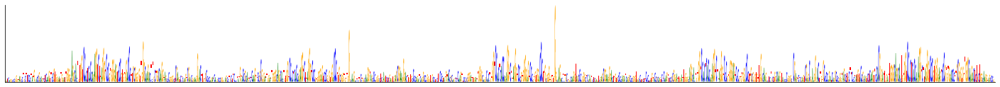

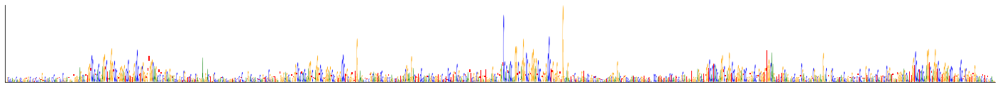

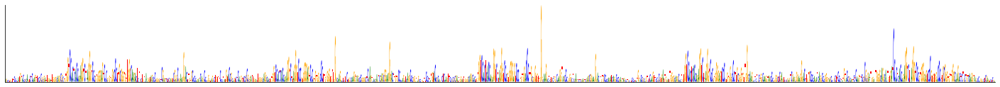

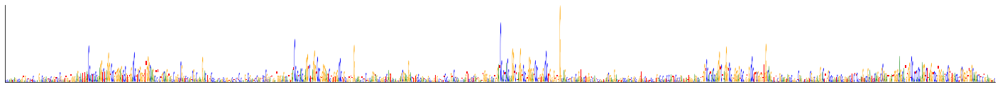

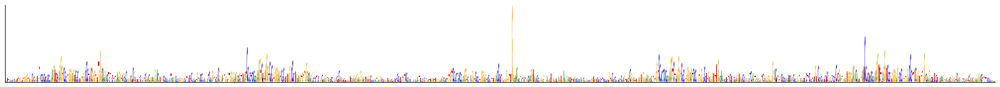

...

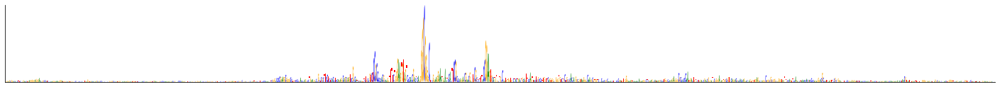

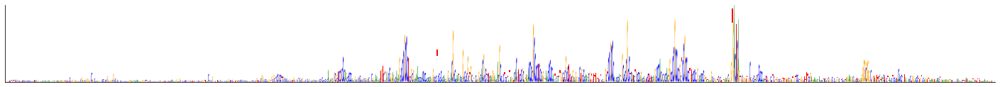

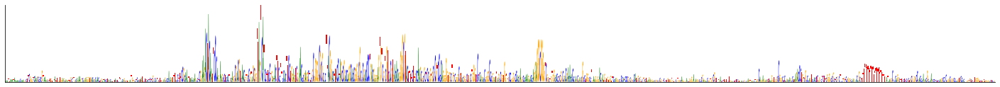

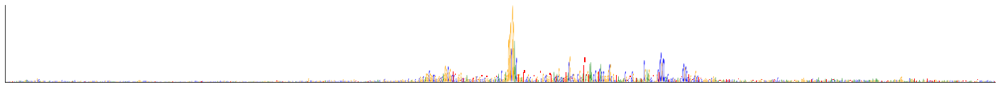

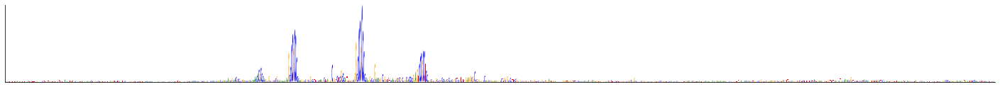

In [19]:
# plot attribution scores for sequences with top predictions
for class_index in range(num_labels):
    N, L, A = attr_score[class_index].shape
    
    for i in range(num_plots):
        counts_df = pd.DataFrame(data=0.0, columns=list('ACGT'), index=list(range(L)))
        for a in range(A):
            for l in range(L):
                counts_df.iloc[l,a] = attr_score[class_index][i,l,a]

        logomaker.Logo(counts_df, figsize=(30,1))
        ax = plt.gca()
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.yaxis.set_ticks_position('none')
        ax.xaxis.set_ticks_position('none')
        plt.xticks([])
        plt.yticks([])
        fig = plt.gcf()
        outfile = os.path.join(save_path, str(class_index)+'_'+str(pos_index[i])+'_mutagenesis.pdf')
        fig.savefig(outfile, format='pdf', dpi=200, bbox_inches='tight')


#### Plot first layer filters

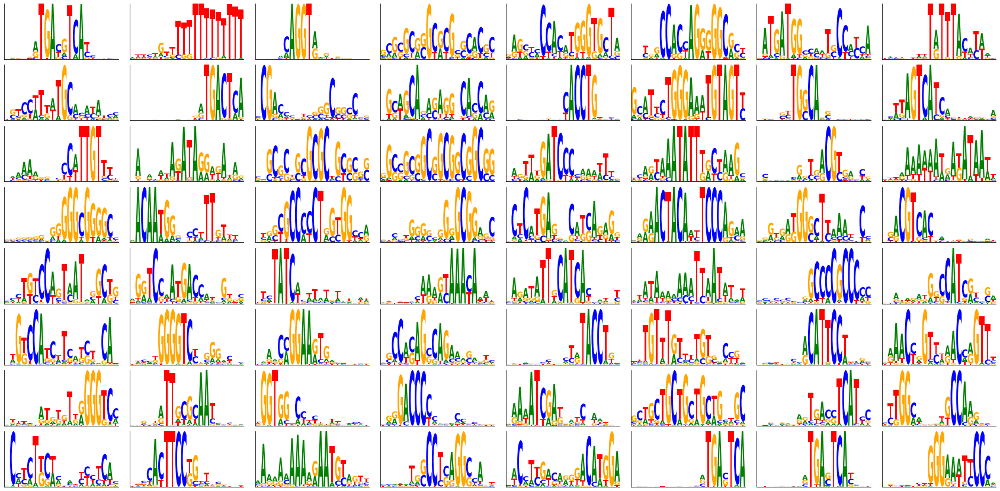

In [20]:
fig, W, logo = plot_filers(model, x_test, layer=3, threshold=0.5, 
                                    window=20, num_cols=8, figsize=(30,15))
outfile = os.path.join(save_path, name + '_filters.pdf')
fig.savefig(outfile, format='pdf', dpi=200, bbox_inches='tight')

# generate meme file
W_clipped = clip_filters(W, threshold=0.5, pad=3)
output_file = os.path.join(save_path, 'filters.meme')
meme_generate(W_clipped, output_file) 

# modisco analysis

In [21]:
task_to_contrib_scores = {}
task_to_hyp_contrib_scores = {}
for class_index in range(num_labels):
    
    # get high predicted sequences 
    pos_index = np.where(y_test[:, class_index] == 1)[0]
    X = x_test[pos_index]
    
    attr_score = saliency(model, X, class_index=class_index, layer=-1, batch_size=256)
    task_to_contrib_scores[class_index] = attr_score*X
    task_to_hyp_contrib_scores[class_index] = attr_score - np.mean(attr_score, axis=-1)[:,:,None]

In [22]:
if (os.path.isfile("scores.h5")):
    !rm scores.h5
    
f = h5py.File("scores.h5")
g = f.create_group("contrib_scores")
for task_idx in range(num_labels):
    g.create_dataset("task"+str(task_idx), data=task_to_contrib_scores[task_idx])
g = f.create_group("hyp_contrib_scores")
for task_idx in range(num_labels):
    g.create_dataset("task"+str(task_idx), data=task_to_hyp_contrib_scores[task_idx])
f.close()

The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


In [23]:
from collections import OrderedDict

task_to_scores = OrderedDict()
task_to_hyp_scores = OrderedDict()

f = h5py.File("scores.h5","r")
keys = []
for key in f["contrib_scores"].keys():
    keys.append(key)
    
for task in keys:
    task_to_scores[task] = [np.array(x) for x in f['contrib_scores'][task]]
    task_to_hyp_scores[task] = [np.array(x) for x in f['hyp_contrib_scores'][task]]

Running TF-MoDISco for task task0
MEMORY 13.170212864
On task task0
Computing windowed sums on original


TF-MoDISco is using the TensorFlow backend.


Generating null dist
peak(mu)= 0.0015991502851247787
Computing threshold
Thresholds from null dist were -0.09568816423416138  and  0.15236836671829224
Passing windows frac was 0.010209983386145946 , which is below  0.03 ; adjusting
Final raw thresholds are -0.0734695690870285  and  0.0734695690870285
Final transformed thresholds are -0.9699992135453702  and  0.9699992135453702


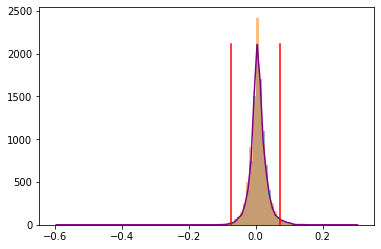

Got 4060 coords
After resolving overlaps, got 4060 seqlets
Across all tasks, the weakest transformed threshold used was: 0.9698992135453702
MEMORY 13.234507776
4060 identified in total
2 activity patterns with support >= 100 out of 3 possible patterns
Metacluster sizes:  [2172, 1888]
Idx to activities:  {0: '1', 1: '-1'}
MEMORY 13.234507776
On metacluster 1
Metacluster size 1888
Relevant tasks:  ('task0',)
Relevant signs:  (-1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 1888
(Round 1) Computing coarse affmat
MEMORY 13.23470848
Beginning embedding computation
Computing embeddings
Finished embedding computation in 1.96 s
Starting affinity matrix computations
Normalization computed in 0.02 s
Cosine similarity mat computed in 0.05 s
Normalization computed in 0.03 s
Cosine similarity mat computed in 0.05 s
Finished affinity matrix computations in 0.12 s
(Round 1) Compute nearest neighbors from coarse affmat
MEMORY 13.280145408
Computed nearest neighbors in 0.36 s
M

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7826715531372105


  2%|▏         | 1/50 [00:00<00:17,  2.77it/s]

Quality: 0.7830283293828997


  4%|▍         | 2/50 [00:00<00:18,  2.64it/s]

Quality: 0.783233987163816


  8%|▊         | 4/50 [00:01<00:17,  2.65it/s]

Quality: 0.7834585002397166


 16%|█▌        | 8/50 [00:02<00:12,  3.40it/s]

Quality: 0.7834937863122664


 54%|█████▍    | 27/50 [00:08<00:06,  3.45it/s]

Quality: 0.7836033322646772


 98%|█████████▊| 49/50 [00:15<00:00,  3.15it/s]

Quality: 0.7836368156287487


100%|██████████| 50/50 [00:15<00:00,  3.19it/s]

Got 15 clusters after round 1
Counts:
{6: 67, 0: 309, 14: 18, 4: 120, 3: 135, 1: 250, 12: 28, 10: 48, 11: 45, 9: 51, 13: 22, 8: 54, 2: 228, 5: 111, 7: 56}
MEMORY 13.213708288
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.213708288
Aggregating for cluster 0 with 309 seqlets
MEMORY 13.213708288


Trimmed 30 out of 309
Removed 3 duplicate seqlets
Aggregating for cluster 1 with 250 seqlets
MEMORY 13.213708288
Trimmed 10 out of 250
Skipped 1 seqlets
Aggregating for cluster 2 with 228 seqlets
MEMORY 13.213708288
Trimmed 14 out of 228
Aggregating for cluster 3 with 135 seqlets
MEMORY 13.213708288
Trimmed 6 out of 135
Skipped 1 seqlets
Removed 3 duplicate seqlets
Aggregating for cluster 4 with 120 seqlets
MEMORY 13.213708288
Trimmed 14 out of 120
Aggregating for cluster 5 with 111 seqlets
MEMORY 13.213708288
Trimmed 1 out of 111
Aggregating for cluster 6 with 67 seqlets
MEMORY 13.213708288
Trimmed 5 out of 67
Aggregating for cluster 7 with 56 seqlets
MEMORY 13.213708288
Trimmed 6 out of 56
Aggregating for cluster 8 with 54 seqlets
MEMORY 13.213708288
Trimmed 1 out of 54
Removed 1 duplicate seqlets
Aggregating for cluster 9 with 51 seqlets
MEMORY 13.213708288
Trimmed 5 out of 51
Aggregating for cluster 10 with 48 seqlets
MEMORY 13.213708288
Trimmed 3 out of 48
Removed 3 duplicate seql

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7899678033924056


 66%|██████▌   | 33/50 [00:09<00:04,  3.48it/s]

Quality: 0.7899795211459988


 76%|███████▌  | 38/50 [00:10<00:02,  4.10it/s]

Quality: 0.7900313913585069


100%|██████████| 50/50 [00:13<00:00,  3.77it/s]

Got 14 clusters after round 2
Counts:
{0: 271, 10: 49, 5: 75, 3: 143, 7: 69, 13: 25, 1: 225, 6: 75, 4: 121, 2: 198, 11: 43, 12: 32, 8: 52, 9: 50}
MEMORY 13.262491648
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.262491648
Aggregating for cluster 0 with 271 seqlets
MEMORY 13.262491648


Trimmed 10 out of 271
Removed 10 duplicate seqlets
Aggregating for cluster 1 with 225 seqlets
MEMORY 13.262491648
Trimmed 11 out of 225
Aggregating for cluster 2 with 198 seqlets
MEMORY 13.262491648
Trimmed 45 out of 198
Aggregating for cluster 3 with 143 seqlets
MEMORY 13.262491648
Trimmed 13 out of 143
Aggregating for cluster 4 with 121 seqlets
MEMORY 13.262491648
Trimmed 27 out of 121
Aggregating for cluster 5 with 75 seqlets
MEMORY 13.262491648
Trimmed 20 out of 75
Removed 1 duplicate seqlets
Aggregating for cluster 6 with 75 seqlets
MEMORY 13.262491648
Trimmed 14 out of 75
Aggregating for cluster 7 with 69 seqlets
MEMORY 13.262491648
Trimmed 18 out of 69
Aggregating for cluster 8 with 52 seqlets
MEMORY 13.262491648
Trimmed 1 out of 52
Aggregating for cluster 9 with 50 seqlets
MEMORY 13.262491648
Trimmed 4 out of 50
Removed 1 duplicate seqlets
Aggregating for cluster 10 with 49 seqlets
MEMORY 13.262491648
Trimmed 5 out of 49
Aggregating for cluster 11 with 43 seqlets
MEMORY 13.2624

Beginning embedding computation
Computing embeddings
Finished embedding computation in 2.09 s
Starting affinity matrix computations
Normalization computed in 0.02 s
Cosine similarity mat computed in 0.06 s
Normalization computed in 0.03 s
Cosine similarity mat computed in 0.06 s
Finished affinity matrix computations in 0.15 s
(Round 1) Compute nearest neighbors from coarse affmat
MEMORY 13.299908608
Computed nearest neighbors in 0.39 s
MEMORY 13.300125696
(Round 1) Computing affinity matrix on nearest neighbors
MEMORY 13.300125696
Launching nearest neighbors affmat calculation job
MEMORY 13.300125696
Parallel runs completed
MEMORY 13.30014208
Job completed in: 12.59 s
MEMORY 13.30014208
Launching nearest neighbors affmat calculation job
MEMORY 13.30014208
Parallel runs completed
MEMORY 13.300178944
Job completed in: 12.71 s
MEMORY 13.337755648
(Round 1) Computed affinity matrix on nearest neighbors in 25.73 s
MEMORY 13.337935872
Filtered down to 1453 of 2172
(Round 1) Retained 1453 row

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7438215077797192


  2%|▏         | 1/50 [00:00<00:16,  2.99it/s]

Quality: 0.7446523528937324


  6%|▌         | 3/50 [00:00<00:14,  3.14it/s]

Quality: 0.7447481429577953


 16%|█▌        | 8/50 [00:02<00:15,  2.69it/s]

Quality: 0.7448978200737769


 52%|█████▏    | 26/50 [00:08<00:07,  3.06it/s]

Quality: 0.7449088070403931


100%|██████████| 50/50 [00:17<00:00,  2.82it/s]

Got 16 clusters after round 1
Counts:
{1: 257, 2: 226, 0: 284, 13: 23, 3: 131, 8: 59, 4: 83, 7: 59, 5: 76, 9: 57, 6: 61, 10: 38, 11: 38, 14: 20, 12: 26, 15: 15}
MEMORY 13.264257024
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.264257024
Aggregating for cluster 0 with 284 seqlets
MEMORY 13.264257024


Trimmed 9 out of 284
Removed 5 duplicate seqlets
Aggregating for cluster 1 with 257 seqlets
MEMORY 13.264257024
Trimmed 24 out of 257
Aggregating for cluster 2 with 226 seqlets
MEMORY 13.264257024
Trimmed 18 out of 226
Aggregating for cluster 3 with 131 seqlets
MEMORY 13.264257024
Trimmed 7 out of 131
Skipped 1 seqlets
Aggregating for cluster 4 with 83 seqlets
MEMORY 13.264257024
Trimmed 5 out of 83
Aggregating for cluster 5 with 76 seqlets
MEMORY 13.264257024
Trimmed 1 out of 76
Aggregating for cluster 6 with 61 seqlets
MEMORY 13.264257024
Trimmed 4 out of 61
Skipped 1 seqlets
Aggregating for cluster 7 with 59 seqlets
MEMORY 13.264257024
Trimmed 1 out of 59
Aggregating for cluster 8 with 59 seqlets
MEMORY 13.264257024
Trimmed 10 out of 59
Aggregating for cluster 9 with 57 seqlets
MEMORY 13.264257024
Trimmed 3 out of 57
Aggregating for cluster 10 with 38 seqlets
MEMORY 13.264257024
Trimmed 1 out of 38
Aggregating for cluster 11 with 38 seqlets
MEMORY 13.264257024
Trimmed 6 out of 38
Ag

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7557950746724491


  6%|▌         | 3/50 [00:00<00:14,  3.22it/s]

Quality: 0.7561493550226874


 12%|█▏        | 6/50 [00:01<00:11,  3.71it/s]

Quality: 0.7565425897606108


100%|██████████| 50/50 [00:12<00:00,  3.98it/s]

Got 17 clusters after round 2
Counts:
{0: 267, 9: 50, 3: 123, 15: 14, 13: 21, 4: 110, 12: 25, 5: 82, 7: 52, 8: 50, 10: 29, 1: 232, 16: 3, 2: 198, 6: 53, 11: 25, 14: 17}
MEMORY 13.264265216
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.264265216
Aggregating for cluster 0 with 267 seqlets
MEMORY 13.264265216


Trimmed 29 out of 267
Aggregating for cluster 1 with 232 seqlets
MEMORY 13.264265216
Trimmed 11 out of 232
Aggregating for cluster 2 with 198 seqlets
MEMORY 13.264265216
Trimmed 26 out of 198
Aggregating for cluster 3 with 123 seqlets
MEMORY 13.264265216
Trimmed 12 out of 123
Aggregating for cluster 4 with 110 seqlets
MEMORY 13.264265216
Trimmed 2 out of 110
Aggregating for cluster 5 with 82 seqlets
MEMORY 13.264265216
Trimmed 2 out of 82
Aggregating for cluster 6 with 53 seqlets
MEMORY 13.264265216
Trimmed 16 out of 53
Aggregating for cluster 7 with 52 seqlets
MEMORY 13.264265216
Trimmed 4 out of 52
Aggregating for cluster 8 with 50 seqlets
MEMORY 13.264265216
Trimmed 4 out of 50
Aggregating for cluster 9 with 50 seqlets
MEMORY 13.264265216
Trimmed 13 out of 50
Aggregating for cluster 10 with 29 seqlets
MEMORY 13.264265216
Trimmed 0 out of 29
Aggregating for cluster 11 with 25 seqlets
MEMORY 13.264265216
Trimmed 11 out of 25
Aggregating for cluster 12 with 25 seqlets
MEMORY 13.2642652

Skipped 1 seqlets
Got 9 patterns after reassignment
MEMORY 13.264134144
Total time taken is 140.27s
MEMORY 13.264134144
Metacluster 0 for task task0
Pattern idx 0 with 280 seqlets
Pattern idx 1 with 240 seqlets
Pattern idx 2 with 179 seqlets
Pattern idx 3 with 102 seqlets
Pattern idx 4 with 100 seqlets
Pattern idx 5 with 50 seqlets
Pattern idx 6 with 43 seqlets
Pattern idx 7 with 47 seqlets
Pattern idx 8 with 39 seqlets
Metacluster 1 for task task0
Pattern idx 0 with 257 seqlets
Pattern idx 1 with 218 seqlets
Pattern idx 2 with 163 seqlets
Pattern idx 3 with 98 seqlets
Pattern idx 4 with 63 seqlets
Pattern idx 5 with 56 seqlets
Pattern idx 6 with 55 seqlets
Pattern idx 7 with 61 seqlets
Pattern idx 8 with 47 seqlets
Pattern idx 9 with 42 seqlets
Pattern idx 10 with 33 seqlets
Running TF-MoDISco for task task1
MEMORY 13.03320576
On task task1
Computing windowed sums on original


The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Generating null dist
peak(mu)= 0.006306404972448945
Computing threshold
Thresholds from null dist were -0.09349821507930756  and  0.15022939443588257
Passing windows frac was 0.015849023075189404 , which is below  0.03 ; adjusting
Final raw thresholds are -0.09253978729248047  and  0.09253978729248047
Final transformed thresholds are -0.9699993282016609  and  0.9699993282016609


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


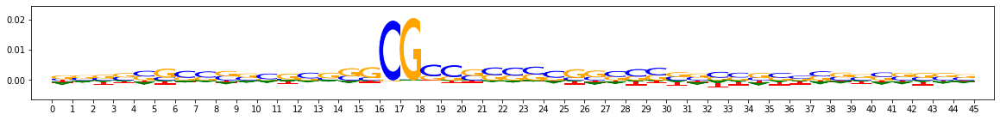

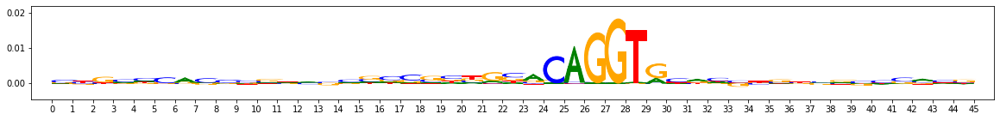

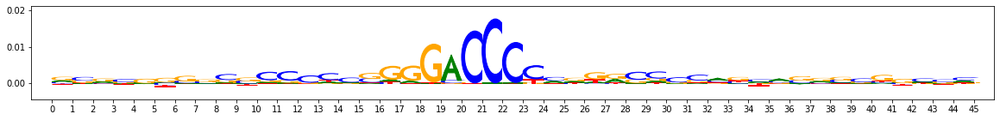

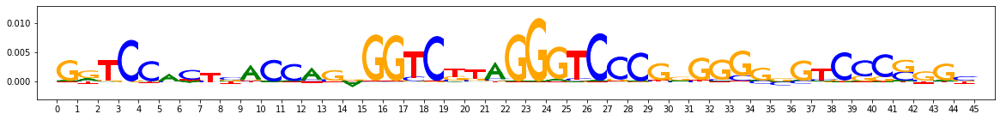

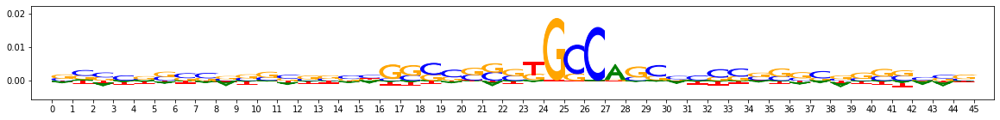

...

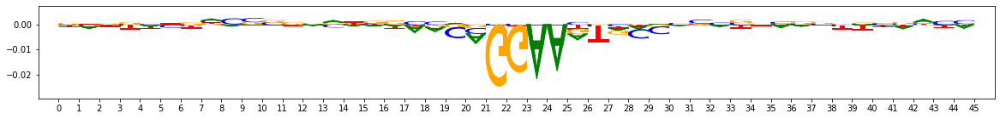

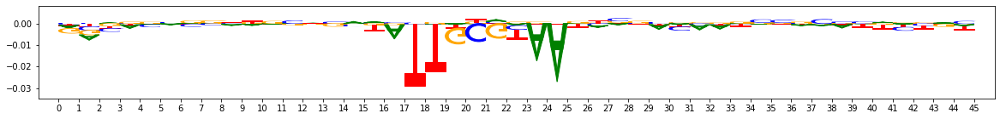

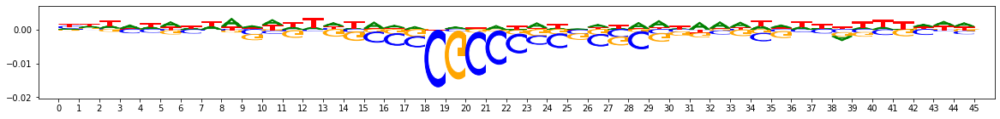

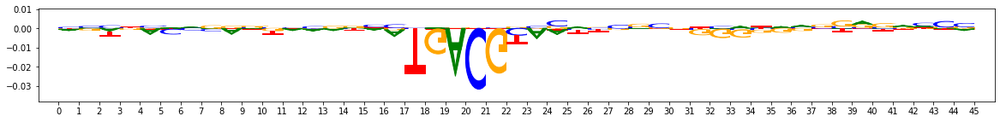

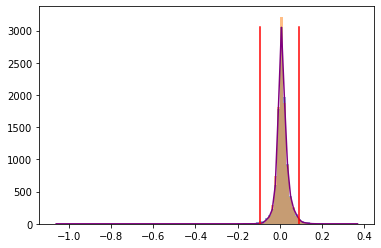

Got 5836 coords
After resolving overlaps, got 5836 seqlets
Across all tasks, the weakest transformed threshold used was: 0.9698993282016609
MEMORY 13.129170944
5836 identified in total
2 activity patterns with support >= 100 out of 3 possible patterns
Metacluster sizes:  [3598, 2238]
Idx to activities:  {0: '1', 1: '-1'}
MEMORY 13.129170944
On metacluster 1
Metacluster size 2238
Relevant tasks:  ('task1',)
Relevant signs:  (-1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 2238
(Round 1) Computing coarse affmat
MEMORY 13.129170944
Beginning embedding computation
Computing embeddings
Finished embedding computation in 2.15 s
Starting affinity matrix computations
Normalization computed in 0.02 s
Cosine similarity mat computed in 0.07 s
Normalization computed in 0.03 s
Cosine similarity mat computed in 0.07 s
Finished affinity matrix computations in 0.16 s
(Round 1) Compute nearest neighbors from coarse affmat
MEMORY 13.160128512
Computed nearest neighbors in 0.44 s


  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8055827795159884


  2%|▏         | 1/50 [00:00<00:11,  4.09it/s]

Quality: 0.8056910529474817


  8%|▊         | 4/50 [00:01<00:12,  3.72it/s]

Quality: 0.8057556897996394


 22%|██▏       | 11/50 [00:03<00:11,  3.27it/s]

Quality: 0.8058126276087002


 58%|█████▊    | 29/50 [00:08<00:06,  3.28it/s]

Quality: 0.8058198509133082


100%|██████████| 50/50 [00:15<00:00,  3.28it/s]

Got 14 clusters after round 1
Counts:
{6: 111, 0: 372, 2: 185, 12: 32, 10: 57, 1: 249, 7: 97, 5: 118, 9: 58, 13: 20, 11: 37, 4: 171, 3: 175, 8: 80}
MEMORY 13.160296448
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.160296448
Aggregating for cluster 0 with 372 seqlets
MEMORY 13.160296448


Trimmed 57 out of 372
Aggregating for cluster 1 with 249 seqlets
MEMORY 13.160296448
Trimmed 22 out of 249
Aggregating for cluster 2 with 185 seqlets
MEMORY 13.160296448
Trimmed 15 out of 185
Aggregating for cluster 3 with 175 seqlets
MEMORY 13.160296448
Trimmed 10 out of 175
Aggregating for cluster 4 with 171 seqlets
MEMORY 13.160296448
Trimmed 9 out of 171
Aggregating for cluster 5 with 118 seqlets
MEMORY 13.160296448
Trimmed 9 out of 118
Removed 7 duplicate seqlets
Aggregating for cluster 6 with 111 seqlets
MEMORY 13.160296448
Trimmed 15 out of 111
Aggregating for cluster 7 with 97 seqlets
MEMORY 13.160296448
Trimmed 5 out of 97
Aggregating for cluster 8 with 80 seqlets
MEMORY 13.160296448
Trimmed 3 out of 80
Aggregating for cluster 9 with 58 seqlets
MEMORY 13.160296448
Trimmed 1 out of 58
Aggregating for cluster 10 with 57 seqlets
MEMORY 13.160296448
Trimmed 2 out of 57
Removed 1 duplicate seqlets
Aggregating for cluster 11 with 37 seqlets
MEMORY 13.160296448
Trimmed 2 out of 37
Ag

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8089469710566934


  2%|▏         | 1/50 [00:00<00:11,  4.10it/s]

Quality: 0.8091152215198653


  4%|▍         | 2/50 [00:00<00:11,  4.11it/s]

Quality: 0.8096310847267684


 14%|█▍        | 7/50 [00:01<00:11,  3.74it/s]

Quality: 0.8096362688643773


 84%|████████▍ | 42/50 [00:11<00:02,  3.90it/s]

Quality: 0.8096467921361152


 88%|████████▊ | 44/50 [00:11<00:01,  4.29it/s]

Quality: 0.8096519762737242


100%|██████████| 50/50 [00:13<00:00,  3.79it/s]

Got 15 clusters after round 2
Counts:
{0: 324, 10: 58, 9: 68, 4: 141, 7: 91, 1: 238, 5: 101, 3: 154, 2: 167, 8: 74, 14: 5, 6: 95, 12: 32, 11: 35, 13: 16}
MEMORY 13.160288256
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.160288256
Aggregating for cluster 0 with 324 seqlets
MEMORY 13.160288256


Trimmed 23 out of 324
Aggregating for cluster 1 with 238 seqlets
MEMORY 13.160288256
Trimmed 21 out of 238
Aggregating for cluster 2 with 167 seqlets
MEMORY 13.160288256
Trimmed 30 out of 167
Aggregating for cluster 3 with 154 seqlets
MEMORY 13.160288256
Trimmed 32 out of 154
Aggregating for cluster 4 with 141 seqlets
MEMORY 13.160288256
Trimmed 6 out of 141
Aggregating for cluster 5 with 101 seqlets
MEMORY 13.160288256
Trimmed 8 out of 101
Aggregating for cluster 6 with 95 seqlets
MEMORY 13.160288256
Trimmed 6 out of 95
Aggregating for cluster 7 with 91 seqlets
MEMORY 13.160288256
Trimmed 6 out of 91
Aggregating for cluster 8 with 74 seqlets
MEMORY 13.160288256
Trimmed 15 out of 74
Aggregating for cluster 9 with 68 seqlets
MEMORY 13.160288256
Trimmed 1 out of 68
Removed 1 duplicate seqlets
Aggregating for cluster 10 with 58 seqlets
MEMORY 13.160288256
Trimmed 23 out of 58
Aggregating for cluster 11 with 35 seqlets
MEMORY 13.160288256
Trimmed 1 out of 35
Aggregating for cluster 12 with

(Round 1) Computing density adapted affmat
MEMORY 13.160288256
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 2263 samples in 0.004s...
[t-SNE] Computed neighbors for 2263 samples in 0.038s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2263
[t-SNE] Computed conditional probabilities for sample 2000 / 2263
[t-SNE] Computed conditional probabilities for sample 2263 / 2263
[t-SNE] Mean sigma: 0.262945
(Round 1) Computing clustering
MEMORY 13.160288256
Beginning preprocessing + Leiden


  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.750870290954076


  2%|▏         | 1/50 [00:00<00:22,  2.14it/s]

Quality: 0.7511580663445439


  6%|▌         | 3/50 [00:01<00:27,  1.70it/s]

Quality: 0.7511787834619503


 12%|█▏        | 6/50 [00:03<00:25,  1.72it/s]

Quality: 0.751246467891695


 60%|██████    | 30/50 [00:16<00:10,  1.97it/s]

Quality: 0.7513176963929231


100%|██████████| 50/50 [00:27<00:00,  1.81it/s]

Got 14 clusters after round 1
Counts:
{11: 55, 1: 353, 13: 36, 0: 458, 5: 173, 3: 225, 8: 93, 12: 42, 2: 283, 10: 58, 7: 95, 4: 194, 9: 59, 6: 139}
MEMORY 13.160288256
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.160288256
Aggregating for cluster 0 with 458 seqlets
MEMORY 13.160288256


Trimmed 115 out of 458
Aggregating for cluster 1 with 353 seqlets
MEMORY 13.160288256
Trimmed 30 out of 353
Removed 2 duplicate seqlets
Aggregating for cluster 2 with 283 seqlets
MEMORY 13.160288256
Trimmed 16 out of 283
Aggregating for cluster 3 with 225 seqlets
MEMORY 13.160288256
Trimmed 12 out of 225
Aggregating for cluster 4 with 194 seqlets
MEMORY 13.160288256
Trimmed 15 out of 194
Aggregating for cluster 5 with 173 seqlets
MEMORY 13.160288256
Trimmed 37 out of 173
Skipped 2 seqlets
Aggregating for cluster 6 with 139 seqlets
MEMORY 13.160288256
Trimmed 18 out of 139
Aggregating for cluster 7 with 95 seqlets
MEMORY 13.160288256
Trimmed 9 out of 95
Skipped 1 seqlets
Aggregating for cluster 8 with 93 seqlets
MEMORY 13.160288256
Trimmed 9 out of 93
Removed 1 duplicate seqlets
Aggregating for cluster 9 with 59 seqlets
MEMORY 13.160288256
Trimmed 3 out of 59
Skipped 1 seqlets
Aggregating for cluster 10 with 58 seqlets
MEMORY 13.160288256
Trimmed 3 out of 58
Aggregating for cluster 11 w

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7603350157628503


  6%|▌         | 3/50 [00:01<00:17,  2.67it/s]

Quality: 0.7606060897648595


100%|██████████| 50/50 [00:21<00:00,  2.27it/s]

Got 14 clusters after round 2
Counts:
{0: 340, 7: 112, 13: 9, 11: 45, 3: 214, 6: 134, 4: 175, 5: 140, 8: 91, 1: 294, 2: 263, 10: 53, 12: 39, 9: 58}
MEMORY 13.100326912
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.100326912
Aggregating for cluster 0 with 340 seqlets
MEMORY 13.100326912


Trimmed 53 out of 340
Aggregating for cluster 1 with 294 seqlets
MEMORY 13.100326912
Trimmed 76 out of 294
Removed 1 duplicate seqlets
Aggregating for cluster 2 with 263 seqlets
MEMORY 13.100326912
Trimmed 31 out of 263
Aggregating for cluster 3 with 214 seqlets
MEMORY 13.100326912
Trimmed 9 out of 214
Aggregating for cluster 4 with 175 seqlets
MEMORY 13.100326912
Trimmed 25 out of 175
Removed 1 duplicate seqlets
Aggregating for cluster 5 with 140 seqlets
MEMORY 13.100326912
Trimmed 21 out of 140
Aggregating for cluster 6 with 134 seqlets
MEMORY 13.100326912
Trimmed 4 out of 134
Removed 1 duplicate seqlets
Aggregating for cluster 7 with 112 seqlets
MEMORY 13.100326912
Trimmed 10 out of 112
Aggregating for cluster 8 with 91 seqlets
MEMORY 13.100326912
Trimmed 14 out of 91
Aggregating for cluster 9 with 58 seqlets
MEMORY 13.100326912
Trimmed 10 out of 58
Aggregating for cluster 10 with 53 seqlets
MEMORY 13.100326912
Trimmed 14 out of 53
Aggregating for cluster 11 with 45 seqlets
MEMORY 1

Pattern idx 3 with 207 seqlets
Pattern idx 4 with 152 seqlets
Pattern idx 5 with 126 seqlets
Pattern idx 6 with 77 seqlets
Pattern idx 7 with 57 seqlets
Pattern idx 8 with 73 seqlets
Pattern idx 9 with 39 seqlets
Pattern idx 10 with 38 seqlets
Pattern idx 11 with 33 seqlets
Metacluster 1 for task task1
Pattern idx 0 with 307 seqlets
Pattern idx 1 with 217 seqlets
Pattern idx 2 with 137 seqlets
Pattern idx 3 with 137 seqlets
Pattern idx 4 with 122 seqlets
Pattern idx 5 with 93 seqlets
Pattern idx 6 with 102 seqlets
Pattern idx 7 with 72 seqlets
Pattern idx 8 with 65 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 9 with 69 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 10 with 30 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Running TF-MoDISco for task task2
MEMORY 13.090107392
On task task2
Computing windowed sums on original
Generating null dist
peak(mu)= 0.0006246521957218648
Computing threshold
Thresholds from null dist were -0.1567726731300354  and  0.32696533203125
Passing windows frac was 0.028036536311060598 , which is below  0.03 ; adjusting
Final raw thresholds are -0.2299174660444259  and  0.2299174660444259
Final transformed thresholds are -0.9699999542638654  and  0.9699999542638654


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


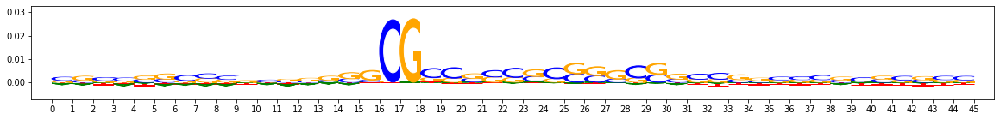

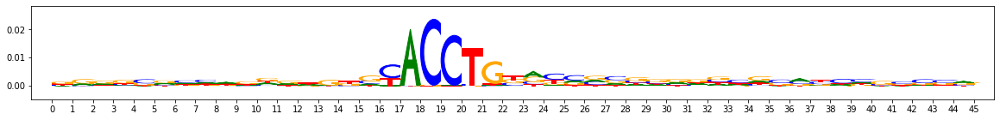

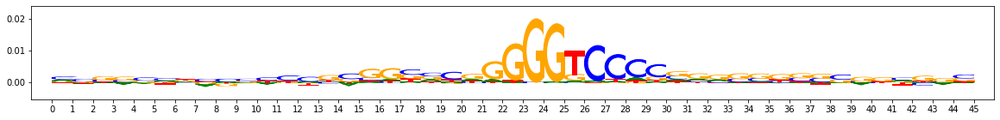

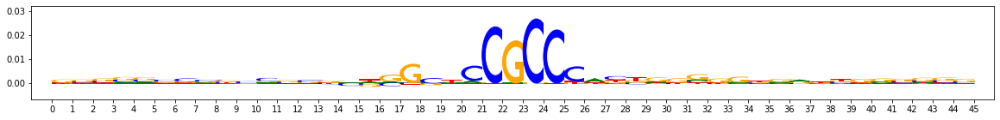

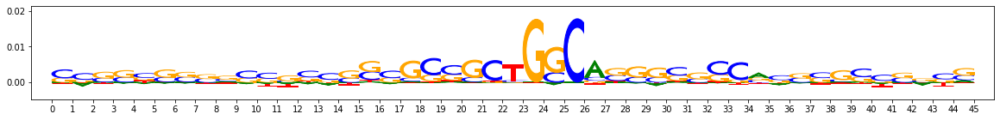

...

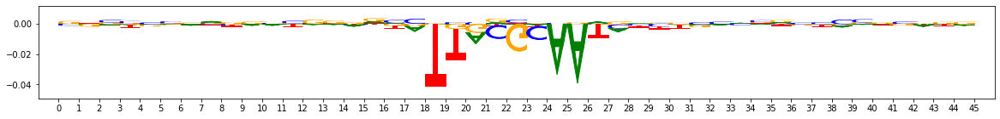

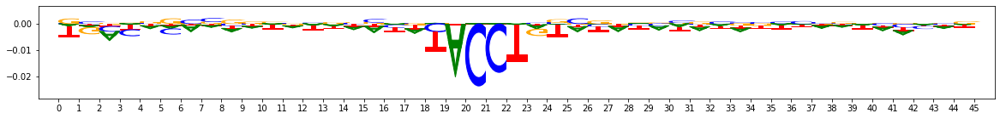

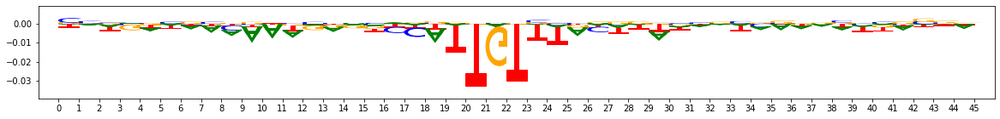

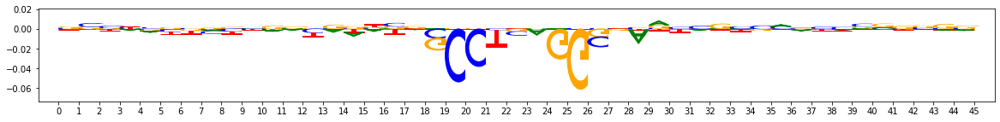

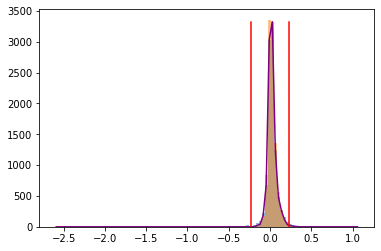

Got 10703 coords
After resolving overlaps, got 10703 seqlets
Across all tasks, the weakest transformed threshold used was: 0.9698999542638654
MEMORY 13.249318912
10703 identified in total
min_metacluster_size_frac * len(seqlets) = 107 is more than min_metacluster_size=100.
Using it as a new min_metacluster_size
2 activity patterns with support >= 107 out of 3 possible patterns
Metacluster sizes:  [6145, 4558]
Idx to activities:  {0: '1', 1: '-1'}
MEMORY 13.249318912
On metacluster 1
Metacluster size 4558
Relevant tasks:  ('task2',)
Relevant signs:  (-1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 4558
(Round 1) Computing coarse affmat
MEMORY 13.249318912
Beginning embedding computation
Computing embeddings
Finished embedding computation in 2.34 s
Starting affinity matrix computations
Normalization computed in 0.04 s
Cosine similarity mat computed in 0.16 s
Normalization computed in 0.06 s
Cosine similarity mat computed in 0.21 s
Finished affinity matrix computa

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8409807283602245


  2%|▏         | 1/50 [00:00<00:39,  1.26it/s]

Quality: 0.8411578249633862


 22%|██▏       | 11/50 [00:08<00:28,  1.35it/s]

Quality: 0.8412504760448055


 40%|████      | 20/50 [00:13<00:19,  1.56it/s]

Quality: 0.8414030428348644


100%|██████████| 50/50 [00:34<00:00,  1.45it/s]

Got 19 clusters after round 1
Counts:
{0: 652, 3: 202, 10: 143, 13: 100, 4: 198, 11: 134, 7: 158, 9: 145, 12: 129, 14: 92, 16: 72, 5: 191, 8: 154, 2: 216, 17: 59, 6: 178, 1: 385, 15: 86, 18: 49}
MEMORY 13.25293568
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.25293568
Aggregating for cluster 0 with 652 seqlets
MEMORY 13.25293568


Trimmed 61 out of 652
Skipped 10 seqlets
Removed 24 duplicate seqlets
Aggregating for cluster 1 with 385 seqlets
MEMORY 13.25293568
Trimmed 61 out of 385
Aggregating for cluster 2 with 216 seqlets
MEMORY 13.25293568
Trimmed 5 out of 216
Removed 1 duplicate seqlets
Aggregating for cluster 3 with 202 seqlets
MEMORY 13.25293568
Trimmed 19 out of 202
Skipped 1 seqlets
Aggregating for cluster 4 with 198 seqlets
MEMORY 13.25293568
Trimmed 89 out of 198
Aggregating for cluster 5 with 191 seqlets
MEMORY 13.25293568
Trimmed 2 out of 191
Removed 1 duplicate seqlets
Aggregating for cluster 6 with 178 seqlets
MEMORY 13.25293568
Trimmed 15 out of 178
Aggregating for cluster 7 with 158 seqlets
MEMORY 13.25293568
Trimmed 16 out of 158
Aggregating for cluster 8 with 154 seqlets
MEMORY 13.25293568
Trimmed 22 out of 154
Aggregating for cluster 9 with 145 seqlets
MEMORY 13.25293568
Trimmed 8 out of 145
Removed 2 duplicate seqlets
Aggregating for cluster 10 with 143 seqlets
MEMORY 13.25293568
Trimmed 11 o

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8433860845534219


  2%|▏         | 1/50 [00:00<00:20,  2.41it/s]

Quality: 0.8435914216989745


 10%|█         | 5/50 [00:02<00:21,  2.07it/s]

Quality: 0.843599138804432


 20%|██        | 10/50 [00:05<00:22,  1.75it/s]

Quality: 0.8440226960661269


100%|██████████| 50/50 [00:25<00:00,  1.97it/s]

Got 18 clusters after round 2
Counts:
{0: 630, 10: 117, 3: 184, 1: 314, 7: 138, 2: 216, 9: 132, 5: 161, 17: 44, 4: 184, 13: 90, 12: 105, 6: 139, 11: 111, 16: 49, 14: 83, 8: 136, 15: 78}
MEMORY 13.252943872
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.252943872
Aggregating for cluster 0 with 630 seqlets
MEMORY 13.252943872


Trimmed 13 out of 630
Removed 1 duplicate seqlets
Aggregating for cluster 1 with 314 seqlets
MEMORY 13.252943872
Trimmed 9 out of 314
Removed 2 duplicate seqlets
Aggregating for cluster 2 with 216 seqlets
MEMORY 13.252943872
Trimmed 7 out of 216
Aggregating for cluster 3 with 184 seqlets
MEMORY 13.252943872
Trimmed 27 out of 184
Aggregating for cluster 4 with 184 seqlets
MEMORY 13.252943872
Trimmed 8 out of 184
Aggregating for cluster 5 with 161 seqlets
MEMORY 13.252943872
Trimmed 35 out of 161
Aggregating for cluster 6 with 139 seqlets
MEMORY 13.252943872
Trimmed 11 out of 139
Aggregating for cluster 7 with 138 seqlets
MEMORY 13.252943872
Trimmed 17 out of 138
Aggregating for cluster 8 with 136 seqlets
MEMORY 13.252943872
Trimmed 4 out of 136
Aggregating for cluster 9 with 132 seqlets
MEMORY 13.252943872
Trimmed 23 out of 132
Aggregating for cluster 10 with 117 seqlets
MEMORY 13.252943872
Trimmed 14 out of 117
Aggregating for cluster 11 with 111 seqlets
MEMORY 13.252943872
Trimmed 3 o

Performing seqlet reassignment
MEMORY 13.2528128
Cross contin jaccard time taken: 0.01 s
Cross contin jaccard time taken: 0.01 s
Discarded 30 seqlets
Got 17 patterns after reassignment
MEMORY 13.2528128
Total time taken is 234.5s
MEMORY 13.2528128
On metacluster 0
Metacluster size 6145
Relevant tasks:  ('task2',)
Relevant signs:  (1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 6145
(Round 1) Computing coarse affmat
MEMORY 13.2528128
Beginning embedding computation
Computing embeddings
Finished embedding computation in 2.44 s
Starting affinity matrix computations
Normalization computed in 0.06 s
Cosine similarity mat computed in 0.29 s
Normalization computed in 0.09 s
Cosine similarity mat computed in 0.35 s
Finished affinity matrix computations in 0.79 s
(Round 1) Compute nearest neighbors from coarse affmat
MEMORY 13.348073472
Computed nearest neighbors in 2.56 s
MEMORY 13.348073472
(Round 1) Computing affinity matrix on nearest neighbors
MEMORY 13.348073472
L

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.6980412481614623


  2%|▏         | 1/50 [00:01<00:49,  1.02s/it]

Quality: 0.7008490984755271


 10%|█         | 5/50 [00:05<00:51,  1.14s/it]

Quality: 0.7013998134018428


 46%|████▌     | 23/50 [00:23<00:26,  1.03it/s]

Quality: 0.7019747342047036


 54%|█████▍    | 27/50 [00:27<00:21,  1.06it/s]

Quality: 0.702362085616497


100%|██████████| 50/50 [00:50<00:00,  1.02s/it]

Got 14 clusters after round 1
Counts:
{12: 39, 0: 383, 7: 166, 1: 339, 2: 311, 4: 295, 3: 311, 5: 256, 6: 173, 9: 109, 8: 149, 11: 73, 13: 21, 10: 95}
MEMORY 13.204365312
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.204365312
Aggregating for cluster 0 with 383 seqlets
MEMORY 13.204365312


Trimmed 33 out of 383
Aggregating for cluster 1 with 339 seqlets
MEMORY 13.204365312
Trimmed 11 out of 339
Aggregating for cluster 2 with 311 seqlets
MEMORY 13.204365312
Trimmed 14 out of 311
Aggregating for cluster 3 with 311 seqlets
MEMORY 13.204365312
Trimmed 21 out of 311
Aggregating for cluster 4 with 295 seqlets
MEMORY 13.204365312
Trimmed 12 out of 295
Aggregating for cluster 5 with 256 seqlets
MEMORY 13.204365312
Trimmed 26 out of 256
Aggregating for cluster 6 with 173 seqlets
MEMORY 13.204365312
Trimmed 8 out of 173
Aggregating for cluster 7 with 166 seqlets
MEMORY 13.204365312
Trimmed 20 out of 166
Aggregating for cluster 8 with 149 seqlets
MEMORY 13.204365312
Trimmed 3 out of 149
Aggregating for cluster 9 with 109 seqlets
MEMORY 13.204365312
Trimmed 26 out of 109
Aggregating for cluster 10 with 95 seqlets
MEMORY 13.204365312
Trimmed 20 out of 95
Aggregating for cluster 11 with 73 seqlets
MEMORY 13.204365312
Trimmed 2 out of 73
Aggregating for cluster 12 with 39 seqlets
MEMOR

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.6758035881126693


  2%|▏         | 1/50 [00:01<01:10,  1.44s/it]

Quality: 0.6763791056709971


  6%|▌         | 3/50 [00:02<00:48,  1.04s/it]

Quality: 0.6768181008039225


 10%|█         | 5/50 [00:04<00:43,  1.04it/s]

Quality: 0.6769327614452848


 12%|█▏        | 6/50 [00:05<00:42,  1.04it/s]

Quality: 0.6773131805652928


 22%|██▏       | 11/50 [00:10<00:37,  1.04it/s]

Quality: 0.6774114496563115


 26%|██▌       | 13/50 [00:11<00:34,  1.08it/s]

Quality: 0.6777365131328397


 34%|███▍      | 17/50 [00:15<00:27,  1.18it/s]

Quality: 0.6778513421659547


 50%|█████     | 25/50 [00:21<00:20,  1.22it/s]

Quality: 0.6782602470808569


 98%|█████████▊| 49/50 [00:42<00:00,  1.30it/s]

Quality: 0.6785852889714006


100%|██████████| 50/50 [00:43<00:00,  1.15it/s]

Got 18 clusters after round 2
Counts:
{1: 328, 15: 52, 7: 135, 4: 210, 8: 122, 11: 86, 2: 272, 3: 258, 5: 144, 14: 52, 10: 91, 6: 136, 9: 105, 13: 71, 17: 11, 0: 356, 16: 13, 12: 78}
MEMORY 13.247770624
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.247770624
Aggregating for cluster 0 with 356 seqlets
MEMORY 13.247770624


Trimmed 26 out of 356
Aggregating for cluster 1 with 328 seqlets
MEMORY 13.247770624
Trimmed 10 out of 328
Aggregating for cluster 2 with 272 seqlets
MEMORY 13.247770624
Trimmed 45 out of 272
Removed 3 duplicate seqlets
Dropping cluster 2 with 224 seqlets due to sign disagreement
Aggregating for cluster 3 with 258 seqlets
MEMORY 13.247770624
Trimmed 24 out of 258
Aggregating for cluster 4 with 210 seqlets
MEMORY 13.247770624
Trimmed 45 out of 210
Aggregating for cluster 5 with 144 seqlets
MEMORY 13.247770624
Trimmed 40 out of 144
Aggregating for cluster 6 with 136 seqlets
MEMORY 13.247770624
Trimmed 14 out of 136
Aggregating for cluster 7 with 135 seqlets
MEMORY 13.247770624
Trimmed 26 out of 135
Aggregating for cluster 8 with 122 seqlets
MEMORY 13.247770624
Trimmed 38 out of 122
Aggregating for cluster 9 with 105 seqlets
MEMORY 13.247770624
Trimmed 16 out of 105
Aggregating for cluster 10 with 91 seqlets
MEMORY 13.247770624
Trimmed 16 out of 91
Aggregating for cluster 11 with 86 seqle

Louvain completed 21 runs in 2.241283893585205 seconds
Similarity is 0.61929846; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.003200531005859375 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.012185
Louvain completed 21 runs in 2.1984949111938477 seconds
Similarity is 0.894183; is_dissimilar is False
Got 4 subclusters
Inspecting for spurious merging
Wrote graph to binary file in 0.01234745979309082 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00546031
Louvain completed 21 runs in 2.2163383960723877 seconds
Similarity is 0.87830037; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.006797075271606445 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00498035
After 2 runs, maximum modularity is Q = 0.00704593
Louvain completed 22 runs in 2.4295170307159424 seconds
Similarity is 0.84895

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 7 with 128 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 8 with 121 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 9 with 109 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 10 with 108 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 11 with 103 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 12 with 98 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 13 with 83 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 14 with 60 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 15 with 48 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 16 with 41 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Running TF-MoDISco for task task3
MEMORY 13.073301504
On task task3
Computing windowed sums on original
Generating null dist
peak(mu)= 0.0011352714961394665
Computing threshold
Thresholds from null dist were -0.08597654104232788  and  0.19632375240325928
Final raw thresholds are -0.08597654104232788  and  0.19632375240325928
Final transformed thresholds are -0.8941785959223635  and  0.9715188262921038


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


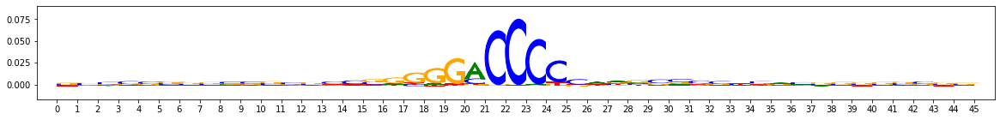

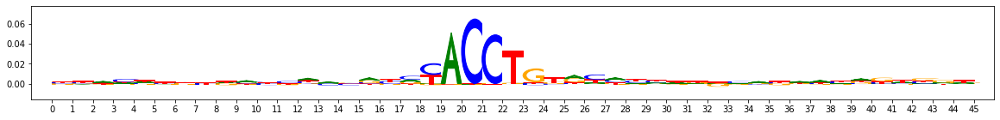

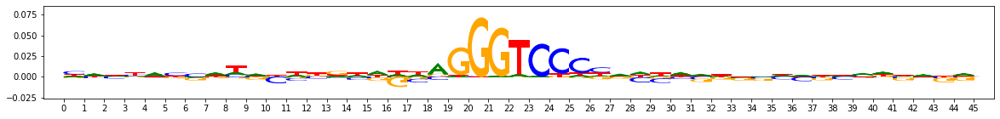

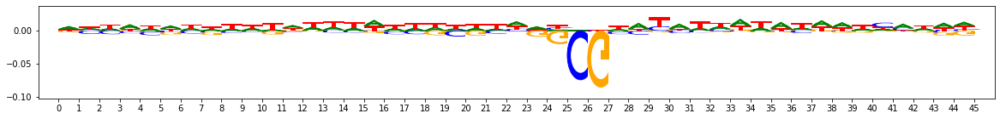

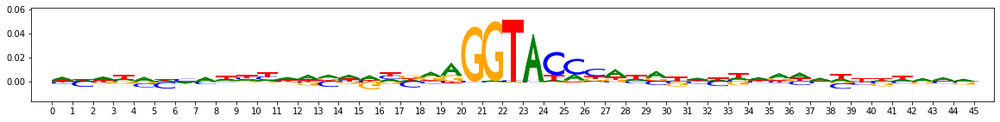

...

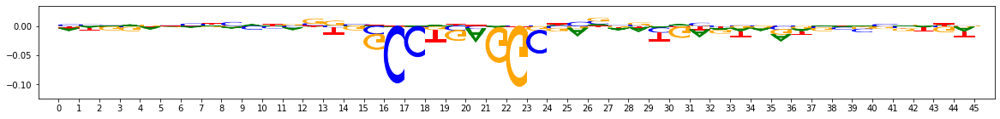

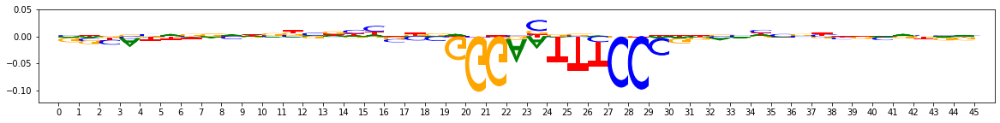

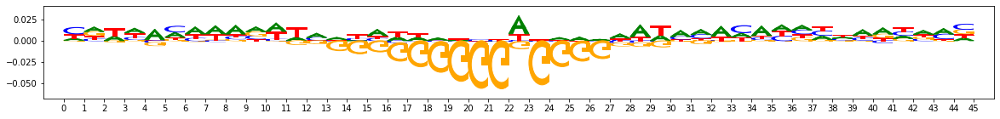

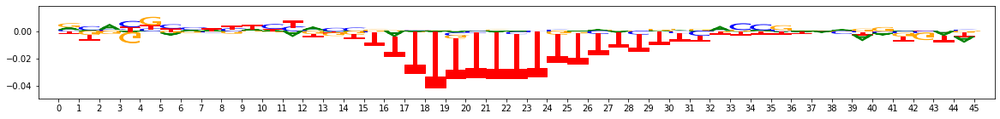

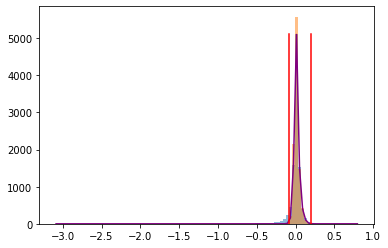

Got 9659 coords
After resolving overlaps, got 9659 seqlets
Across all tasks, the weakest transformed threshold used was: 0.8940785959223635
MEMORY 13.171654656
9659 identified in total
2 activity patterns with support >= 100 out of 3 possible patterns
Metacluster sizes:  [8670, 989]
Idx to activities:  {0: '-1', 1: '1'}
MEMORY 13.171654656
On metacluster 1
Metacluster size 989
Relevant tasks:  ('task3',)
Relevant signs:  (1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 989
(Round 1) Computing coarse affmat
MEMORY 13.171654656
Beginning embedding computation
Computing embeddings
Finished embedding computation in 1.97 s
Starting affinity matrix computations
Normalization computed in 0.01 s
Cosine similarity mat computed in 0.02 s
Normalization computed in 0.01 s
Cosine similarity mat computed in 0.03 s
Finished affinity matrix computations in 0.05 s
(Round 1) Compute nearest neighbors from coarse affmat
MEMORY 13.171716096
Computed nearest neighbors in 0.15 s
MEMO

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.6341566175191067


 22%|██▏       | 11/50 [00:01<00:06,  6.13it/s]

Quality: 0.6342632095469061


 36%|███▌      | 18/50 [00:03<00:05,  6.09it/s]

Quality: 0.6343236610936952


 90%|█████████ | 45/50 [00:07<00:00,  6.61it/s]

Quality: 0.6343389296308828


100%|██████████| 50/50 [00:08<00:00,  6.18it/s]

Got 16 clusters after round 1
Counts:
{6: 41, 1: 106, 2: 82, 0: 196, 15: 5, 3: 74, 5: 42, 8: 25, 4: 46, 10: 18, 7: 32, 11: 16, 14: 7, 9: 18, 12: 15, 13: 12}
MEMORY 13.171789824
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.171789824
Aggregating for cluster 0 with 196 seqlets
MEMORY 13.171789824


Trimmed 11 out of 196
Skipped 1 seqlets
Aggregating for cluster 1 with 106 seqlets
MEMORY 13.171789824
Trimmed 19 out of 106
Removed 1 duplicate seqlets
Aggregating for cluster 2 with 82 seqlets
MEMORY 13.171789824
Trimmed 1 out of 82
Removed 1 duplicate seqlets
Aggregating for cluster 3 with 74 seqlets
MEMORY 13.171789824
Trimmed 0 out of 74
Removed 2 duplicate seqlets
Aggregating for cluster 4 with 46 seqlets
MEMORY 13.171789824
Trimmed 8 out of 46
Aggregating for cluster 5 with 42 seqlets
MEMORY 13.171789824
Trimmed 0 out of 42
Dropping cluster 5 with 42 seqlets due to sign disagreement
Aggregating for cluster 6 with 41 seqlets
MEMORY 13.171789824
Trimmed 6 out of 41
Dropping cluster 6 with 35 seqlets due to sign disagreement
Aggregating for cluster 7 with 32 seqlets
MEMORY 13.171789824
Trimmed 4 out of 32
Aggregating for cluster 8 with 25 seqlets
MEMORY 13.171789824
Trimmed 6 out of 25
Aggregating for cluster 9 with 18 seqlets
MEMORY 13.171789824
Trimmed 0 out of 18
Aggregating for

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.664491903659106


  2%|▏         | 1/50 [00:00<00:05,  8.21it/s]

Quality: 0.6647880844707441


  4%|▍         | 2/50 [00:00<00:06,  7.92it/s]

Quality: 0.6649535038083279


 36%|███▌      | 18/50 [00:02<00:03,  8.75it/s]

Quality: 0.6649622345438906


100%|██████████| 50/50 [00:06<00:00,  8.24it/s]

Got 13 clusters after round 2
Counts:
{0: 133, 3: 73, 2: 83, 8: 28, 4: 66, 1: 113, 5: 40, 10: 18, 6: 38, 12: 10, 9: 28, 7: 29, 11: 16}
MEMORY 13.171781632
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.171781632
Aggregating for cluster 0 with 133 seqlets
MEMORY 13.171781632


Trimmed 8 out of 133
Aggregating for cluster 1 with 113 seqlets
MEMORY 13.171781632
Trimmed 24 out of 113
Aggregating for cluster 2 with 83 seqlets
MEMORY 13.171781632
Trimmed 18 out of 83
Aggregating for cluster 3 with 73 seqlets
MEMORY 13.171781632
Trimmed 25 out of 73
Aggregating for cluster 4 with 66 seqlets
MEMORY 13.171781632
Trimmed 6 out of 66
Dropping cluster 4 with 60 seqlets due to sign disagreement
Aggregating for cluster 5 with 40 seqlets
MEMORY 13.171781632
Trimmed 18 out of 40
Removed 1 duplicate seqlets
Dropping cluster 5 with 21 seqlets due to sign disagreement
Aggregating for cluster 6 with 38 seqlets
MEMORY 13.171781632
Trimmed 13 out of 38
Aggregating for cluster 7 with 29 seqlets
MEMORY 13.171781632
Trimmed 1 out of 29
Aggregating for cluster 8 with 28 seqlets
MEMORY 13.171781632
Trimmed 11 out of 28
Dropping cluster 8 with 17 seqlets due to sign disagreement
Aggregating for cluster 9 with 28 seqlets
MEMORY 13.171781632
Trimmed 7 out of 28
Aggregating for cluster 1

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8185464423610475


  2%|▏         | 1/50 [00:01<01:02,  1.27s/it]

Quality: 0.8187381650367187


 72%|███████▏  | 36/50 [00:52<00:17,  1.23s/it]

Quality: 0.8187472893506483


100%|██████████| 50/50 [01:15<00:00,  1.52s/it]

Got 22 clusters after round 1
Counts:
{2: 603, 4: 358, 16: 80, 9: 202, 5: 269, 8: 231, 11: 178, 21: 4, 17: 79, 7: 251, 14: 148, 10: 195, 0: 686, 12: 172, 6: 266, 18: 66, 13: 170, 19: 63, 1: 653, 15: 89, 3: 419, 20: 17}
MEMORY 13.131423744
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.131423744
Aggregating for cluster 0 with 686 seqlets
MEMORY 13.131423744


Trimmed 22 out of 686
Skipped 1 seqlets
Removed 2 duplicate seqlets
Aggregating for cluster 1 with 653 seqlets
MEMORY 13.131423744
Trimmed 110 out of 653
Skipped 1 seqlets
Aggregating for cluster 2 with 603 seqlets
MEMORY 13.131423744
Trimmed 38 out of 603
Skipped 5 seqlets
Removed 19 duplicate seqlets
Aggregating for cluster 3 with 419 seqlets
MEMORY 13.131423744
Trimmed 32 out of 419
Skipped 1 seqlets
Removed 1 duplicate seqlets
Aggregating for cluster 4 with 358 seqlets
MEMORY 13.131423744
Trimmed 2 out of 358
Skipped 1 seqlets
Removed 27 duplicate seqlets
Aggregating for cluster 5 with 269 seqlets
MEMORY 13.131423744
Trimmed 29 out of 269
Aggregating for cluster 6 with 266 seqlets
MEMORY 13.131423744
Trimmed 21 out of 266
Aggregating for cluster 7 with 251 seqlets
MEMORY 13.131423744
Trimmed 8 out of 251
Skipped 1 seqlets
Removed 2 duplicate seqlets
Aggregating for cluster 8 with 231 seqlets
MEMORY 13.131423744
Trimmed 22 out of 231
Aggregating for cluster 9 with 202 seqlets
MEMORY

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8167171294706891


  6%|▌         | 3/50 [00:04<01:14,  1.58s/it]

Quality: 0.816875188661273


 18%|█▊        | 9/50 [00:13<01:01,  1.51s/it]

Quality: 0.8168796906087459


 20%|██        | 10/50 [00:14<00:56,  1.42s/it]

Quality: 0.8169266790802668


 92%|█████████▏| 46/50 [01:02<00:05,  1.33s/it]

Quality: 0.8169327327562307


100%|██████████| 50/50 [01:07<00:00,  1.35s/it]

Got 19 clusters after round 2
Counts:
{0: 667, 3: 428, 14: 75, 10: 190, 2: 504, 4: 330, 15: 70, 5: 266, 18: 13, 7: 234, 16: 68, 8: 204, 12: 163, 6: 235, 1: 651, 11: 185, 9: 195, 13: 119, 17: 46}
MEMORY 13.13140736
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.13140736
Aggregating for cluster 0 with 667 seqlets
MEMORY 13.13140736


Trimmed 40 out of 667
Removed 1 duplicate seqlets
Aggregating for cluster 1 with 651 seqlets
MEMORY 13.13140736
Trimmed 14 out of 651
Removed 24 duplicate seqlets
Aggregating for cluster 2 with 504 seqlets
MEMORY 13.13140736
Trimmed 48 out of 504
Removed 9 duplicate seqlets
Aggregating for cluster 3 with 428 seqlets
MEMORY 13.13140736
Trimmed 80 out of 428
Aggregating for cluster 4 with 330 seqlets
MEMORY 13.13140736
Trimmed 40 out of 330
Aggregating for cluster 5 with 266 seqlets
MEMORY 13.13140736
Trimmed 21 out of 266
Removed 1 duplicate seqlets
Aggregating for cluster 6 with 235 seqlets
MEMORY 13.13140736
Trimmed 17 out of 235
Aggregating for cluster 7 with 234 seqlets
MEMORY 13.13140736
Trimmed 12 out of 234
Aggregating for cluster 8 with 204 seqlets
MEMORY 13.13140736
Trimmed 17 out of 204
Aggregating for cluster 9 with 195 seqlets
MEMORY 13.13140736
Trimmed 41 out of 195
Aggregating for cluster 10 with 190 seqlets
MEMORY 13.13140736
Trimmed 28 out of 190
Aggregating for cluster 

After 1 runs, maximum modularity is Q = 0.00259739
After 2 runs, maximum modularity is Q = 0.0027776
Louvain completed 22 runs in 2.4271748065948486 seconds
Similarity is 0.91015095; is_dissimilar is False
Got 3 subclusters
Inspecting for spurious merging
Wrote graph to binary file in 0.012397289276123047 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00806627
Louvain completed 21 runs in 2.2402713298797607 seconds
Similarity is 0.9232508; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.01337575912475586 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00574105
After 3 runs, maximum modularity is Q = 0.005793
After 8 runs, maximum modularity is Q = 0.00582572
Louvain completed 28 runs in 3.148456573486328 seconds
Similarity is 0.9844031; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.003335714340209961 seconds
Running Louvain

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 1 with 70 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 2 with 73 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Running TF-MoDISco for task task4
MEMORY 13.074522112
On task task4
Computing windowed sums on original
Generating null dist
peak(mu)= -0.00041786208748817444
Computing threshold
Thresholds from null dist were -0.10872578620910645  and  0.12238219380378723
Final raw thresholds are -0.10872578620910645  and  0.12238219380378723
Final transformed thresholds are -0.9652398487075944  and  0.9718862236447885


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


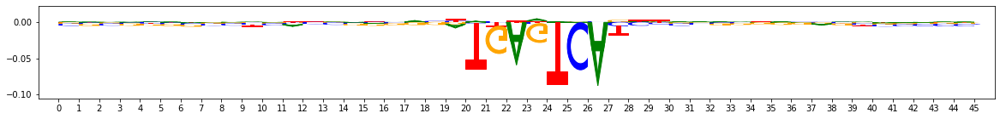

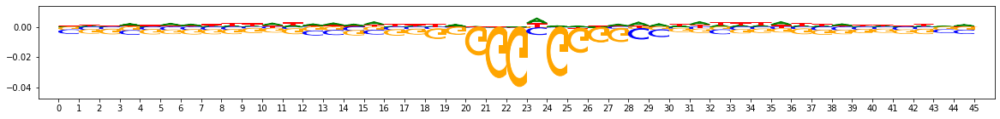

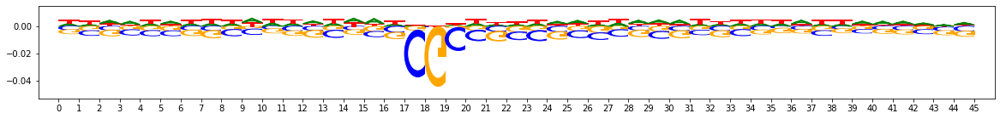

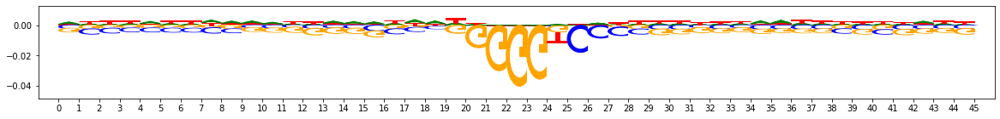

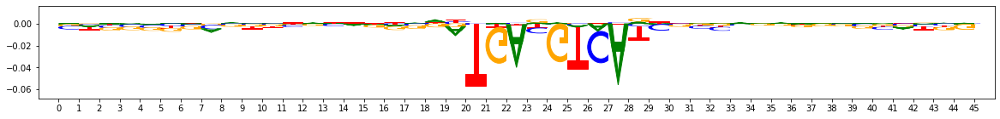

...

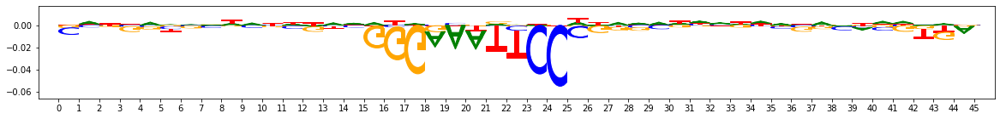

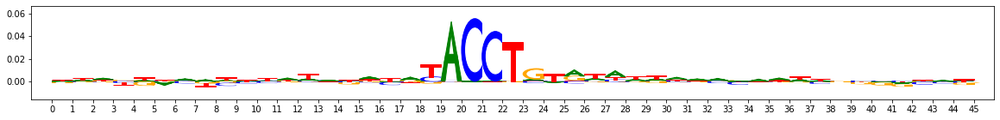

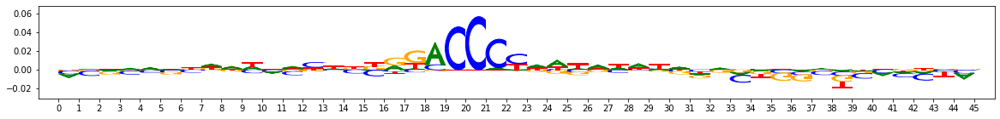

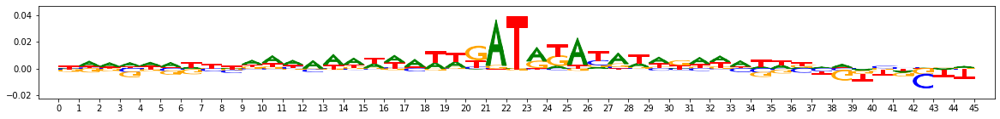

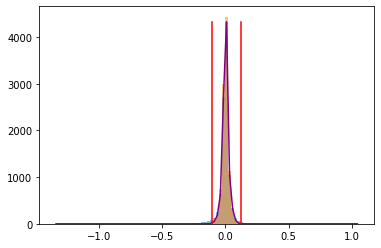

Got 5335 coords
After resolving overlaps, got 5335 seqlets
Across all tasks, the weakest transformed threshold used was: 0.9651398487075944
MEMORY 13.135650816
5335 identified in total
2 activity patterns with support >= 100 out of 3 possible patterns
Metacluster sizes:  [3687, 1648]
Idx to activities:  {0: '-1', 1: '1'}
MEMORY 13.135650816
On metacluster 1
Metacluster size 1648
Relevant tasks:  ('task4',)
Relevant signs:  (1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 1648
(Round 1) Computing coarse affmat
MEMORY 13.135650816
Beginning embedding computation
Computing embeddings
Finished embedding computation in 2.44 s
Starting affinity matrix computations
Normalization computed in 0.02 s
Cosine similarity mat computed in 0.05 s
Normalization computed in 0.02 s
Cosine similarity mat computed in 0.05 s
Finished affinity matrix computations in 0.12 s
(Round 1) Compute nearest neighbors from coarse affmat
MEMORY 13.13570816
Computed nearest neighbors in 0.31 s
ME

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7889341456755773


 10%|█         | 5/50 [00:00<00:08,  5.17it/s]

Quality: 0.7890451483106954


 16%|█▌        | 8/50 [00:01<00:07,  5.36it/s]

Quality: 0.7891176441744802


 20%|██        | 10/50 [00:01<00:08,  4.55it/s]

Quality: 0.7891500427412494


 36%|███▌      | 18/50 [00:03<00:07,  4.42it/s]

Quality: 0.7892373156297826


 60%|██████    | 30/50 [00:06<00:03,  5.08it/s]

Quality: 0.7892969607970016


100%|██████████| 50/50 [00:10<00:00,  4.91it/s]

Got 14 clusters after round 1
Counts:
{0: 275, 10: 34, 2: 185, 13: 11, 11: 14, 3: 180, 5: 85, 4: 88, 1: 195, 6: 65, 9: 39, 8: 41, 7: 45, 12: 13}
MEMORY 13.151707136
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.151707136
Aggregating for cluster 0 with 275 seqlets
MEMORY 13.151707136


Trimmed 30 out of 275
Removed 6 duplicate seqlets
Aggregating for cluster 1 with 195 seqlets
MEMORY 13.151707136
Trimmed 5 out of 195
Aggregating for cluster 2 with 185 seqlets
MEMORY 13.151707136
Trimmed 5 out of 185
Aggregating for cluster 3 with 180 seqlets
MEMORY 13.151707136
Trimmed 5 out of 180
Aggregating for cluster 4 with 88 seqlets
MEMORY 13.151707136
Trimmed 7 out of 88
Aggregating for cluster 5 with 85 seqlets
MEMORY 13.151707136
Trimmed 4 out of 85
Aggregating for cluster 6 with 65 seqlets
MEMORY 13.151707136
Trimmed 5 out of 65
Aggregating for cluster 7 with 45 seqlets
MEMORY 13.151707136
Trimmed 4 out of 45
Aggregating for cluster 8 with 41 seqlets
MEMORY 13.151707136
Trimmed 0 out of 41
Aggregating for cluster 9 with 39 seqlets
MEMORY 13.151707136
Trimmed 0 out of 39
Aggregating for cluster 10 with 34 seqlets
MEMORY 13.151707136
Trimmed 6 out of 34
Aggregating for cluster 11 with 14 seqlets
MEMORY 13.151707136
Trimmed 1 out of 14
Dropping cluster 11 with 13 seqlets due 

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7978613734703366


100%|██████████| 50/50 [00:09<00:00,  5.36it/s]

Got 14 clusters after round 2
Counts:
{0: 253, 12: 25, 6: 61, 8: 39, 1: 189, 3: 153, 9: 35, 10: 28, 2: 160, 5: 80, 7: 43, 4: 85, 11: 27, 13: 13}
MEMORY 13.151715328
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.151715328
Aggregating for cluster 0 with 253 seqlets
MEMORY 13.151715328


Trimmed 53 out of 253
Aggregating for cluster 1 with 189 seqlets
MEMORY 13.151715328
Trimmed 1 out of 189
Aggregating for cluster 2 with 160 seqlets
MEMORY 13.151715328
Trimmed 49 out of 160
Removed 6 duplicate seqlets
Aggregating for cluster 3 with 153 seqlets
MEMORY 13.151715328
Trimmed 35 out of 153
Aggregating for cluster 4 with 85 seqlets
MEMORY 13.151715328
Trimmed 4 out of 85
Aggregating for cluster 5 with 80 seqlets
MEMORY 13.151715328
Trimmed 12 out of 80
Aggregating for cluster 6 with 61 seqlets
MEMORY 13.151715328
Trimmed 4 out of 61
Aggregating for cluster 7 with 43 seqlets
MEMORY 13.151715328
Trimmed 1 out of 43
Aggregating for cluster 8 with 39 seqlets
MEMORY 13.151715328
Trimmed 2 out of 39
Aggregating for cluster 9 with 35 seqlets
MEMORY 13.151715328
Trimmed 8 out of 35
Dropping cluster 9 with 27 seqlets due to sign disagreement
Aggregating for cluster 10 with 28 seqlets
MEMORY 13.151715328
Trimmed 0 out of 28
Removed 1 duplicate seqlets
Dropping cluster 10 with 27 seql

Launching nearest neighbors affmat calculation job
MEMORY 13.318361088
Parallel runs completed
MEMORY 13.318336512
Job completed in: 21.88 s
MEMORY 13.427277824
(Round 1) Computed affinity matrix on nearest neighbors in 44.46 s
MEMORY 13.318586368
Filtered down to 2346 of 3687
(Round 1) Retained 2346 rows out of 3687 after filtering
MEMORY 13.318586368
(Round 1) Computing density adapted affmat
MEMORY 13.155454976
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 2346 samples in 0.005s...
[t-SNE] Computed neighbors for 2346 samples in 0.041s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2346
[t-SNE] Computed conditional probabilities for sample 2000 / 2346
[t-SNE] Computed conditional probabilities for sample 2346 / 2346
[t-SNE] Mean sigma: 0.245369
(Round 1) Computing clustering
MEMORY 13.155454976
Beginning preprocessing + Leiden


  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7934729567480796


 54%|█████▍    | 27/50 [00:14<00:11,  2.06it/s]

Quality: 0.7934871742947185


100%|██████████| 50/50 [00:26<00:00,  1.92it/s]

Got 17 clusters after round 1
Counts:
{3: 190, 14: 27, 0: 438, 6: 119, 7: 109, 5: 167, 10: 87, 12: 69, 1: 372, 2: 225, 4: 177, 11: 70, 9: 93, 8: 104, 13: 56, 15: 22, 16: 21}
MEMORY 13.16880384
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.16880384
Aggregating for cluster 0 with 438 seqlets
MEMORY 13.16880384


Trimmed 92 out of 438
Aggregating for cluster 1 with 372 seqlets
MEMORY 13.16880384
Trimmed 15 out of 372
Aggregating for cluster 2 with 225 seqlets
MEMORY 13.16880384
Trimmed 12 out of 225
Removed 1 duplicate seqlets
Aggregating for cluster 3 with 190 seqlets
MEMORY 13.16880384
Trimmed 29 out of 190
Aggregating for cluster 4 with 177 seqlets
MEMORY 13.16880384
Trimmed 6 out of 177
Removed 2 duplicate seqlets
Aggregating for cluster 5 with 167 seqlets
MEMORY 13.16880384
Trimmed 6 out of 167
Aggregating for cluster 6 with 119 seqlets
MEMORY 13.16880384
Trimmed 6 out of 119
Aggregating for cluster 7 with 109 seqlets
MEMORY 13.16880384
Trimmed 5 out of 109
Aggregating for cluster 8 with 104 seqlets
MEMORY 13.16880384
Trimmed 7 out of 104
Aggregating for cluster 9 with 93 seqlets
MEMORY 13.16880384
Trimmed 1 out of 93
Removed 2 duplicate seqlets
Aggregating for cluster 10 with 87 seqlets
MEMORY 13.16880384
Trimmed 6 out of 87
Aggregating for cluster 11 with 70 seqlets
MEMORY 13.16880384
Tr

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7994835551067885


  8%|▊         | 4/50 [00:02<00:26,  1.73it/s]

Quality: 0.7999762309043882


100%|██████████| 50/50 [00:22<00:00,  2.19it/s]

Got 17 clusters after round 2
Counts:
{1: 307, 7: 106, 2: 211, 5: 159, 10: 77, 4: 173, 13: 31, 6: 114, 0: 350, 15: 27, 3: 204, 8: 99, 9: 84, 14: 29, 11: 66, 12: 46, 16: 18}
MEMORY 13.168795648
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.168795648
Aggregating for cluster 0 with 350 seqlets
MEMORY 13.168795648


Trimmed 12 out of 350
Aggregating for cluster 1 with 307 seqlets
MEMORY 13.168795648
Trimmed 6 out of 307
Aggregating for cluster 2 with 211 seqlets
MEMORY 13.168795648
Trimmed 88 out of 211
Aggregating for cluster 3 with 204 seqlets
MEMORY 13.168795648
Trimmed 37 out of 204
Aggregating for cluster 4 with 173 seqlets
MEMORY 13.168795648
Trimmed 36 out of 173
Aggregating for cluster 5 with 159 seqlets
MEMORY 13.168795648
Trimmed 18 out of 159
Aggregating for cluster 6 with 114 seqlets
MEMORY 13.168795648
Trimmed 7 out of 114
Aggregating for cluster 7 with 106 seqlets
MEMORY 13.168795648
Trimmed 9 out of 106
Aggregating for cluster 8 with 99 seqlets
MEMORY 13.168795648
Trimmed 8 out of 99
Removed 2 duplicate seqlets
Aggregating for cluster 9 with 84 seqlets
MEMORY 13.168795648
Trimmed 12 out of 84
Aggregating for cluster 10 with 77 seqlets
MEMORY 13.168795648
Trimmed 8 out of 77
Aggregating for cluster 11 with 66 seqlets
MEMORY 13.168795648
Trimmed 5 out of 66
Aggregating for cluster 12 

Got 2 subclusters
Inspecting for spurious merging
Wrote graph to binary file in 0.0035521984100341797 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00385081
After 2 runs, maximum modularity is Q = 0.00389127
After 6 runs, maximum modularity is Q = 0.00396744
After 13 runs, maximum modularity is Q = 0.0040504
Louvain completed 33 runs in 3.9124972820281982 seconds
Similarity is 0.9245071; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.0022382736206054688 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00384944
After 2 runs, maximum modularity is Q = 0.00384945
Louvain completed 22 runs in 2.5565223693847656 seconds
Similarity is 0.97375846; is_dissimilar is False
Merging on 23 clusters
MEMORY 13.168644096
On merging iteration 1
Computing pattern to seqlet distances
Computing pattern to pattern distances
Got 23 patterns after merging
MEMORY 13.168676864
Performing

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 4 with 69 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 5 with 60 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 6 with 80 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 7 with 47 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 8 with 38 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Running TF-MoDISco for task task5
MEMORY 13.044563968
On task task5
Computing windowed sums on original
Generating null dist
peak(mu)= 0.0003906263411045074
Computing threshold
Thresholds from null dist were -0.04553020000457764  and  0.06487854570150375
Passing windows frac was 0.02513253433182042 , which is below  0.03 ; adjusting
Final raw thresholds are -0.047896055355668085  and  0.047896055355668085
Final transformed thresholds are -0.9699977226868058  and  0.9699977226868058


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


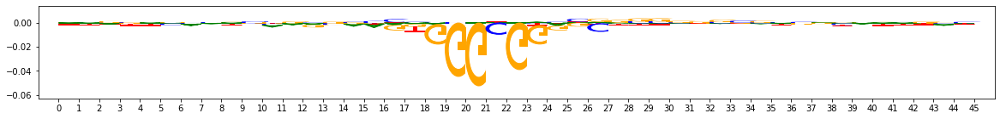

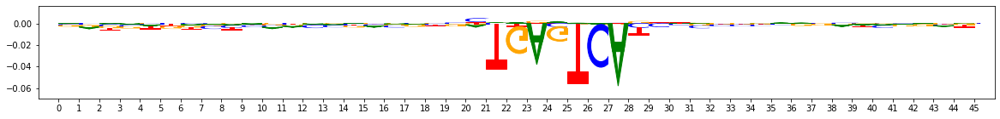

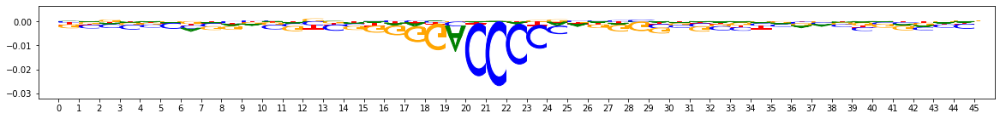

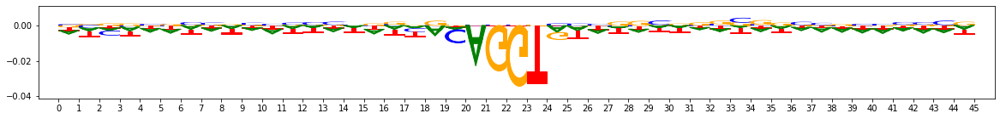

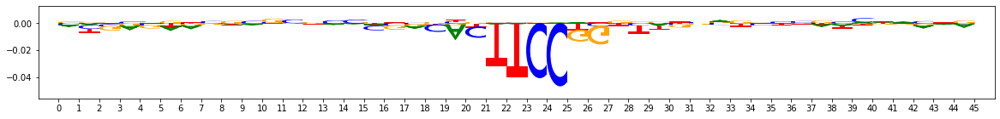

...

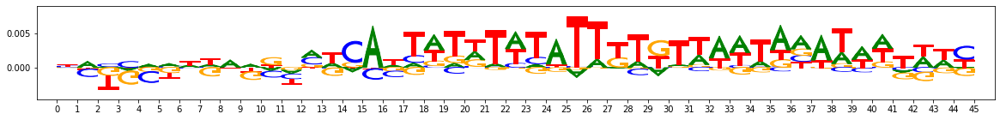

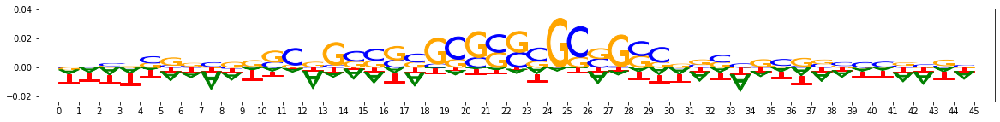

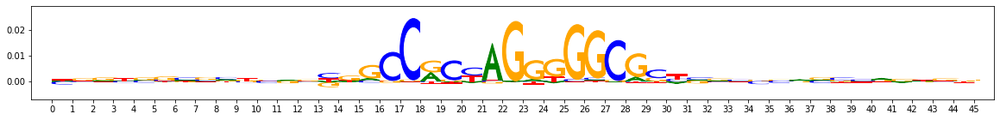

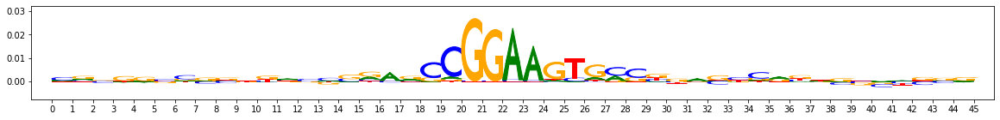

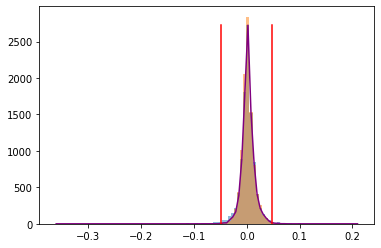

Got 1134 coords
After resolving overlaps, got 1134 seqlets
Across all tasks, the weakest transformed threshold used was: 0.9698977226868059
MEMORY 13.044563968
1134 identified in total
2 activity patterns with support >= 100 out of 3 possible patterns
Metacluster sizes:  [644, 490]
Idx to activities:  {0: '-1', 1: '1'}
MEMORY 13.044563968
On metacluster 1
Metacluster size 490
Relevant tasks:  ('task5',)
Relevant signs:  (1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 490
(Round 1) Computing coarse affmat
MEMORY 13.043515392
Beginning embedding computation
Computing embeddings
Finished embedding computation in 1.85 s
Starting affinity matrix computations
Normalization computed in 0.0 s
Cosine similarity mat computed in 0.01 s
Normalization computed in 0.0 s
Cosine similarity mat computed in 0.01 s
Finished affinity matrix computations in 0.02 s
(Round 1) Compute nearest neighbors from coarse affmat
MEMORY 13.064126464
Computed nearest neighbors in 0.04 s
MEMORY 

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7434973245286804
Quality: 0.7436588149466522


100%|██████████| 50/50 [00:02<00:00, 19.05it/s]

Got 12 clusters after round 1
Counts:
{4: 48, 9: 15, 3: 48, 7: 28, 2: 56, 1: 75, 8: 17, 0: 81, 6: 35, 10: 15, 11: 11, 5: 43}
MEMORY 13.064200192
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.064200192
Aggregating for cluster 0 with 81 seqlets
MEMORY 13.064200192


Trimmed 0 out of 81
Aggregating for cluster 1 with 75 seqlets
MEMORY 13.064200192
Trimmed 17 out of 75
Aggregating for cluster 2 with 56 seqlets
MEMORY 13.064200192
Trimmed 6 out of 56
Aggregating for cluster 3 with 48 seqlets
MEMORY 13.064200192
Trimmed 12 out of 48
Aggregating for cluster 4 with 48 seqlets
MEMORY 13.064200192
Trimmed 2 out of 48
Aggregating for cluster 5 with 43 seqlets
MEMORY 13.064200192
Trimmed 4 out of 43
Aggregating for cluster 6 with 35 seqlets
MEMORY 13.064200192
Trimmed 0 out of 35
Aggregating for cluster 7 with 28 seqlets
MEMORY 13.064200192
Trimmed 3 out of 28
Removed 3 duplicate seqlets
Aggregating for cluster 8 with 17 seqlets
MEMORY 13.064200192
Trimmed 1 out of 17
Aggregating for cluster 9 with 15 seqlets
MEMORY 13.064200192
Trimmed 0 out of 15
Aggregating for cluster 10 with 15 seqlets
MEMORY 13.064200192
Trimmed 0 out of 15
Aggregating for cluster 11 with 11 seqlets
MEMORY 13.064200192
Trimmed 0 out of 11
(Round 2) num seqlets: 424
(Round 2) Computing

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7536422799897213
Quality: 0.7537701576376197
Quality: 0.7537988570257304


 12%|█▏        | 6/50 [00:00<00:01, 22.36it/s]

Quality: 0.7540168014000873
Quality: 0.7540580263371993


 18%|█▊        | 9/50 [00:00<00:01, 23.07it/s]

Quality: 0.7541958305151363


100%|██████████| 50/50 [00:02<00:00, 22.46it/s]


Got 15 clusters after round 2
Counts:
{0: 69, 13: 4, 7: 20, 5: 35, 8: 16, 2: 49, 3: 47, 1: 63, 10: 12, 4: 39, 14: 2, 6: 32, 9: 16, 11: 12, 12: 8}
MEMORY 13.064192
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.064192
Aggregating for cluster 0 with 69 seqlets
MEMORY 13.064192
Trimmed 16 out of 69
Aggregating for cluster 1 with 63 seqlets
MEMORY 13.064192
Trimmed 26 out of 63
Aggregating for cluster 2 with 49 seqlets
MEMORY 13.064192
Trimmed 3 out of 49
Aggregating for cluster 3 with 47 seqlets
MEMORY 13.064192
Trimmed 10 out of 47
Aggregating for cluster 4 with 39 seqlets
MEMORY 13.064192
Trimmed 1 out of 39
Aggregating for cluster 5 with 35 seqlets
MEMORY 13.064192
Trimmed 4 out of 35
Removed 2 duplicate seqlets
Aggregating for cluster 6 with 32 seqlets
MEMORY 13.064192
Trimmed 13 out of 32
Aggregating for cluster 7 with 20 seqlets
MEMORY 13.064192
Trimmed 4 out of 20
Aggregating for cluster 8 with 16 seqlets
MEMORY 13.064192
Trimmed 0 out of 16
Removed 1 duplicate seqlets
Agg

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7373145847471726


 10%|█         | 5/50 [00:00<00:04,  9.89it/s]

Quality: 0.73740321011197


 16%|█▌        | 8/50 [00:00<00:04,  9.43it/s]

Quality: 0.7374778091495301


 24%|██▍       | 12/50 [00:01<00:03, 10.72it/s]

Quality: 0.737662246550071


 96%|█████████▌| 48/50 [00:04<00:00, 11.85it/s]

Quality: 0.7378026806071114


100%|██████████| 50/50 [00:04<00:00, 10.98it/s]

Got 13 clusters after round 1
Counts:
{2: 59, 0: 124, 10: 16, 9: 29, 3: 56, 8: 37, 1: 75, 4: 55, 5: 51, 6: 39, 7: 38, 12: 2, 11: 6}
MEMORY 13.064204288
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.064204288
Aggregating for cluster 0 with 124 seqlets
MEMORY 13.064204288


Trimmed 22 out of 124
Aggregating for cluster 1 with 75 seqlets
MEMORY 13.064204288
Trimmed 9 out of 75
Aggregating for cluster 2 with 59 seqlets
MEMORY 13.064204288
Trimmed 4 out of 59
Aggregating for cluster 3 with 56 seqlets
MEMORY 13.064204288
Trimmed 6 out of 56
Aggregating for cluster 4 with 55 seqlets
MEMORY 13.064204288
Trimmed 7 out of 55
Aggregating for cluster 5 with 51 seqlets
MEMORY 13.064204288
Trimmed 1 out of 51
Removed 3 duplicate seqlets
Aggregating for cluster 6 with 39 seqlets
MEMORY 13.064204288
Trimmed 1 out of 39
Aggregating for cluster 7 with 38 seqlets
MEMORY 13.064204288
Trimmed 20 out of 38
Aggregating for cluster 8 with 37 seqlets
MEMORY 13.064204288
Trimmed 3 out of 37
Aggregating for cluster 9 with 29 seqlets
MEMORY 13.064204288
Trimmed 1 out of 29
Aggregating for cluster 10 with 16 seqlets
MEMORY 13.064204288
Trimmed 0 out of 16
Aggregating for cluster 11 with 6 seqlets
MEMORY 13.064204288
Trimmed 0 out of 6
Aggregating for cluster 12 with 2 seqlets
MEMOR

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7396884285517236
Quality: 0.7397172704000278


  4%|▍         | 2/50 [00:00<00:03, 14.35it/s]

Quality: 0.7397302120029471
Quality: 0.7402090057335086


 12%|█▏        | 6/50 [00:00<00:02, 16.49it/s]

Quality: 0.7402140476066856
Quality: 0.74037562440639


 24%|██▍       | 12/50 [00:00<00:02, 16.36it/s]

Quality: 0.7403799133670732


100%|██████████| 50/50 [00:03<00:00, 16.32it/s]

Got 12 clusters after round 2
Counts:
{0: 103, 7: 30, 2: 53, 4: 52, 9: 22, 1: 63, 3: 53, 10: 21, 5: 45, 6: 36, 8: 26, 11: 6}
MEMORY 13.06421248
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.06421248
Aggregating for cluster 0 with 103 seqlets
MEMORY 13.06421248


Trimmed 14 out of 103
Aggregating for cluster 1 with 63 seqlets
MEMORY 13.06421248
Trimmed 2 out of 63
Aggregating for cluster 2 with 53 seqlets
MEMORY 13.06421248
Trimmed 6 out of 53
Removed 1 duplicate seqlets
Aggregating for cluster 3 with 53 seqlets
MEMORY 13.06421248
Trimmed 19 out of 53
Aggregating for cluster 4 with 52 seqlets
MEMORY 13.06421248
Trimmed 2 out of 52
Removed 2 duplicate seqlets
Aggregating for cluster 5 with 45 seqlets
MEMORY 13.06421248
Trimmed 10 out of 45
Aggregating for cluster 6 with 36 seqlets
MEMORY 13.06421248
Trimmed 8 out of 36
Aggregating for cluster 7 with 30 seqlets
MEMORY 13.06421248
Trimmed 4 out of 30
Aggregating for cluster 8 with 26 seqlets
MEMORY 13.06421248
Trimmed 0 out of 26
Aggregating for cluster 9 with 22 seqlets
MEMORY 13.06421248
Trimmed 2 out of 22
Removed 1 duplicate seqlets
Aggregating for cluster 10 with 21 seqlets
MEMORY 13.06421248
Trimmed 0 out of 21
Removed 1 duplicate seqlets
Aggregating for cluster 11 with 6 seqlets
MEMORY 13.0

The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Generating null dist
peak(mu)= -0.00028830175846815105
Computing threshold
Thresholds from null dist were -0.18165087699890137  and  0.14137959480285645
Final raw thresholds are -0.18165087699890137  and  0.14137959480285645
Final transformed thresholds are -0.926059471292737  and  0.8990699631673262


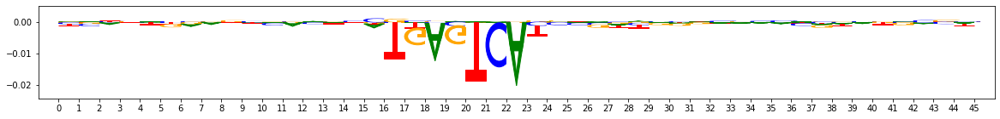

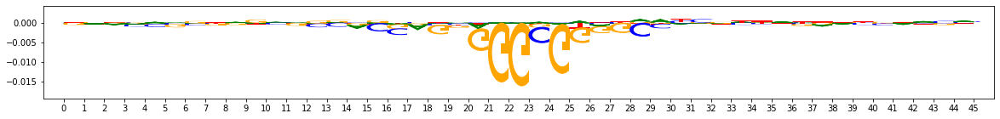

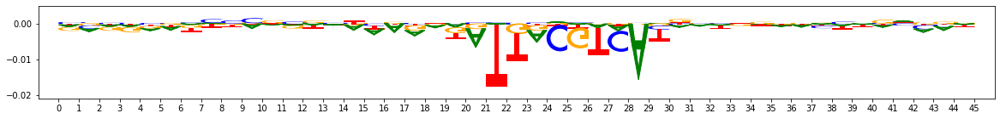

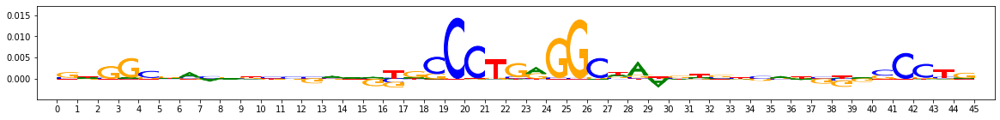

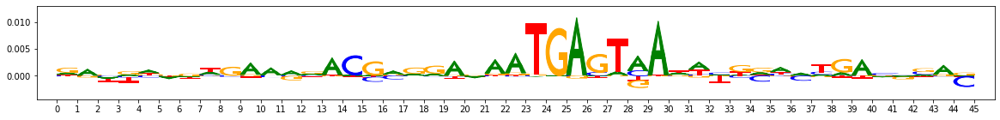

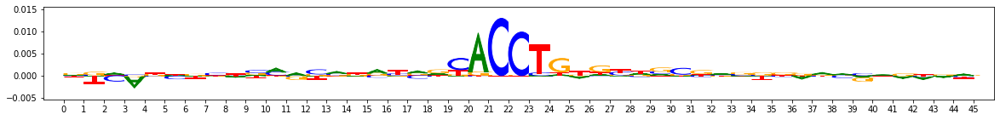

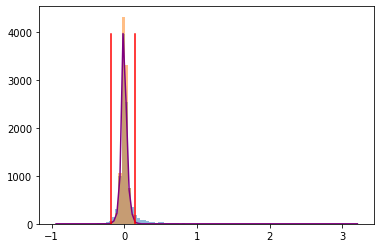

Got 33473 coords
After resolving overlaps, got 33473 seqlets
Across all tasks, the weakest transformed threshold used was: 0.8989699631673262
MEMORY 13.131280384
33473 identified in total
min_metacluster_size_frac * len(seqlets) = 334 is more than min_metacluster_size=100.
Using it as a new min_metacluster_size
2 activity patterns with support >= 334 out of 3 possible patterns
Metacluster sizes:  [27427, 6046]
Idx to activities:  {0: '1', 1: '-1'}
MEMORY 13.131280384
On metacluster 1
Metacluster size 6046
Relevant tasks:  ('task6',)
Relevant signs:  (-1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 6046
(Round 1) Computing coarse affmat
MEMORY 13.131280384
Beginning embedding computation
Computing embeddings
Finished embedding computation in 2.59 s
Starting affinity matrix computations
Normalization computed in 0.06 s
Cosine similarity mat computed in 0.34 s
Normalization computed in 0.1 s
Cosine similarity mat computed in 0.36 s
Finished affinity matrix computa

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7390772223707203


  2%|▏         | 1/50 [00:00<00:34,  1.43it/s]

Quality: 0.740141904294331


 32%|███▏      | 16/50 [00:17<00:38,  1.14s/it]

Quality: 0.7402223377301924


 42%|████▏     | 21/50 [00:23<00:34,  1.19s/it]

Quality: 0.7403857416786573


 48%|████▊     | 24/50 [00:27<00:31,  1.21s/it]

Quality: 0.7403901696242311


 50%|█████     | 25/50 [00:28<00:29,  1.19s/it]

Quality: 0.7404157458321408


 58%|█████▊    | 29/50 [00:32<00:23,  1.14s/it]

Quality: 0.7404231829942304


 64%|██████▍   | 32/50 [00:36<00:22,  1.23s/it]

Quality: 0.7404531381621748


 98%|█████████▊| 49/50 [00:56<00:01,  1.03s/it]

Quality: 0.7404691122156823


100%|██████████| 50/50 [00:57<00:00,  1.15s/it]

Got 15 clusters after round 1
Counts:
{7: 201, 0: 537, 8: 168, 12: 53, 2: 391, 1: 504, 9: 168, 6: 247, 11: 145, 4: 306, 13: 18, 3: 325, 5: 299, 10: 167, 14: 11}
MEMORY 13.160087552
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.160087552
Aggregating for cluster 0 with 537 seqlets
MEMORY 13.160087552


Trimmed 22 out of 537
Skipped 2 seqlets
Aggregating for cluster 1 with 504 seqlets
MEMORY 13.160087552
Trimmed 23 out of 504
Aggregating for cluster 2 with 391 seqlets
MEMORY 13.160087552
Trimmed 45 out of 391
Skipped 1 seqlets
Aggregating for cluster 3 with 325 seqlets
MEMORY 13.160087552
Trimmed 42 out of 325
Skipped 1 seqlets
Aggregating for cluster 4 with 306 seqlets
MEMORY 13.160087552
Trimmed 20 out of 306
Aggregating for cluster 5 with 299 seqlets
MEMORY 13.160087552
Trimmed 24 out of 299
Skipped 1 seqlets
Aggregating for cluster 6 with 247 seqlets
MEMORY 13.160087552
Trimmed 19 out of 247
Skipped 1 seqlets
Aggregating for cluster 7 with 201 seqlets
MEMORY 13.160087552
Trimmed 11 out of 201
Dropping cluster 7 with 190 seqlets due to sign disagreement
Aggregating for cluster 8 with 168 seqlets
MEMORY 13.160087552
Trimmed 27 out of 168
Dropping cluster 8 with 141 seqlets due to sign disagreement
Aggregating for cluster 9 with 168 seqlets
MEMORY 13.160087552
Trimmed 14 out of 168
A

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7478534094051188


  2%|▏         | 1/50 [00:00<00:41,  1.19it/s]

Quality: 0.7482855722295315


 16%|█▌        | 8/50 [00:07<00:36,  1.16it/s]

Quality: 0.7482887099519738


 18%|█▊        | 9/50 [00:07<00:35,  1.15it/s]

Quality: 0.7483404210066503


 64%|██████▍   | 32/50 [00:30<00:17,  1.05it/s]

Quality: 0.7484041665293468


 68%|██████▊   | 34/50 [00:32<00:14,  1.09it/s]

Quality: 0.7485244657233245


100%|██████████| 50/50 [00:45<00:00,  1.09it/s]

Got 15 clusters after round 2
Counts:
{0: 703, 6: 241, 10: 88, 5: 259, 7: 194, 9: 136, 8: 173, 12: 14, 3: 305, 2: 312, 1: 504, 11: 35, 13: 13, 4: 276, 14: 11}
MEMORY 13.15069952
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.15069952
Aggregating for cluster 0 with 703 seqlets
MEMORY 13.15069952


Trimmed 113 out of 703
Aggregating for cluster 1 with 504 seqlets
MEMORY 13.15069952
Trimmed 29 out of 504
Aggregating for cluster 2 with 312 seqlets
MEMORY 13.15069952
Trimmed 82 out of 312
Removed 5 duplicate seqlets
Aggregating for cluster 3 with 305 seqlets
MEMORY 13.15069952
Trimmed 72 out of 305
Aggregating for cluster 4 with 276 seqlets
MEMORY 13.15069952
Trimmed 49 out of 276
Aggregating for cluster 5 with 259 seqlets
MEMORY 13.15069952
Trimmed 76 out of 259
Removed 1 duplicate seqlets
Dropping cluster 5 with 182 seqlets due to sign disagreement
Aggregating for cluster 6 with 241 seqlets
MEMORY 13.15069952
Trimmed 16 out of 241
Aggregating for cluster 7 with 194 seqlets
MEMORY 13.15069952
Trimmed 36 out of 194
Dropping cluster 7 with 158 seqlets due to sign disagreement
Aggregating for cluster 8 with 173 seqlets
MEMORY 13.15069952
Trimmed 46 out of 173
Removed 1 duplicate seqlets
Aggregating for cluster 9 with 136 seqlets
MEMORY 13.15069952
Trimmed 2 out of 136
Removed 1 duplic

Louvain completed 22 runs in 2.4451818466186523 seconds
Similarity is 0.91917914; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.050328969955444336 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.0121164
Louvain completed 21 runs in 2.2914938926696777 seconds
Similarity is 0.77390224; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.014362335205078125 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00488259
After 3 runs, maximum modularity is Q = 0.00507051
After 6 runs, maximum modularity is Q = 0.00605105
Louvain completed 26 runs in 2.944399356842041 seconds
Similarity is 0.88953805; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.00800323486328125 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.0120434
After 2 runs, maximum modularity is Q = 0.

[t-SNE] Computed neighbors for 11276 samples in 0.617s...
[t-SNE] Computed conditional probabilities for sample 1000 / 11276
[t-SNE] Computed conditional probabilities for sample 2000 / 11276
[t-SNE] Computed conditional probabilities for sample 3000 / 11276
[t-SNE] Computed conditional probabilities for sample 4000 / 11276
[t-SNE] Computed conditional probabilities for sample 5000 / 11276
[t-SNE] Computed conditional probabilities for sample 6000 / 11276
[t-SNE] Computed conditional probabilities for sample 7000 / 11276
[t-SNE] Computed conditional probabilities for sample 8000 / 11276
[t-SNE] Computed conditional probabilities for sample 9000 / 11276
[t-SNE] Computed conditional probabilities for sample 10000 / 11276
[t-SNE] Computed conditional probabilities for sample 11000 / 11276
[t-SNE] Computed conditional probabilities for sample 11276 / 11276
[t-SNE] Mean sigma: 0.193601
(Round 1) Computing clustering
MEMORY 14.20683264
Beginning preprocessing + Leiden


  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8837404908916493


  4%|▍         | 2/50 [00:09<03:42,  4.63s/it]

Quality: 0.8838769303010531


 12%|█▏        | 6/50 [00:25<03:02,  4.16s/it]

Quality: 0.8839971945334024


 24%|██▍       | 12/50 [00:47<02:22,  3.75s/it]

Quality: 0.8840677608310442


 58%|█████▊    | 29/50 [01:51<01:14,  3.55s/it]

Quality: 0.8840966841852711


100%|██████████| 50/50 [03:12<00:00,  3.85s/it]

Got 25 clusters after round 1
Counts:
{9: 447, 0: 1159, 11: 432, 23: 136, 2: 841, 1: 1063, 10: 442, 14: 376, 5: 572, 20: 191, 24: 123, 19: 211, 3: 626, 21: 188, 4: 611, 18: 229, 8: 474, 13: 390, 16: 372, 17: 312, 15: 374, 12: 429, 7: 550, 6: 558, 22: 170}
MEMORY 13.245079552
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.245079552
Aggregating for cluster 0 with 1159 seqlets
MEMORY 13.245079552


Trimmed 47 out of 1159
Skipped 4 seqlets
Aggregating for cluster 1 with 1063 seqlets
MEMORY 13.25084672
Trimmed 30 out of 1063
Skipped 1 seqlets
Aggregating for cluster 2 with 841 seqlets
MEMORY 13.253275648
Trimmed 65 out of 841
Skipped 3 seqlets
Aggregating for cluster 3 with 626 seqlets
MEMORY 13.25406208
Trimmed 28 out of 626
Skipped 2 seqlets
Aggregating for cluster 4 with 611 seqlets
MEMORY 13.254586368
Trimmed 17 out of 611
Skipped 1 seqlets
Aggregating for cluster 5 with 572 seqlets
MEMORY 13.256196096
Trimmed 63 out of 572
Skipped 3 seqlets
Aggregating for cluster 6 with 558 seqlets
MEMORY 13.256732672
Trimmed 57 out of 558
Skipped 1 seqlets
Aggregating for cluster 7 with 550 seqlets
MEMORY 13.257662464
Trimmed 24 out of 550
Skipped 2 seqlets
Aggregating for cluster 8 with 474 seqlets
MEMORY 13.259517952
Trimmed 49 out of 474
Aggregating for cluster 9 with 447 seqlets
MEMORY 13.260054528
Trimmed 54 out of 447
Aggregating for cluster 10 with 442 seqlets
MEMORY 13.26082048
Trimm

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8596892581830039


  8%|▊         | 4/50 [00:11<02:13,  2.90s/it]

Quality: 0.8597112114425958


100%|██████████| 50/50 [02:27<00:00,  2.96s/it]

Got 19 clusters after round 2
Counts:
{1: 1500, 8: 394, 13: 281, 2: 1193, 4: 728, 0: 1705, 7: 410, 10: 362, 5: 565, 6: 445, 9: 386, 3: 774, 11: 333, 17: 155, 12: 325, 16: 158, 15: 175, 18: 110, 14: 207}
MEMORY 13.300330496
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.300330496
Aggregating for cluster 0 with 1705 seqlets
MEMORY 13.300330496


Trimmed 17 out of 1705
Aggregating for cluster 1 with 1500 seqlets
MEMORY 13.300330496
Trimmed 24 out of 1500
Removed 174 duplicate seqlets
Aggregating for cluster 2 with 1193 seqlets
MEMORY 13.300330496
Trimmed 42 out of 1193
Aggregating for cluster 3 with 774 seqlets
MEMORY 13.300330496
Trimmed 16 out of 774
Aggregating for cluster 4 with 728 seqlets
MEMORY 13.300330496
Trimmed 50 out of 728
Aggregating for cluster 5 with 565 seqlets
MEMORY 13.300330496
Trimmed 8 out of 565
Aggregating for cluster 6 with 445 seqlets
MEMORY 13.300330496
Trimmed 21 out of 445
Aggregating for cluster 7 with 410 seqlets
MEMORY 13.300330496
Trimmed 19 out of 410
Aggregating for cluster 8 with 394 seqlets
MEMORY 13.300330496
Trimmed 1 out of 394
Removed 55 duplicate seqlets
Aggregating for cluster 9 with 386 seqlets
MEMORY 13.300330496
Trimmed 19 out of 386
Aggregating for cluster 10 with 362 seqlets
MEMORY 13.300330496
Trimmed 56 out of 362
Aggregating for cluster 11 with 333 seqlets
MEMORY 13.300330496
T

After 1 runs, maximum modularity is Q = 0.0133957
Louvain completed 21 runs in 2.2645103931427 seconds
Similarity is 0.9013864; is_dissimilar is False
Merging on 20 clusters
MEMORY 13.27538176
On merging iteration 1
Computing pattern to seqlet distances
Computing pattern to pattern distances
Collapsing 1 & 9 with prob 0.0005480097961703409 and sim 0.9826352260558642
Collapsing 1 & 14 with prob 0.0003137133232069986 and sim 0.9243716353016038
Trimmed 3 out of 1640
Trimmed 1 out of 1881
On merging iteration 2
Computing pattern to seqlet distances
Computing pattern to pattern distances
Got 18 patterns after merging
MEMORY 13.275414528
Performing seqlet reassignment
MEMORY 13.275414528
Skipped 1 seqlets
Got 18 patterns after reassignment
MEMORY 13.275414528
Total time taken is 949.53s
MEMORY 13.275414528
Metacluster 0 for task task6
Pattern idx 0 with 1880 seqlets
Pattern idx 1 with 1688 seqlets
Pattern idx 2 with 1151 seqlets
Pattern idx 3 with 678 seqlets
Pattern idx 4 with 556 seqlets
P

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 3 with 199 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 4 with 183 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 5 with 133 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 6 with 130 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 7 with 112 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 8 with 98 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 9 with 72 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 10 with 89 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 11 with 61 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 12 with 49 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 13 with 49 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 14 with 41 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Running TF-MoDISco for task task7
MEMORY 13.345800192
On task task7
Computing windowed sums on original
Generating null dist
peak(mu)= 1.6908789053559845e-05
Computing threshold
Thresholds from null dist were -0.28526508808135986  and  0.09821641445159912
Final raw thresholds are -0.28526508808135986  and  0.09821641445159912
Final transformed thresholds are -0.9475959621598186  and  0.7971923796741928


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


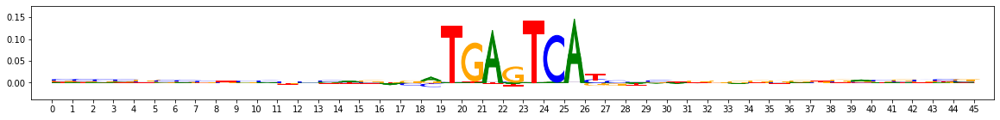

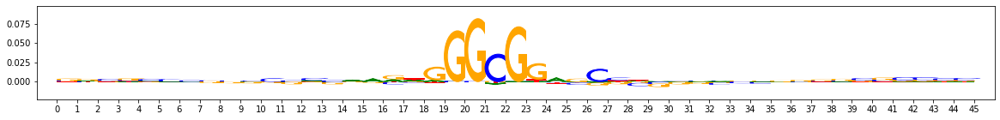

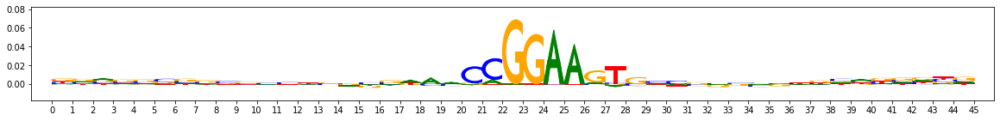

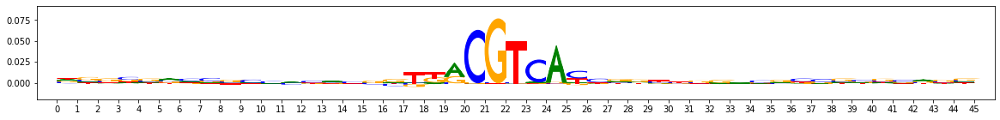

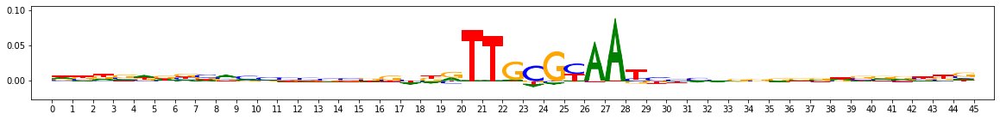

...

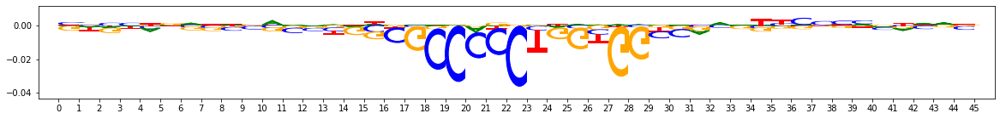

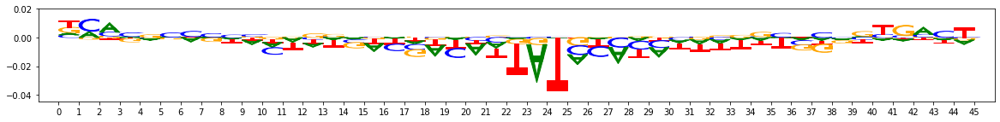

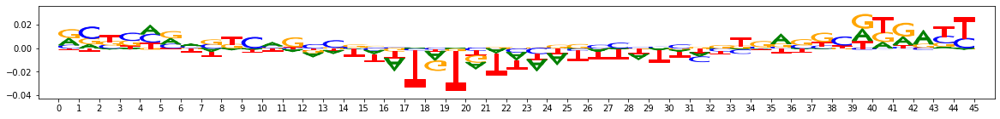

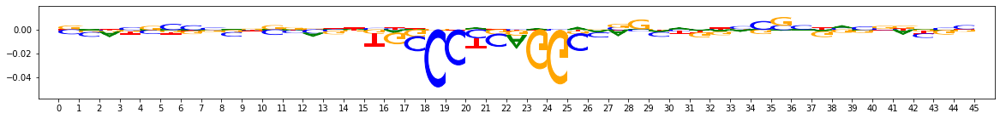

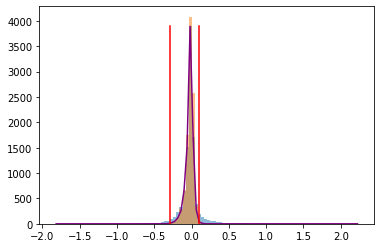

Got 63912 coords
After resolving overlaps, got 63912 seqlets
Across all tasks, the weakest transformed threshold used was: 0.7970923796741928
MEMORY 13.394075648
63912 identified in total
min_metacluster_size_frac * len(seqlets) = 639 is more than min_metacluster_size=100.
Using it as a new min_metacluster_size
Reducing weak_threshold_for_counting_sign to match weakest_transformed_thresh, from 0.8 to 0.7970923796741928
2 activity patterns with support >= 639 out of 3 possible patterns
Metacluster sizes:  [45227, 18685]
Idx to activities:  {0: '1', 1: '-1'}
MEMORY 13.394075648
On metacluster 1
Metacluster size 18685
Relevant tasks:  ('task7',)
Relevant signs:  (-1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 18685
(Round 1) Computing coarse affmat
MEMORY 13.358686208
Beginning embedding computation
Computing embeddings
Finished embedding computation in 4.02 s
Starting affinity matrix computations
Normalization computed in 0.19 s
Cosine similarity mat computed in

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7940185774671805


 50%|█████     | 25/50 [01:35<01:30,  3.64s/it]

Quality: 0.7941221583752631


100%|██████████| 50/50 [03:07<00:00,  3.76s/it]

Got 23 clusters after round 1
Counts:
{2: 789, 12: 164, 8: 503, 1: 945, 4: 732, 6: 582, 3: 765, 0: 1200, 16: 45, 13: 87, 10: 371, 7: 511, 18: 37, 5: 707, 21: 18, 20: 19, 19: 34, 22: 11, 15: 46, 9: 408, 14: 54, 11: 245, 17: 44}
MEMORY 13.408415744
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.408415744
Aggregating for cluster 0 with 1200 seqlets
MEMORY 13.408415744


Trimmed 133 out of 1200
Aggregating for cluster 1 with 945 seqlets
MEMORY 13.408415744
Trimmed 25 out of 945
Skipped 1 seqlets
Removed 3 duplicate seqlets
Aggregating for cluster 2 with 789 seqlets
MEMORY 13.408415744
Trimmed 17 out of 789
Aggregating for cluster 3 with 765 seqlets
MEMORY 13.408415744
Trimmed 15 out of 765
Removed 1 duplicate seqlets
Aggregating for cluster 4 with 732 seqlets
MEMORY 13.408940032
Trimmed 87 out of 732
Aggregating for cluster 5 with 707 seqlets
MEMORY 13.409468416
Trimmed 49 out of 707
Aggregating for cluster 6 with 582 seqlets
MEMORY 13.410250752
Trimmed 54 out of 582
Aggregating for cluster 7 with 511 seqlets
MEMORY 13.410512896
Trimmed 12 out of 511
Removed 2 duplicate seqlets
Aggregating for cluster 8 with 503 seqlets
MEMORY 13.410779136
Trimmed 28 out of 503
Dropping cluster 8 with 475 seqlets due to sign disagreement
Aggregating for cluster 9 with 408 seqlets
MEMORY 13.411319808
Trimmed 48 out of 408
Removed 2 duplicate seqlets
Aggregating for clus

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.794271700982329


  4%|▍         | 2/50 [00:06<02:17,  2.87s/it]

Quality: 0.7947310957489435


 86%|████████▌ | 43/50 [02:25<00:27,  3.87s/it]

Quality: 0.7947747055688998


100%|██████████| 50/50 [02:50<00:00,  3.41s/it]

Got 18 clusters after round 2
Counts:
{0: 1068, 8: 507, 4: 678, 2: 803, 6: 598, 13: 155, 9: 309, 10: 256, 14: 136, 5: 658, 1: 881, 3: 712, 12: 155, 11: 209, 7: 519, 16: 32, 15: 34, 17: 15}
MEMORY 13.474287616
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.474287616
Aggregating for cluster 0 with 1068 seqlets
MEMORY 13.474287616


Trimmed 135 out of 1068
Aggregating for cluster 1 with 881 seqlets
MEMORY 13.474287616
Trimmed 117 out of 881
Aggregating for cluster 2 with 803 seqlets
MEMORY 13.474287616
Trimmed 86 out of 803
Aggregating for cluster 3 with 712 seqlets
MEMORY 13.474287616
Trimmed 45 out of 712
Removed 2 duplicate seqlets
Aggregating for cluster 4 with 678 seqlets
MEMORY 13.474287616
Trimmed 91 out of 678
Aggregating for cluster 5 with 658 seqlets
MEMORY 13.474287616
Trimmed 65 out of 658
Aggregating for cluster 6 with 598 seqlets
MEMORY 13.474287616
Trimmed 132 out of 598
Aggregating for cluster 7 with 519 seqlets
MEMORY 13.474287616
Trimmed 25 out of 519
Aggregating for cluster 8 with 507 seqlets
MEMORY 13.474287616
Trimmed 101 out of 507
Dropping cluster 8 with 406 seqlets due to sign disagreement
Aggregating for cluster 9 with 309 seqlets
MEMORY 13.474287616
Trimmed 32 out of 309
Aggregating for cluster 10 with 256 seqlets
MEMORY 13.474287616
Trimmed 40 out of 256
Removed 3 duplicate seqlets
Aggre

Inspecting for spurious merging
Wrote graph to binary file in 0.0020346641540527344 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = -0.0179701
After 2 runs, maximum modularity is Q = 0.00675727
Louvain completed 22 runs in 2.4712657928466797 seconds
Similarity is -0.29019114; is_dissimilar is True
Got 5 subclusters
Inspecting for spurious merging
Wrote graph to binary file in 0.03904438018798828 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.010003
Louvain completed 21 runs in 2.3587872982025146 seconds
Similarity is 0.9756092; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.008744955062866211 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00776343
Louvain completed 21 runs in 2.285801649093628 seconds
Similarity is 0.8813655; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.01129317283

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8641428333107134


  2%|▏         | 1/50 [00:03<02:47,  3.42s/it]

Quality: 0.8641904514256417


 54%|█████▍    | 27/50 [01:37<01:20,  3.48s/it]

Quality: 0.8642122620097216


 86%|████████▌ | 43/50 [02:39<00:24,  3.53s/it]

Quality: 0.864212447574923


100%|██████████| 50/50 [03:03<00:00,  3.68s/it]

Got 23 clusters after round 1
Counts:
{9: 512, 0: 1107, 14: 246, 8: 526, 4: 777, 13: 355, 3: 805, 12: 358, 1: 1048, 5: 766, 2: 901, 16: 196, 7: 576, 20: 53, 10: 459, 6: 593, 19: 87, 17: 134, 11: 457, 15: 232, 22: 16, 18: 95, 21: 25}
MEMORY 13.497253888
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.497253888
Aggregating for cluster 0 with 1107 seqlets
MEMORY 13.497253888


Trimmed 24 out of 1107
Skipped 4 seqlets
Removed 7 duplicate seqlets
Aggregating for cluster 1 with 1048 seqlets
MEMORY 13.502795776
Trimmed 33 out of 1048
Skipped 7 seqlets
Removed 18 duplicate seqlets
Aggregating for cluster 2 with 901 seqlets
MEMORY 13.505114112
Trimmed 20 out of 901
Skipped 1 seqlets
Aggregating for cluster 3 with 805 seqlets
MEMORY 13.506699264
Trimmed 25 out of 805
Skipped 3 seqlets
Removed 5 duplicate seqlets
Aggregating for cluster 4 with 777 seqlets
MEMORY 13.50803456
Trimmed 122 out of 777
Skipped 1 seqlets
Aggregating for cluster 5 with 766 seqlets
MEMORY 13.509300224
Trimmed 17 out of 766
Skipped 5 seqlets
Aggregating for cluster 6 with 593 seqlets
MEMORY 13.511409664
Trimmed 7 out of 593
Skipped 3 seqlets
Aggregating for cluster 7 with 576 seqlets
MEMORY 13.512216576
Trimmed 39 out of 576
Skipped 3 seqlets
Aggregating for cluster 8 with 526 seqlets
MEMORY 13.513027584
Trimmed 98 out of 526
Skipped 1 seqlets
Aggregating for cluster 9 with 512 seqlets
MEMORY

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8423802531647188


  2%|▏         | 1/50 [00:03<02:29,  3.05s/it]

Quality: 0.8426357378297306


  6%|▌         | 3/50 [00:09<02:22,  3.04s/it]

Quality: 0.8426457955346541


 24%|██▍       | 12/50 [00:36<02:04,  3.28s/it]

Quality: 0.8426671745039919


100%|██████████| 50/50 [02:34<00:00,  3.08s/it]

Got 22 clusters after round 2
Counts:
{2: 1062, 9: 409, 18: 49, 0: 1445, 11: 345, 5: 691, 8: 410, 19: 39, 12: 210, 13: 200, 6: 501, 3: 925, 10: 385, 16: 84, 1: 1301, 4: 730, 15: 85, 14: 139, 7: 442, 20: 16, 21: 4, 17: 55}
MEMORY 13.537161216
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.537161216
Aggregating for cluster 0 with 1445 seqlets
MEMORY 13.537161216


Trimmed 78 out of 1445
Removed 49 duplicate seqlets
Aggregating for cluster 1 with 1301 seqlets
MEMORY 13.537161216
Trimmed 25 out of 1301
Aggregating for cluster 2 with 1062 seqlets
MEMORY 13.537161216
Trimmed 33 out of 1062
Removed 31 duplicate seqlets
Aggregating for cluster 3 with 925 seqlets
MEMORY 13.537161216
Trimmed 77 out of 925
Aggregating for cluster 4 with 730 seqlets
MEMORY 13.537161216
Trimmed 18 out of 730
Aggregating for cluster 5 with 691 seqlets
MEMORY 13.537161216
Trimmed 52 out of 691
Aggregating for cluster 6 with 501 seqlets
MEMORY 13.537161216
Trimmed 42 out of 501
Aggregating for cluster 7 with 442 seqlets
MEMORY 13.537161216
Trimmed 15 out of 442
Aggregating for cluster 8 with 410 seqlets
MEMORY 13.537161216
Trimmed 39 out of 410
Aggregating for cluster 9 with 409 seqlets
MEMORY 13.537161216
Trimmed 56 out of 409
Aggregating for cluster 10 with 385 seqlets
MEMORY 13.537161216
Trimmed 66 out of 385
Aggregating for cluster 11 with 345 seqlets
MEMORY 13.537161216


After 3 runs, maximum modularity is Q = 0.00532086
After 8 runs, maximum modularity is Q = 0.00572678
Louvain completed 28 runs in 3.2368004322052 seconds
Similarity is -0.06873239; is_dissimilar is True
Got 4 subclusters
Inspecting for spurious merging
Wrote graph to binary file in 0.017151355743408203 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00659899
After 2 runs, maximum modularity is Q = 0.00660657
Louvain completed 22 runs in 2.5205135345458984 seconds
Similarity is 0.976026; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.012894868850708008 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00661442
After 2 runs, maximum modularity is Q = 0.00664625
Louvain completed 22 runs in 2.503636598587036 seconds
Similarity is 0.84495205; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.004452228546142578 seconds
Running Louvai

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Metacluster 1 for task task7
Pattern idx 0 with 1288 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 1 with 933 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 2 with 779 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 3 with 749 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 4 with 673 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 5 with 594 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 6 with 495 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 7 with 409 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 8 with 205 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 9 with 121 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 10 with 102 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 11 with 96 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 12 with 68 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 13 with 51 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 14 with 39 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 15 with 49 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Running TF-MoDISco for task task8
MEMORY 13.554814976
On task task8
Computing windowed sums on original
Generating null dist
peak(mu)= -1.5789247117935917e-06
Computing threshold
Thresholds from null dist were -0.16101965308189392  and  0.10913372039794922
Final raw thresholds are -0.16101965308189392  and  0.10913372039794922
Final transformed thresholds are -0.8831390521342489  and  0.8277144880764586


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


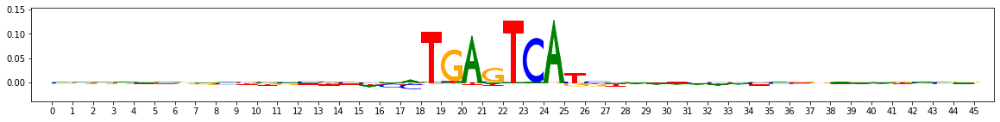

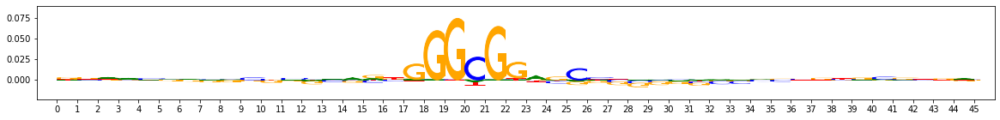

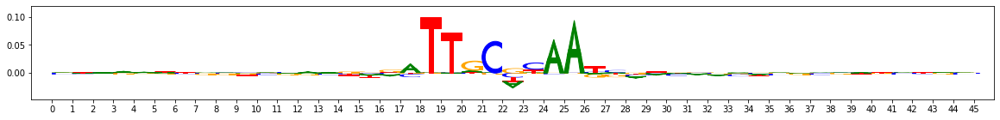

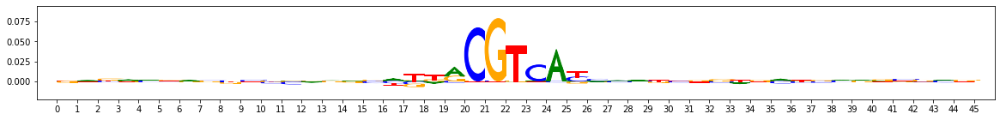

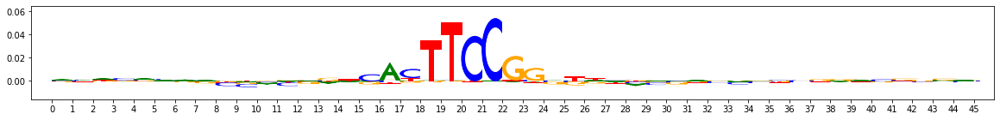

...

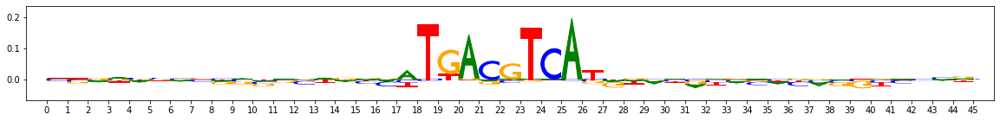

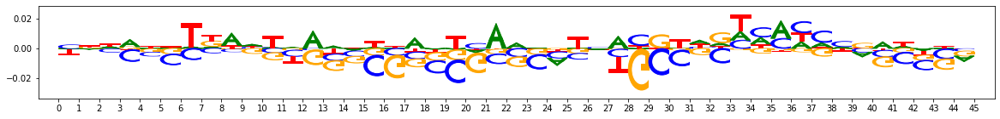

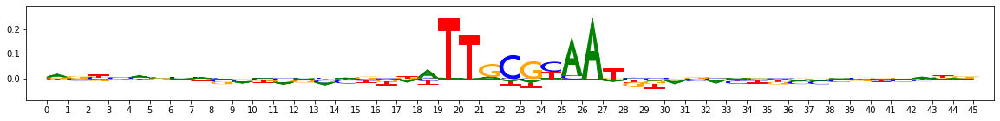

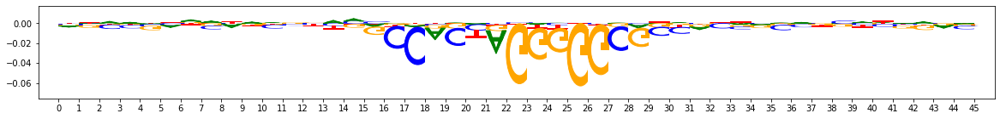

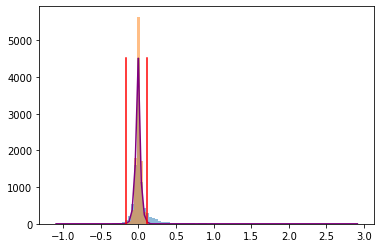

Got 124072 coords
After resolving overlaps, got 124072 seqlets
Across all tasks, the weakest transformed threshold used was: 0.8276144880764587
MEMORY 13.589938176
124072 identified in total
min_metacluster_size_frac * len(seqlets) = 1240 is more than min_metacluster_size=100.
Using it as a new min_metacluster_size
2 activity patterns with support >= 1240 out of 3 possible patterns
Metacluster sizes:  [101299, 22773]
Idx to activities:  {0: '1', 1: '-1'}
MEMORY 13.589938176
On metacluster 1
Metacluster size 22773 limited to 20000
Relevant tasks:  ('task8',)
Relevant signs:  (-1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 20000
(Round 1) Computing coarse affmat
MEMORY 13.589938176
Beginning embedding computation
Computing embeddings
Finished embedding computation in 3.84 s
Starting affinity matrix computations
Normalization computed in 0.21 s
Cosine similarity mat computed in 2.61 s
Normalization computed in 0.25 s
Cosine similarity mat computed in 2.69 s
Finis

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7709097159648832


  2%|▏         | 1/50 [00:03<02:52,  3.53s/it]

Quality: 0.771784953505431


100%|██████████| 50/50 [03:45<00:00,  4.50s/it]

Got 20 clusters after round 1
Counts:
{12: 296, 10: 333, 13: 295, 0: 1226, 14: 268, 4: 695, 3: 809, 18: 76, 1: 1091, 15: 127, 9: 367, 8: 439, 5: 679, 17: 95, 6: 563, 2: 984, 7: 456, 11: 314, 16: 98, 19: 19}
MEMORY 13.679685632
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.679685632
Aggregating for cluster 0 with 1226 seqlets
MEMORY 13.679685632


Trimmed 55 out of 1226
Skipped 7 seqlets
Aggregating for cluster 1 with 1091 seqlets
MEMORY 13.686583296
Trimmed 189 out of 1091
Skipped 2 seqlets
Removed 1 duplicate seqlets
Aggregating for cluster 2 with 984 seqlets
MEMORY 13.68807424
Trimmed 64 out of 984
Aggregating for cluster 3 with 809 seqlets
MEMORY 13.689962496
Trimmed 64 out of 809
Skipped 7 seqlets
Aggregating for cluster 4 with 695 seqlets
MEMORY 13.691224064
Trimmed 40 out of 695
Skipped 3 seqlets
Aggregating for cluster 5 with 679 seqlets
MEMORY 13.692305408
Trimmed 31 out of 679
Skipped 2 seqlets
Removed 3 duplicate seqlets
Aggregating for cluster 6 with 563 seqlets
MEMORY 13.693878272
Trimmed 30 out of 563
Skipped 1 seqlets
Aggregating for cluster 7 with 456 seqlets
MEMORY 13.694418944
Trimmed 31 out of 456
Skipped 3 seqlets
Aggregating for cluster 8 with 439 seqlets
MEMORY 13.695148032
Trimmed 49 out of 439
Skipped 1 seqlets
Aggregating for cluster 9 with 367 seqlets
MEMORY 13.695954944
Trimmed 27 out of 367
Aggregatin

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7656404764984837


 10%|█         | 5/50 [00:17<02:30,  3.35s/it]

Quality: 0.7658667645564404


100%|██████████| 50/50 [02:52<00:00,  3.46s/it]

Got 22 clusters after round 2
Counts:
{0: 1657, 6: 489, 8: 389, 14: 142, 4: 738, 9: 230, 10: 221, 18: 41, 1: 961, 2: 886, 3: 740, 7: 442, 15: 132, 17: 63, 13: 142, 11: 219, 12: 158, 16: 126, 5: 557, 21: 15, 20: 16, 19: 21}
MEMORY 13.71367424
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.71367424
Aggregating for cluster 0 with 1657 seqlets
MEMORY 13.71367424


Trimmed 97 out of 1657
Removed 1 duplicate seqlets
Aggregating for cluster 1 with 961 seqlets
MEMORY 13.71367424
Trimmed 101 out of 961
Aggregating for cluster 2 with 886 seqlets
MEMORY 13.71367424
Trimmed 104 out of 886
Removed 3 duplicate seqlets
Aggregating for cluster 3 with 740 seqlets
MEMORY 13.71367424
Trimmed 193 out of 740
Skipped 5 seqlets
Removed 6 duplicate seqlets
Aggregating for cluster 4 with 738 seqlets
MEMORY 13.71367424
Trimmed 39 out of 738
Skipped 7 seqlets
Removed 1 duplicate seqlets
Removed 1 duplicate seqlets
Aggregating for cluster 5 with 557 seqlets
MEMORY 13.71367424
Trimmed 41 out of 557
Removed 1 duplicate seqlets
Aggregating for cluster 6 with 489 seqlets
MEMORY 13.71367424
Trimmed 43 out of 489
Dropping cluster 6 with 446 seqlets due to sign disagreement
Aggregating for cluster 7 with 442 seqlets
MEMORY 13.71367424
Trimmed 52 out of 442
Aggregating for cluster 8 with 389 seqlets
MEMORY 13.71367424
Trimmed 116 out of 389
Removed 1 duplicate seqlets
Dropping

After 1 runs, maximum modularity is Q = 0.00538258
After 2 runs, maximum modularity is Q = 0.00543319
After 4 runs, maximum modularity is Q = 0.00543368
After 22 runs, maximum modularity is Q = 0.00543373
Louvain completed 42 runs in 4.837101459503174 seconds
Similarity is 0.75150365; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.003258943557739258 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00537329
Louvain completed 21 runs in 2.376063346862793 seconds
Similarity is 0.70546407; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.0010709762573242188 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.0031127
After 2 runs, maximum modularity is Q = 0.00468436
After 6 runs, maximum modularity is Q = 0.0046902
Louvain completed 26 runs in 3.0766069889068604 seconds
Similarity is 0.7067325; is_dissimilar is True
Inspecting for spurio

Similarity is 0.82231694; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.006681919097900391 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00431784
After 2 runs, maximum modularity is Q = 0.00453462
After 8 runs, maximum modularity is Q = 0.00453463
Louvain completed 28 runs in 3.4333670139312744 seconds
Similarity is 0.7798427; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.002361774444580078 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00352572
Louvain completed 21 runs in 2.3593757152557373 seconds
Similarity is 0.8495593; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.0016984939575195312 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00538144
Louvain completed 21 runs in 2.3954386711120605 seconds
Similarity is 0.61916304; is_dissimilar

Similarity is 0.9059866; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.026759862899780273 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00728172
After 2 runs, maximum modularity is Q = 0.0073021
After 4 runs, maximum modularity is Q = 0.00731525
After 6 runs, maximum modularity is Q = 0.00731797
Louvain completed 26 runs in 3.249760627746582 seconds
Similarity is 0.9523058; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.029150009155273438 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.0251644
Louvain completed 21 runs in 2.3937315940856934 seconds
Similarity is 0.0065294746; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.01116037368774414 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.0057458
After 3 runs, maximum modularity is Q = 0.005760

On merging iteration 1
Computing pattern to seqlet distances
Computing pattern to pattern distances
Collapsing 43 & 46 with prob 0.0008523003018424595 and sim 0.9784083666972033
Collapsing 16 & 42 with prob 6.8567705402679136e-06 and sim 0.9784072443886871
Collapsing 20 & 21 with prob 0.0007936471474890075 and sim 0.863342707823095
Trimmed 0 out of 39
Trimmed 24 out of 507
Removed 1 duplicate seqlets
Trimmed 39 out of 266
On merging iteration 2
Computing pattern to seqlet distances
Computing pattern to pattern distances
Got 44 patterns after merging
MEMORY 13.711761408
Performing seqlet reassignment
MEMORY 13.711761408
Cross contin jaccard time taken: 2.26 s
Cross contin jaccard time taken: 0.11 s
Discarded 60 seqlets
Removed 1 duplicate seqlets
Removed 1 duplicate seqlets
Skipped 3 seqlets
Got 32 patterns after reassignment
MEMORY 13.711777792
Total time taken is 1173.24s
MEMORY 13.711777792
On metacluster 0
Metacluster size 101299 limited to 20000
Relevant tasks:  ('task8',)
Relevant

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.874123831127583


  2%|▏         | 1/50 [00:03<02:49,  3.46s/it]

Quality: 0.8742426066345368


 20%|██        | 10/50 [00:37<02:22,  3.56s/it]

Quality: 0.8743161632479279


100%|██████████| 50/50 [02:55<00:00,  3.51s/it]

Got 22 clusters after round 1
Counts:
{17: 267, 2: 875, 11: 374, 15: 286, 13: 353, 1: 946, 6: 487, 14: 287, 9: 430, 10: 422, 7: 480, 12: 364, 3: 729, 8: 435, 5: 571, 16: 284, 19: 222, 18: 247, 0: 1116, 20: 221, 4: 723, 21: 22}
MEMORY 13.763260416
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.763260416
Aggregating for cluster 0 with 1116 seqlets
MEMORY 13.763260416


Trimmed 38 out of 1116
Skipped 3 seqlets
Aggregating for cluster 1 with 946 seqlets
MEMORY 13.769179136
Trimmed 38 out of 946
Skipped 3 seqlets
Aggregating for cluster 2 with 875 seqlets
MEMORY 13.770338304
Trimmed 104 out of 875
Aggregating for cluster 3 with 729 seqlets
MEMORY 13.771911168
Trimmed 99 out of 729
Aggregating for cluster 4 with 723 seqlets
MEMORY 13.772435456
Trimmed 61 out of 723
Removed 13 duplicate seqlets
Aggregating for cluster 5 with 571 seqlets
MEMORY 13.7745408
Trimmed 40 out of 571
Removed 9 duplicate seqlets
Aggregating for cluster 6 with 487 seqlets
MEMORY 13.774790656
Trimmed 96 out of 487
Aggregating for cluster 7 with 480 seqlets
MEMORY 13.775314944
Trimmed 51 out of 480
Aggregating for cluster 8 with 435 seqlets
MEMORY 13.77611776
Trimmed 63 out of 435
Aggregating for cluster 9 with 430 seqlets
MEMORY 13.777149952
Trimmed 66 out of 430
Skipped 1 seqlets
Aggregating for cluster 10 with 422 seqlets
MEMORY 13.777948672
Trimmed 9 out of 422
Removed 60 duplica

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8557062381467511


 16%|█▌        | 8/50 [00:17<01:33,  2.23s/it]

Quality: 0.8559575512785033


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]

Got 19 clusters after round 2
Counts:
{1: 1075, 18: 42, 7: 431, 6: 491, 3: 828, 17: 203, 9: 395, 13: 250, 14: 232, 0: 1180, 2: 875, 8: 423, 4: 619, 10: 340, 11: 329, 16: 212, 15: 216, 5: 532, 12: 267}
MEMORY 13.746905088
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.746905088
Aggregating for cluster 0 with 1180 seqlets
MEMORY 13.746905088


Trimmed 36 out of 1180
Removed 86 duplicate seqlets
Aggregating for cluster 1 with 1075 seqlets
MEMORY 13.746905088
Trimmed 39 out of 1075
Aggregating for cluster 2 with 875 seqlets
MEMORY 13.746905088
Trimmed 29 out of 875
Aggregating for cluster 3 with 828 seqlets
MEMORY 13.746905088
Trimmed 27 out of 828
Removed 8 duplicate seqlets
Aggregating for cluster 4 with 619 seqlets
MEMORY 13.746905088
Trimmed 33 out of 619
Aggregating for cluster 5 with 532 seqlets
MEMORY 13.746905088
Trimmed 11 out of 532
Removed 12 duplicate seqlets
Aggregating for cluster 6 with 491 seqlets
MEMORY 13.74664704
Trimmed 23 out of 491
Aggregating for cluster 7 with 431 seqlets
MEMORY 13.74664704
Trimmed 34 out of 431
Aggregating for cluster 8 with 423 seqlets
MEMORY 13.74664704
Trimmed 25 out of 423
Removed 1 duplicate seqlets
Aggregating for cluster 9 with 395 seqlets
MEMORY 13.74664704
Trimmed 22 out of 395
Aggregating for cluster 10 with 340 seqlets
MEMORY 13.74664704
Trimmed 35 out of 340
Aggregating for

Louvain completed 27 runs in 3.3291618824005127 seconds
Similarity is 0.9872245; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.0015969276428222656 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00600088
After 2 runs, maximum modularity is Q = 0.00600089
Louvain completed 22 runs in 2.647390604019165 seconds
Similarity is 0.89733636; is_dissimilar is False
Merging on 20 clusters
MEMORY 13.741060096
On merging iteration 1
Computing pattern to seqlet distances
Computing pattern to pattern distances
Collapsing 0 & 13 with prob 0.001151000208388729 and sim 0.9758428003106144
Collapsing 0 & 6 with prob 0.009695869082058722 and sim 0.9353909282324248
Collapsing 6 & 13 with prob 4.301610173575285e-06 and sim 0.9007607988366468
Trimmed 0 out of 1309
Trimmed 3 out of 1818
On merging iteration 2
Computing pattern to seqlet distances
Computing pattern to pattern distances
Got 18 patterns after merging
MEMORY 13.741

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 3 with 513 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 4 with 483 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 5 with 274 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 6 with 247 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 7 with 196 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 8 with 192 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 9 with 177 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 10 with 173 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 11 with 154 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 12 with 148 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 13 with 138 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 14 with 110 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 15 with 113 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 16 with 97 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 17 with 92 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 18 with 94 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 19 with 82 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 20 with 68 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 21 with 51 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 22 with 57 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 23 with 63 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 24 with 79 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 25 with 50 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 26 with 59 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 27 with 46 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 28 with 39 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 29 with 39 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 30 with 34 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 31 with 39 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Running TF-MoDISco for task task9
MEMORY 13.826351104
On task task9
Computing windowed sums on original
Generating null dist
peak(mu)= -4.529491707217989e-06
Computing threshold
Thresholds from null dist were -0.10717518627643585  and  0.08785378932952881
Final raw thresholds are -0.10717518627643585  and  0.08785378932952881
Final transformed thresholds are -0.8282501957725049  and  0.7953808197766749


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


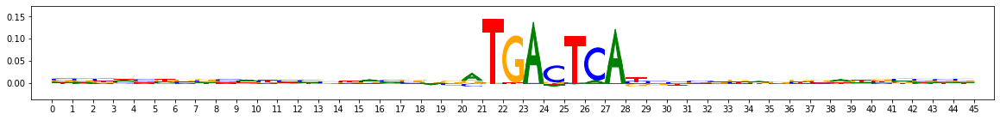

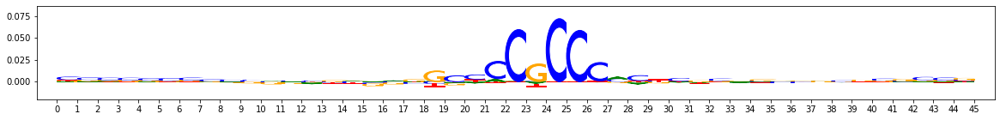

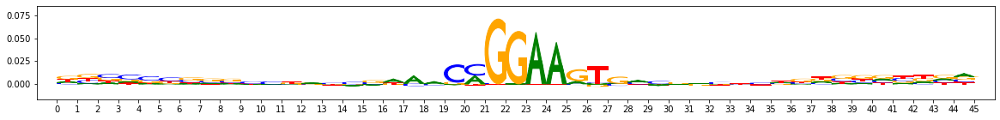

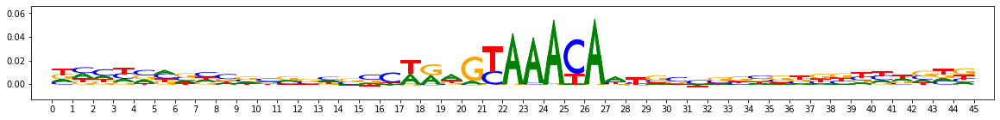

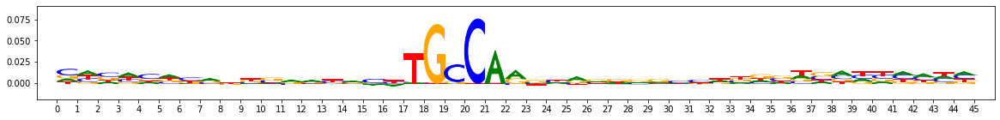

...

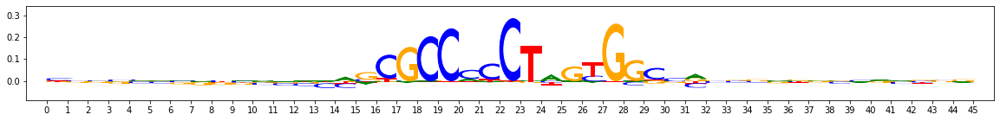

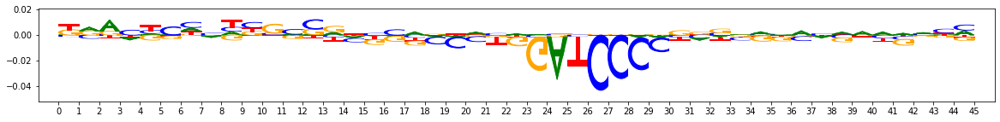

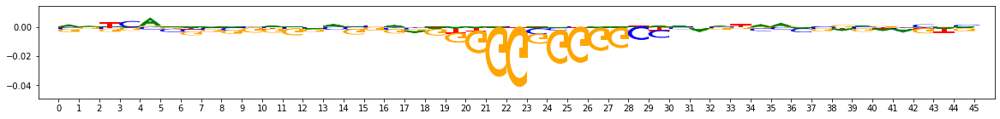

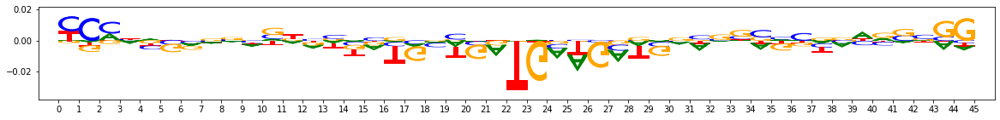

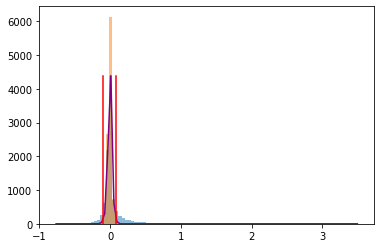

Got 172303 coords
After resolving overlaps, got 172303 seqlets
Across all tasks, the weakest transformed threshold used was: 0.7952808197766749
MEMORY 13.77783808
172303 identified in total
min_metacluster_size_frac * len(seqlets) = 1723 is more than min_metacluster_size=100.
Using it as a new min_metacluster_size
Reducing weak_threshold_for_counting_sign to match weakest_transformed_thresh, from 0.8 to 0.7952808197766749
2 activity patterns with support >= 1723 out of 3 possible patterns
Metacluster sizes:  [119104, 53199]
Idx to activities:  {0: '1', 1: '-1'}
MEMORY 13.77783808
On metacluster 1
Metacluster size 53199 limited to 20000
Relevant tasks:  ('task9',)
Relevant signs:  (-1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 20000
(Round 1) Computing coarse affmat
MEMORY 13.77783808
Beginning embedding computation
Computing embeddings
Finished embedding computation in 4.01 s
Starting affinity matrix computations
Normalization computed in 0.21 s
Cosine simila

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7571614920183429


  2%|▏         | 1/50 [00:05<04:28,  5.48s/it]

Quality: 0.7580257961095945


 38%|███▊      | 19/50 [01:22<02:07,  4.11s/it]

Quality: 0.7580709691456525


 42%|████▏     | 21/50 [01:31<02:06,  4.37s/it]

Quality: 0.7582048048058965


100%|██████████| 50/50 [03:30<00:00,  4.20s/it]

Got 19 clusters after round 1
Counts:
{8: 454, 0: 1159, 12: 206, 11: 215, 13: 190, 16: 53, 14: 142, 15: 111, 1: 992, 6: 532, 5: 713, 2: 945, 4: 822, 3: 895, 9: 421, 7: 481, 10: 342, 18: 14, 17: 24}
MEMORY 13.85588736
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.85588736
Aggregating for cluster 0 with 1159 seqlets
MEMORY 13.85588736


Trimmed 60 out of 1159
Skipped 3 seqlets
Aggregating for cluster 1 with 992 seqlets
MEMORY 13.862576128
Trimmed 78 out of 992
Skipped 10 seqlets
Removed 4 duplicate seqlets
Aggregating for cluster 2 with 945 seqlets
MEMORY 13.864189952
Trimmed 45 out of 945
Skipped 13 seqlets
Removed 4 duplicate seqlets
Skipped 1 seqlets
Dropping cluster 2 with 882 seqlets due to sign disagreement
Aggregating for cluster 3 with 895 seqlets
MEMORY 13.866356736
Trimmed 47 out of 895
Skipped 6 seqlets
Removed 3 duplicate seqlets
Aggregating for cluster 4 with 822 seqlets
MEMORY 13.867667456
Trimmed 70 out of 822
Skipped 7 seqlets
Aggregating for cluster 5 with 713 seqlets
MEMORY 13.869248512
Trimmed 66 out of 713
Skipped 37 seqlets
Removed 2 duplicate seqlets
Removed 1 duplicate seqlets
Aggregating for cluster 6 with 532 seqlets
MEMORY 13.870026752
Trimmed 23 out of 532
Skipped 6 seqlets
Removed 1 duplicate seqlets
Aggregating for cluster 7 with 481 seqlets
MEMORY 13.870567424
Trimmed 43 out of 481
Skippe

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.7570514449347453


  2%|▏         | 1/50 [00:03<02:33,  3.14s/it]

Quality: 0.7571661051919591


 30%|███       | 15/50 [00:53<02:13,  3.81s/it]

Quality: 0.7573116906258924


 80%|████████  | 40/50 [02:13<00:31,  3.17s/it]

Quality: 0.7573730395233046


100%|██████████| 50/50 [02:50<00:00,  3.41s/it]

Got 17 clusters after round 2
Counts:
{0: 1624, 12: 209, 14: 134, 9: 312, 5: 538, 13: 156, 10: 294, 3: 787, 7: 390, 4: 660, 2: 832, 11: 235, 15: 17, 8: 347, 1: 968, 6: 467, 16: 5}
MEMORY 13.932056576
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.932056576
Aggregating for cluster 0 with 1624 seqlets
MEMORY 13.932056576


Trimmed 146 out of 1624
Removed 7 duplicate seqlets
Aggregating for cluster 1 with 968 seqlets
MEMORY 13.932056576
Trimmed 173 out of 968
Removed 1 duplicate seqlets
Aggregating for cluster 2 with 832 seqlets
MEMORY 13.932056576
Trimmed 272 out of 832
Removed 1 duplicate seqlets
Aggregating for cluster 3 with 787 seqlets
MEMORY 13.931794432
Trimmed 141 out of 787
Aggregating for cluster 4 with 660 seqlets
MEMORY 13.931794432
Trimmed 66 out of 660
Skipped 1 seqlets
Removed 15 duplicate seqlets
Aggregating for cluster 5 with 538 seqlets
MEMORY 13.931794432
Trimmed 178 out of 538
Removed 2 duplicate seqlets
Dropping cluster 5 with 358 seqlets due to sign disagreement
Aggregating for cluster 6 with 467 seqlets
MEMORY 13.931794432
Trimmed 136 out of 467
Skipped 1 seqlets
Removed 6 duplicate seqlets
Aggregating for cluster 7 with 390 seqlets
MEMORY 13.931794432
Trimmed 211 out of 390
Removed 1 duplicate seqlets
Dropping cluster 7 with 178 seqlets due to sign disagreement
Aggregating for clus

Louvain completed 37 runs in 4.538909673690796 seconds
Similarity is 0.71640277; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.005571126937866211 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00448176
After 2 runs, maximum modularity is Q = 0.00465821
After 3 runs, maximum modularity is Q = 0.00504946
After 4 runs, maximum modularity is Q = 0.00507325
Louvain completed 24 runs in 3.032815456390381 seconds
Similarity is 0.71459836; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.0020325183868408203 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00485221
After 2 runs, maximum modularity is Q = 0.00504896
After 17 runs, maximum modularity is Q = 0.00504897
Louvain completed 37 runs in 4.324763536453247 seconds
Similarity is 0.6556508; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.0011744

After 2 runs, maximum modularity is Q = 0.00712418
Louvain completed 22 runs in 2.671801805496216 seconds
Similarity is 0.9327953; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.033568382263183594 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00490364
After 8 runs, maximum modularity is Q = 0.00490598
Louvain completed 28 runs in 3.3473622798919678 seconds
Similarity is 0.74233276; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.008398771286010742 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00470621
Louvain completed 21 runs in 2.4396941661834717 seconds
Similarity is 0.6852727; is_dissimilar is True
Inspecting for spurious merging
Wrote graph to binary file in 0.0024521350860595703 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00585413
Louvain completed 21 runs in 2.4497106075

On merging iteration 2
Computing pattern to seqlet distances
Computing pattern to pattern distances
Got 32 patterns after merging
MEMORY 13.926424576
Performing seqlet reassignment
MEMORY 13.926424576
Cross contin jaccard time taken: 2.28 s
Cross contin jaccard time taken: 0.06 s
Discarded 35 seqlets
Skipped 1 seqlets
Got 25 patterns after reassignment
MEMORY 13.926490112
Total time taken is 1072.34s
MEMORY 13.926490112
On metacluster 0
Metacluster size 119104 limited to 20000
Relevant tasks:  ('task9',)
Relevant signs:  (1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 20000
(Round 1) Computing coarse affmat
MEMORY 13.829758976
Beginning embedding computation
Computing embeddings
Finished embedding computation in 3.97 s
Starting affinity matrix computations
Normalization computed in 0.21 s
Cosine similarity mat computed in 2.63 s
Normalization computed in 0.24 s
Cosine similarity mat computed in 2.73 s
Finished affinity matrix computations in 6.69 s
(Round 1) Co

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.870213282495725


 48%|████▊     | 24/50 [01:23<01:40,  3.86s/it]

Quality: 0.870232993685242


 50%|█████     | 25/50 [01:27<01:37,  3.91s/it]

Quality: 0.8702696648519366


100%|██████████| 50/50 [02:56<00:00,  3.54s/it]

Got 22 clusters after round 1
Counts:
{17: 262, 1: 1002, 18: 234, 12: 333, 7: 492, 13: 325, 15: 292, 11: 335, 14: 325, 2: 933, 8: 469, 6: 513, 9: 348, 3: 911, 0: 1067, 21: 16, 10: 344, 5: 521, 19: 166, 16: 281, 4: 766, 20: 21}
MEMORY 13.934043136
(Round 1) Aggregating seqlets in each cluster
MEMORY 13.934043136
Aggregating for cluster 0 with 1067 seqlets
MEMORY 13.934043136


Trimmed 42 out of 1067
Skipped 2 seqlets
Aggregating for cluster 1 with 1002 seqlets
MEMORY 13.939318784
Trimmed 10 out of 1002
Removed 84 duplicate seqlets
Aggregating for cluster 2 with 933 seqlets
MEMORY 13.940727808
Trimmed 127 out of 933
Skipped 2 seqlets
Aggregating for cluster 3 with 911 seqlets
MEMORY 13.942427648
Trimmed 40 out of 911
Skipped 1 seqlets
Aggregating for cluster 4 with 766 seqlets
MEMORY 13.945069568
Trimmed 36 out of 766
Skipped 1 seqlets
Removed 43 duplicate seqlets
Aggregating for cluster 5 with 521 seqlets
MEMORY 13.945335808
Trimmed 19 out of 521
Skipped 1 seqlets
Removed 8 duplicate seqlets
Aggregating for cluster 6 with 513 seqlets
MEMORY 13.946097664
Trimmed 44 out of 513
Removed 5 duplicate seqlets
Aggregating for cluster 7 with 492 seqlets
MEMORY 13.946904576
Trimmed 21 out of 492
Removed 19 duplicate seqlets
Aggregating for cluster 8 with 469 seqlets
MEMORY 13.94798592
Trimmed 17 out of 469
Removed 18 duplicate seqlets
Aggregating for cluster 9 with 34

  0%|          | 0/50 [00:00<?, ?it/s]

Quality: 0.8570271019988166


  4%|▍         | 2/50 [00:05<02:07,  2.65s/it]

Quality: 0.8570614211978564


  6%|▌         | 3/50 [00:08<02:17,  2.92s/it]

Quality: 0.857067351314499


 10%|█         | 5/50 [00:17<02:36,  3.48s/it]

Quality: 0.857145244661558


 18%|█▊        | 9/50 [00:30<02:23,  3.51s/it]

Quality: 0.8572783245294632


 66%|██████▌   | 33/50 [01:36<00:45,  2.65s/it]

Quality: 0.8573395640603457


 68%|██████▊   | 34/50 [01:40<00:49,  3.12s/it]

Quality: 0.8573728108086147


100%|██████████| 50/50 [02:27<00:00,  2.95s/it]

Got 22 clusters after round 2
Counts:
{1: 1020, 21: 12, 2: 844, 19: 38, 7: 457, 4: 676, 5: 470, 6: 463, 12: 294, 3: 806, 0: 1169, 11: 325, 18: 146, 10: 333, 8: 418, 9: 375, 14: 250, 13: 257, 17: 196, 20: 17, 16: 224, 15: 229}
MEMORY 13.973417984
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.973417984
Aggregating for cluster 0 with 1169 seqlets
MEMORY 13.973417984


Trimmed 50 out of 1169
Removed 24 duplicate seqlets
Aggregating for cluster 1 with 1020 seqlets
MEMORY 13.973417984
Trimmed 27 out of 1020
Aggregating for cluster 2 with 844 seqlets
MEMORY 13.973417984
Trimmed 36 out of 844
Aggregating for cluster 3 with 806 seqlets
MEMORY 13.973417984
Trimmed 47 out of 806
Aggregating for cluster 4 with 676 seqlets
MEMORY 13.973417984
Trimmed 45 out of 676
Removed 1 duplicate seqlets
Aggregating for cluster 5 with 470 seqlets
MEMORY 13.97315584
Trimmed 36 out of 470
Aggregating for cluster 6 with 463 seqlets
MEMORY 13.97315584
Trimmed 39 out of 463
Removed 16 duplicate seqlets
Aggregating for cluster 7 with 457 seqlets
MEMORY 13.97315584
Trimmed 32 out of 457
Aggregating for cluster 8 with 418 seqlets
MEMORY 13.97315584
Trimmed 32 out of 418
Aggregating for cluster 9 with 375 seqlets
MEMORY 13.97315584
Trimmed 22 out of 375
Removed 3 duplicate seqlets
Aggregating for cluster 10 with 333 seqlets
MEMORY 13.97315584
Trimmed 11 out of 333
Removed 59 dupli

Similarity is 0.95971584; is_dissimilar is False
Inspecting for spurious merging
Wrote graph to binary file in 0.0173795223236084 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.00528792
After 16 runs, maximum modularity is Q = 0.00528793
Louvain completed 36 runs in 4.271279811859131 seconds
Similarity is 0.9280117; is_dissimilar is False
Merging on 22 clusters
MEMORY 13.964234752
On merging iteration 1
Computing pattern to seqlet distances
Computing pattern to pattern distances
Collapsing 0 & 10 with prob 0.0010297836517880038 and sim 0.9738153068036939
Collapsing 0 & 11 with prob 0.002423112295847139 and sim 0.9336703873264303
Collapsing 10 & 11 with prob 5.98973498407482e-06 and sim 0.9071332191335859
Trimmed 0 out of 1358
Trimmed 2 out of 1633
On merging iteration 2
Computing pattern to seqlet distances
Computing pattern to pattern distances
Got 20 patterns after merging
MEMORY 13.964255232
Performing seqlet reassignment
MEMORY 13.96425523

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 4 with 316 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 5 with 255 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 6 with 249 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 7 with 199 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 8 with 197 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 9 with 178 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 10 with 197 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 11 with 130 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 12 with 112 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 13 with 129 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 14 with 88 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 15 with 86 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 16 with 85 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 17 with 76 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 18 with 70 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 19 with 53 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 20 with 50 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 21 with 54 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 22 with 44 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 23 with 42 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Pattern idx 24 with 39 seqlets


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.


Took 10007.969013 seconds!: 


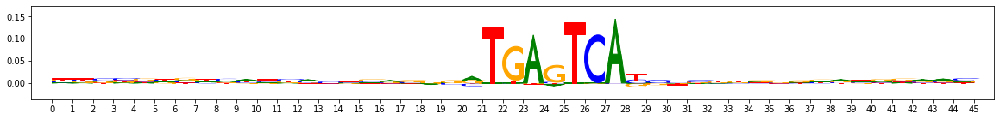

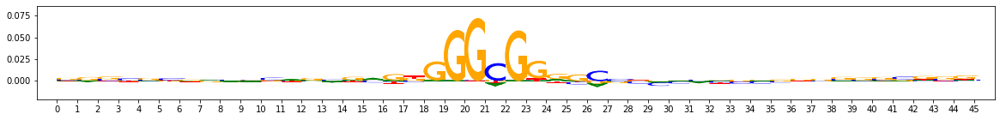

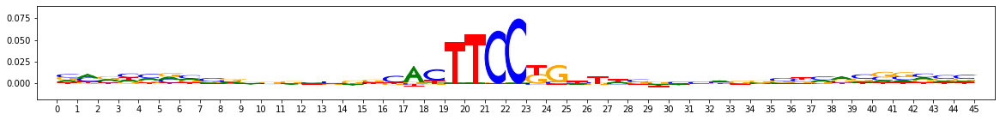

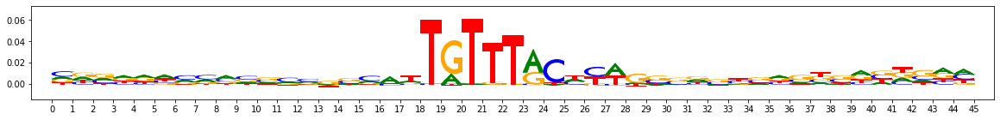

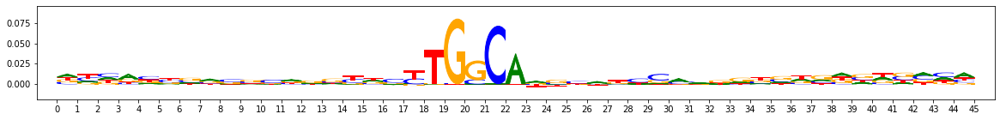

...

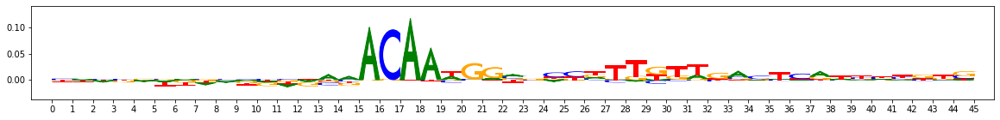

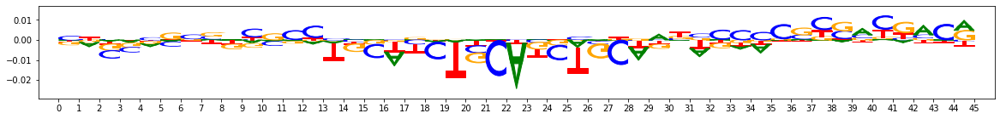

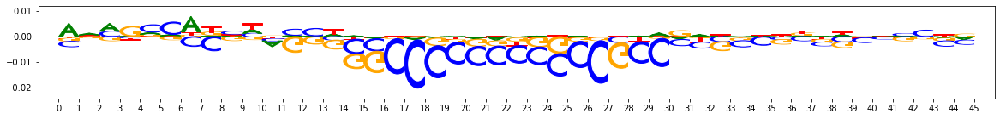

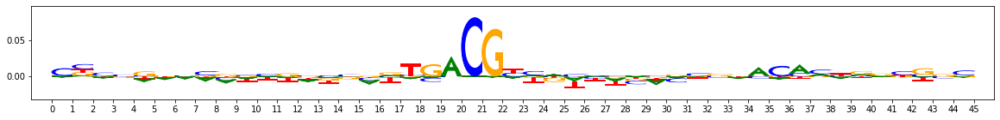

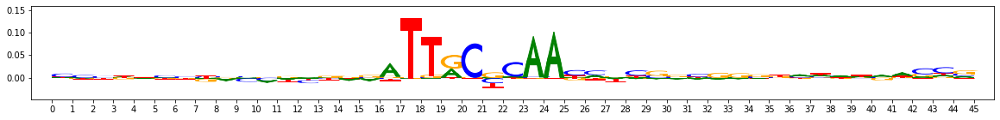

In [25]:
import time
from importlib import reload 
import modisco
reload(modisco)
import modisco.backend
reload(modisco.backend.tensorflow_backend)
reload(modisco.backend)
import modisco.nearest_neighbors
reload(modisco.nearest_neighbors)
import modisco.affinitymat
reload(modisco.affinitymat.core)
reload(modisco.affinitymat.transformers)
import modisco.tfmodisco_workflow.seqlets_to_patterns
reload(modisco.tfmodisco_workflow.seqlets_to_patterns)
import modisco.tfmodisco_workflow.workflow
reload(modisco.tfmodisco_workflow.workflow)
import modisco.aggregator
reload(modisco.aggregator)
import modisco.cluster
reload(modisco.cluster.core)
reload(modisco.cluster.phenograph.core)
reload(modisco.cluster.phenograph.cluster)
import modisco.value_provider
reload(modisco.value_provider)
import modisco.core
reload(modisco.core)
import modisco.coordproducers
reload(modisco.coordproducers)
import modisco.metaclusterers
reload(modisco.metaclusterers)
import modisco.visualization
from modisco.visualization import viz_sequence


start_time = time.time()


for class_index, task in enumerate(sorted(keys)):
    print("Running TF-MoDISco for task", task)
    
    pos_index = np.where(y_test[:, class_index] == 1)[0]
    onehot_data = x_test[pos_index]
    
    tfmodisco_results = modisco.tfmodisco_workflow.workflow.TfModiscoWorkflow(
                    #Slight modifications from the default settings
                    sliding_window_size=15,
                    flank_size=5,
                    target_seqlet_fdr=0.15,
                    seqlets_to_patterns_factory=
                     modisco.tfmodisco_workflow.seqlets_to_patterns.TfModiscoSeqletsToPatternsFactory(
                        trim_to_window_size=15,
                        initial_flank_to_add=5,
                        kmer_len=5, num_gaps=1,
                        num_mismatches=0,
                        final_min_cluster_size=30)
                )(
                task_names=[task],
                contrib_scores=task_to_scores,
                hypothetical_contribs=task_to_hyp_scores,
                one_hot=onehot_data)

    for metacluster_idx in [0,1]:
        print("Metacluster",metacluster_idx,"for task",task)
        patterns = (tfmodisco_results.metacluster_idx_to_submetacluster_results[metacluster_idx]
                    .seqlets_to_patterns_result.patterns)
        for pattern_idx,pattern in enumerate(patterns):
            print("Pattern idx", pattern_idx,"with",len(pattern.seqlets),"seqlets")
            fig = plt.figure(figsize=(20,2))
            ax = plt.subplot(111)
            viz_sequence.plot_weights_given_ax(ax=ax, 
                                               array=pattern[task+"_contrib_scores"].fwd,
                                               height_padding_factor=0.2,
                                               length_padding=1.0,
                                               subticks_frequency=1.0,
                                               highlight={},
                                               )   
            outfile = os.path.join(save_path, 'modisco_'+str(task)+'_'+ str(metacluster_idx)+'_'+str(pattern_idx)+'_'+str(len(pattern.seqlets))+'.pdf')
            fig.savefig(outfile, format='pdf', dpi=200, bbox_inches='tight')
    
    os.system("rm "+task+"_results.hdf5")
    tfmodisco_results.save_hdf5(h5py.File(task+"_results.hdf5"))
    del tfmodisco_results

end_time = time.time()
print("Took %f seconds!: "%(end_time-start_time))

#### Breaking down performance

In [7]:
from sklearn.metrics import roc_curve, auc, precision_recall_curve

def auroc(label, prediction):
    num_labels = label.shape[1]
    metric = np.zeros((num_labels))
    for i in range(num_labels):
        fpr, tpr, thresholds = roc_curve(label[:,i], prediction[:,i])
        score = auc(fpr, tpr)
        metric[i]= score
    return metric


def aupr(label, prediction):
    num_labels = label.shape[1]
    metric = np.zeros((num_labels))
    for i in range(num_labels):
        precision, recall, thresholds = precision_recall_curve(label[:,i], prediction[:,i])
        score = auc(recall, precision)
        metric[i] = score
    return metric


predictions = model.predict(x_test)
auroc_scores = auroc(y_test, predictions)
aupr_scores = aupr(y_test, predictions)

print("overall performance")
for experiment, auroc_score, aupr_score in zip(experiments, auroc_scores, aupr_scores):
    print("%s:\t%f\t%f"%(experiment, auroc_score, aupr_score))

overall performance
cagmyc_parous_foxa1:	0.883623	0.359011
cagmyc_parous_myc:	0.870197	0.370680
cagmyc_virgin_foxa1:	0.906175	0.663647
cagmyc_virgin_myc:	0.907816	0.594613
mec_parous_myc:	0.853800	0.318433
mec_virgin_myc:	0.859510	0.163294
cagmyc_parous_atac:	0.872351	0.702693
cagmyc_virgin_atac:	0.879841	0.808119
mec_parous_atac:	0.880073	0.877317
mec_virgin_atac:	0.908915	0.922563


In [65]:
predictions = model.predict(x_test)
pos_index = np.where(np.sum(y_test[:,6:], axis=1) == 4)[0]
neg_index = np.where(np.sum(y_test[:,6:], axis=1) == 0)[0]
index = np.concatenate([pos_index, neg_index])
auroc_scores = auroc(y_test[index,:], predictions[index,:])
aupr_scores = aupr(y_test[index,:], predictions[index,:])


print("performance when all sites are active")
for experiment, auroc_score, aupr_score in zip(experiments, auroc_scores, aupr_scores):
    print("%s:\t%f\t%f"%(experiment, auroc_score, aupr_score))

performance when all sites are active
cagmyc_parous_foxa1:	0.812829	0.380537
cagmyc_parous_myc:	0.788214	0.390505
cagmyc_virgin_foxa1:	0.850951	0.714102
cagmyc_virgin_myc:	0.900597	0.682176
mec_parous_myc:	0.771085	0.362378
mec_virgin_myc:	0.773599	0.160318
cagmyc_parous_atac:	0.974010	0.956616
cagmyc_virgin_atac:	0.972729	0.955523
mec_parous_atac:	0.983662	0.972858
mec_virgin_atac:	0.982718	0.971363


In [70]:
print("performance when only one site is active")
for class_index in range(num_labels):
    pos_index = np.where((y_test[:, class_index] == 1)& (np.sum(y_test[:,6:],axis=1)==1))[0]
    neg_index = np.where((y_test[:, class_index] == 0)& (np.sum(y_test[:,6:],axis=1)==3))[0]
    index = np.concatenate([pos_index, neg_index])
    auroc_scores = auroc(y_test[index,:], predictions[index,:])
    aupr_scores = aupr(y_test[index,:], predictions[index,:])
    print("%s:\t%f\t%f"%(experiments[class_index], auroc_scores[class_index], aupr_scores[class_index]))

    
for class_index in range(num_labels):
    pos_index = np.where((y_test[:, class_index] == 1)& (np.sum(y_test[:,6:],axis=1)==1))[0]
    neg_index = np.where((y_test[:, class_index] == 0)& (np.sum(y_test[:,6:],axis=1)==3))[0]
    print(len(pos_index),len(neg_index))
    

performance when only one site is active
cagmyc_parous_foxa1:	0.951329	0.384517
cagmyc_parous_myc:	0.915456	0.294489
cagmyc_virgin_foxa1:	0.934262	0.404047
cagmyc_virgin_myc:	0.892129	0.168920
mec_parous_myc:	0.902765	0.142865
mec_virgin_myc:	0.961253	0.328454
cagmyc_parous_atac:	0.407641	0.010829
cagmyc_virgin_atac:	0.787731	0.880765
mec_parous_atac:	0.345742	0.922821
mec_virgin_atac:	0.485044	0.993867
36 2562
57 2503
70 2523
36 2555
60 2520
23 2582
27 2059
1111 497
674 33
1757 9


#### Covariance matrices

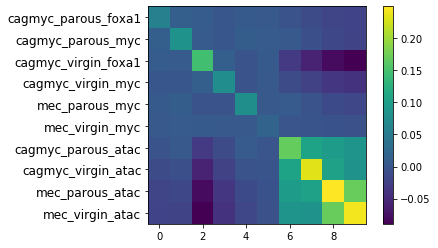

In [75]:
fig = plt.figure()
plt.imshow(np.cov(y_test.T))
plt.colorbar()
plt.yticks(range(0,10), experiments, fontsize=12)
outfile = os.path.join(save_path, 'covariance_all.pdf')
fig.savefig(outfile, format='pdf', dpi=200, bbox_inches='tight')

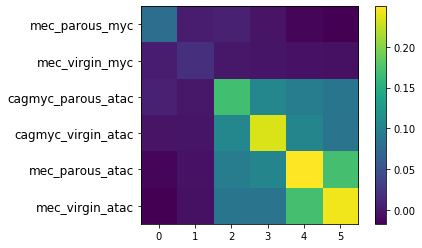

In [74]:
fig = plt.figure()
plt.imshow(np.cov(y_test[:,4:].T))
plt.colorbar()
plt.yticks(range(0,6), experiments[4:], fontsize=12)
outfile = os.path.join(save_path, 'covariance_atac.pdf')
fig.savefig(outfile, format='pdf', dpi=200, bbox_inches='tight')

#### Overlap of TFs to ATAC within same cell type 

In [46]:
# what percentage of myc overlap with corresponding atac peaks


experiments = [ 'cagmyc_parous_foxa1',# 0
                'cagmyc_parous_myc',  # 1
                'cagmyc_virgin_foxa1',# 2
                'cagmyc_virgin_myc',  # 3
                'mec_parous_myc',     # 4
                'mec_virgin_myc',     # 5
                'cagmyc_parous_atac', # 6
                'cagmyc_virgin_atac', # 7
                'mec_parous_atac',    # 8
                'mec_virgin_atac']    # 9

print('cagmyc parous foxa1')
index = np.where(y_test[:,0] == 1)[0]
index2 = np.where(y_test[:,6] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index))

print('cagmyc parous myc')
index = np.where(y_test[:,1] == 1)[0]
index2 = np.where(y_test[:,6] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index))

print('cagmyc virgin foxa1')
index = np.where(y_test[:,2] == 1)[0]
index2 = np.where(y_test[:,7] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index))

print('cagmyc virgin myc')
index = np.where(y_test[:,3] == 1)[0]
index2 = np.where(y_test[:,7] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index))


cagmyc parous foxa1
0.17932148626817448
cagmyc parous myc
0.27403846153846156
cagmyc virgin foxa1
0.05665163472378805
cagmyc virgin myc
0.1009557945041816


#### Overlap across cell types and different condition

In [58]:


experiments = [ 'cagmyc_parous_foxa1',# 0
                'cagmyc_parous_myc',  # 1
                'cagmyc_virgin_foxa1',# 2
                'cagmyc_virgin_myc',  # 3
                'mec_parous_myc',     # 4
                'mec_virgin_myc',     # 5
                'cagmyc_parous_atac', # 6
                'cagmyc_virgin_atac', # 7
                'mec_parous_atac',    # 8
                'mec_virgin_atac']    # 9

index = np.where(np.sum(y_test[:,6:], axis=1) == 4)[0]

print('cagmyc_parous_atac')
index2 = np.where(y_test[:,6] == 1)[0]                 
overlap = list(set(index2) & set(index))
print(len(overlap)/len(index2))

print('cagmyc_virgin_atac')
index2 = np.where(y_test[:,7] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index2))

print('mec_parous_atac')
index2 = np.where(y_test[:,8] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index2))

print('mec_virgin_atac')
index2 = np.where(y_test[:,9] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index2))


cagmyc parous
0.8515151515151516
cagmyc parous
0.4904672395273899
mec_parous_atac
0.35003832886163283
mec_virgin_atac
0.31543044642086177


#### Overlap within same cell type -- different condition

In [64]:

index = np.where(np.sum(y_test[:,6:8], axis=1) == 2)[0]

print('cagmyc_parous_atac')
index2 = np.where(y_test[:,6] == 1)[0]                 
overlap = list(set(index2) & set(index))
print(len(overlap)/len(index2))

print('cagmyc_virgin_atac')
index2 = np.where(y_test[:,7] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index2))

index = np.where(np.sum(y_test[:,8:], axis=1) == 2)[0]
print('mec_parous_atac')
index2 = np.where(y_test[:,8] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index2))

print('mec_virgin_atac')
index2 = np.where(y_test[:,9] == 1)[0]                 
overlap = list(set(index) & set(index2))
print(len(overlap)/len(index2))


cagmyc_parous_atac
0.8694638694638694
cagmyc_virgin_atac
0.5008055853920516
mec_parous_atac
0.9083940206975852
mec_virgin_atac
0.8185821604351956


In [ ]:
logomaker.Logo(counts_df, figsize=(30,1))
ax = plt.gca()
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('none')
ax.xaxis.set_ticks_position('none')
plt.xticks([])
plt.yticks([])
fig = plt.gcf()
outfile = os.path.join(save_path, 'name.pdf')
fig.savefig(outfile, format='pdf', dpi=200, bbox_inches='tight')